In [1]:
import time
import os
import math
import numpy as np
import cv2
import pandas as pd
import pyautogui as pa
from scipy.stats import binom_test
from matplotlib.markers import TICKDOWN
from matplotlib import rcParams
import datetime
from scipy.stats import norm, kstest, sem, ttest_ind
from numpy.polynomial import polynomial
import imageio

from lib.auto_GUI.auto_GUI_base import AutoGUIBase
from lib.auto_GUI.auto_PhotoZ import AutoPhotoZ
from lib.analysis.laminar_dist import *
from lib.file.ROI_reader import ROIFileReader
from lib.analysis.cell_roi import OverlapCounterROI
from lib.analysis.baseline_correction import BaselineCorrection

C:\Users\jjudge3\AppData\Roaming\Python\Python39\site-packages\matplotlib\projections\__init__.py:63: UserWarning: Unable to import Axes3D. This may be due to multiple versions of Matplotlib being installed (e.g. as a system package and as a pip package). As a result, the 3D projection is not available.
  warnings.warn("Unable to import Axes3D. This may be due to multiple versions of "


In [9]:
data_dir = "C:/Users/jjudge3/Desktop/Data/mm_full_pipeline_targets/PPR_GABAzine/"
catalog_csv = data_dir + 'ppr_catalog_backup.csv'
export_csv = data_dir + 'export_summary_backup.csv'

In [8]:
# load csv files
catalog_df = pd.read_csv(catalog_csv)
catalog_df = pd.DataFrame(catalog_df)
catalog_df

,zda_file,pulse1_start,pulse1_width,pulse2_start,pulse2_width,baseline_start,baseline_width,Notes,IPI
0,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,216,37,356.0,37.0,216,340,"ACSF, PPR",70
1,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,216,37,NaN,NaN,216,200,"ACSF, control",70
2,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,116,37,356.0,37.0,116,440,"ACSF, PPR",120
3,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,316,37,NaN,NaN,316,200,"ACSF, control",20
4,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,316,37,356.0,37.0,316,240,"ACSF, PPR",20
5,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,116,37,356.0,37.0,116,440,"Gabazine, PPR",120
6,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,316,37,356.0,37.0,316,240,"Gabazine, PPR",20
7,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,316,37,NaN,NaN,316,200,"Gabazine, Control",20
8,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,216,37,NaN,NaN,216,200,"ACSF, Control",70
9,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,216,37,356.0,37.0,216,340,"ACSF, PPR",70


In [10]:
export_df = pd.read_csv(export_csv)
export_df = pd.DataFrame(export_df)
export_df  # home barrels are ROI 1, neighbor barrels are ROI 2

,ROI,amp,snr,latency,halfwidth,Stim_Distance,ROI_Set,Date,Slice,Location,Recording,trace,trace_non_polyfit,amp_array
0,1,3.240620,82.56380,111.3310,7.02716,NaN,_pulse1,9/16/2024,2,1,1,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...
1,2,2.764110,68.33530,112.0980,8.34659,NaN,_pulse1,9/16/2024,2,1,1,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...
2,1,0.091519,2.33170,435.9430,13.82040,NaN,_pulse2,9/16/2024,2,1,1,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...
3,2,0.072115,1.78285,435.8300,13.92020,NaN,_pulse2,9/16/2024,2,1,1,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...
4,1,3.430300,154.39000,111.3560,7.36080,NaN,_pulse1,9/16/2024,2,1,2,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
85,2,0.955407,6.44764,434.9500,14.80010,NaN,_pulse2,9/20/2024,2,2,6,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...
86,1,7.449480,52.96870,162.9420,-325.80000,NaN,_pulse1,9/20/2024,2,2,8,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...
87,2,7.283500,55.21390,164.3210,-328.55700,NaN,_pulse1,9/20/2024,2,2,8,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...
88,1,6.819580,369.38800,62.9036,-125.68400,NaN,_pulse1,9/20/2024,2,2,9,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...


In [20]:
# first, look up metadata in catalog_df and append to export_df
def read_dat_trace_file(filename):
    data_arr = pd.read_csv(filename,
                                 sep='\t',
                                 header=0)  # change me to traces?
    data_arr = data_arr.apply(pd.to_numeric, errors='coerce')
    return data_arr

def format_date(date, input_format="%m/%d/%Y", format="%m-%d-%y"):
    date = datetime.datetime.strptime(date, input_format)
    return date.strftime(format)

def format_zda(slic, loc, rec):
    """ pad to ss_ll_rr """
    slic = str(slic).zfill(2)
    loc = str(loc).zfill(2)
    rec = str(rec).zfill(2)
    return slic + '_' + loc + '_' + rec

append_columns = {'ipi': [], 'drug' : [], 'num_pulses': [] }
for index, row in export_df.iterrows():
    date = row['Date']    
    slic = row['Slice']
    location = row['Location']
    recording = row['Recording']
    file_formatted_date = format_date(date)
    zda_id = format_zda(row['Slice'], row['Location'], row['Recording'])

    # look up zda file in catalog
    zda_row = catalog_df.loc[(catalog_df['zda_file'].str.contains(file_formatted_date)) &
                              (catalog_df['zda_file'].str.contains(zda_id))]

    append_columns['ipi'].append(zda_row['IPI'].values[0])
    drug, num_pulses = zda_row['Notes'].values[0].split(',')
    append_columns['drug'].append(drug)
    append_columns['num_pulses'].append(num_pulses)

# append columns to export_df
for key, value in append_columns.items():
    export_df[key] = value
export_df

,ROI,amp,snr,latency,halfwidth,Stim_Distance,ROI_Set,Date,Slice,Location,Recording,trace,trace_non_polyfit,amp_array,ipi,drug,num_pulses
0,1,3.240620,82.56380,111.3310,7.02716,NaN,_pulse1,9/16/2024,2,1,1,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,70,ACSF,PPR
1,2,2.764110,68.33530,112.0980,8.34659,NaN,_pulse1,9/16/2024,2,1,1,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,70,ACSF,PPR
2,1,0.091519,2.33170,435.9430,13.82040,NaN,_pulse2,9/16/2024,2,1,1,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,70,ACSF,PPR
3,2,0.072115,1.78285,435.8300,13.92020,NaN,_pulse2,9/16/2024,2,1,1,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,70,ACSF,PPR
4,1,3.430300,154.39000,111.3560,7.36080,NaN,_pulse1,9/16/2024,2,1,2,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,70,ACSF,control
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
85,2,0.955407,6.44764,434.9500,14.80010,NaN,_pulse2,9/20/2024,2,2,6,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,20,Gabazine,PPR
86,1,7.449480,52.96870,162.9420,-325.80000,NaN,_pulse1,9/20/2024,2,2,8,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,20,Gabazine,Control
87,2,7.283500,55.21390,164.3210,-328.55700,NaN,_pulse1,9/20/2024,2,2,8,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,20,Gabazine,Control
88,1,6.819580,369.38800,62.9036,-125.68400,NaN,_pulse1,9/20/2024,2,2,9,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,120,Gabazine,Control


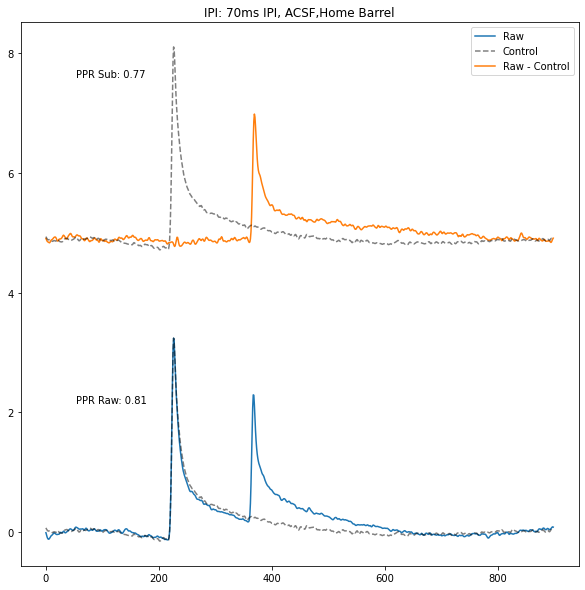

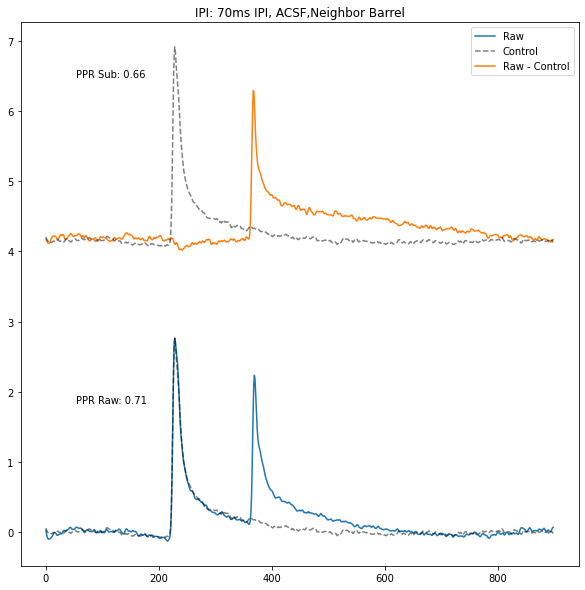

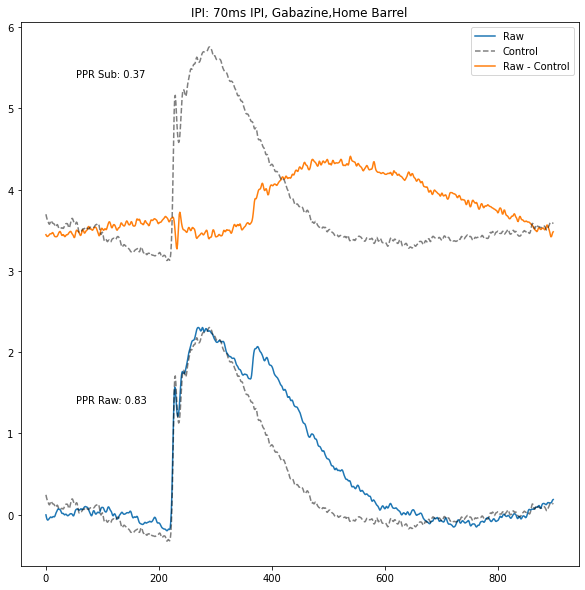

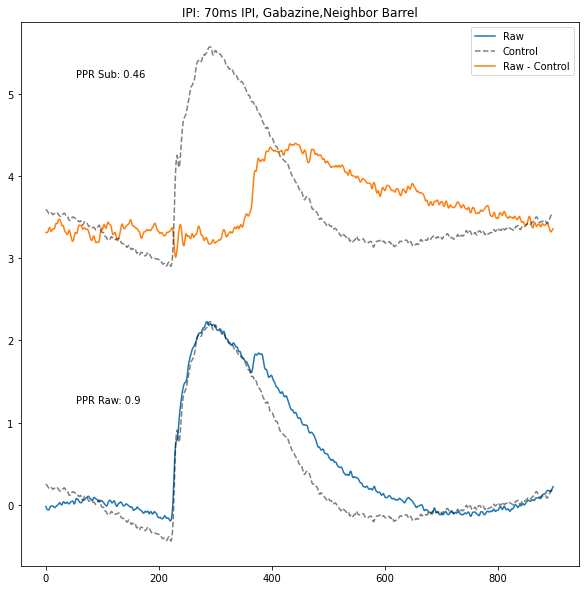

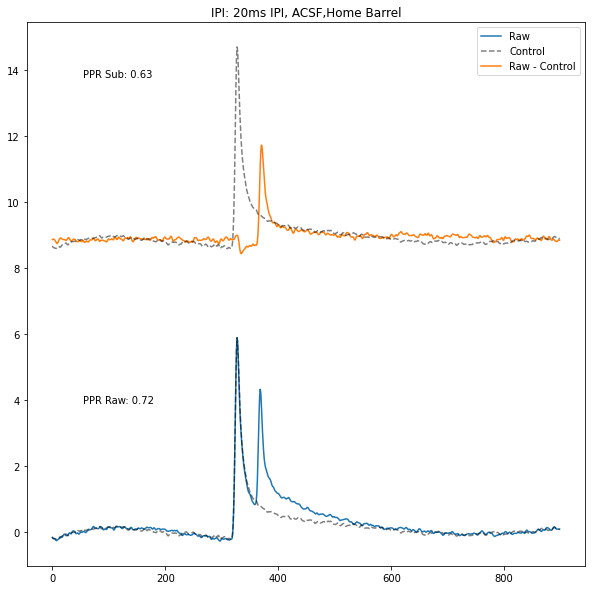

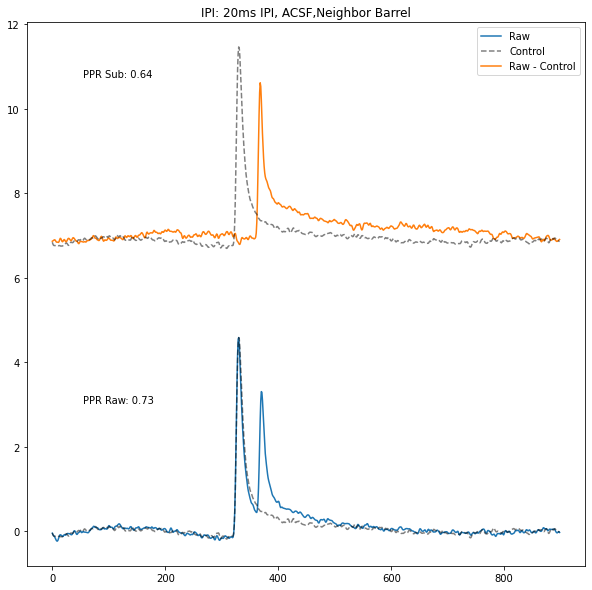

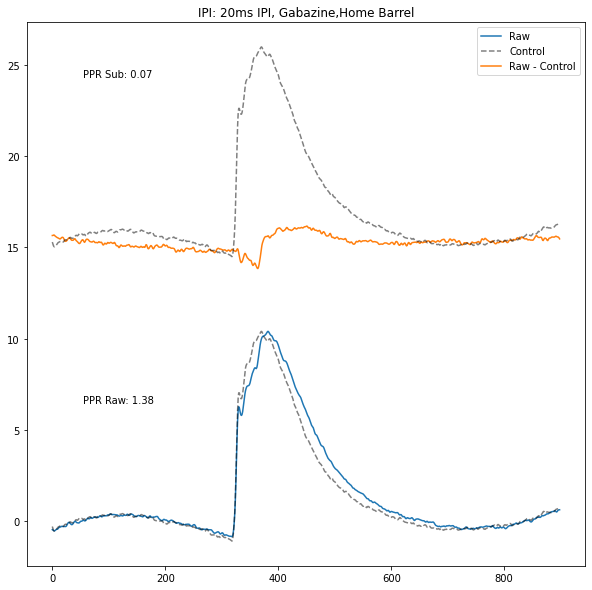

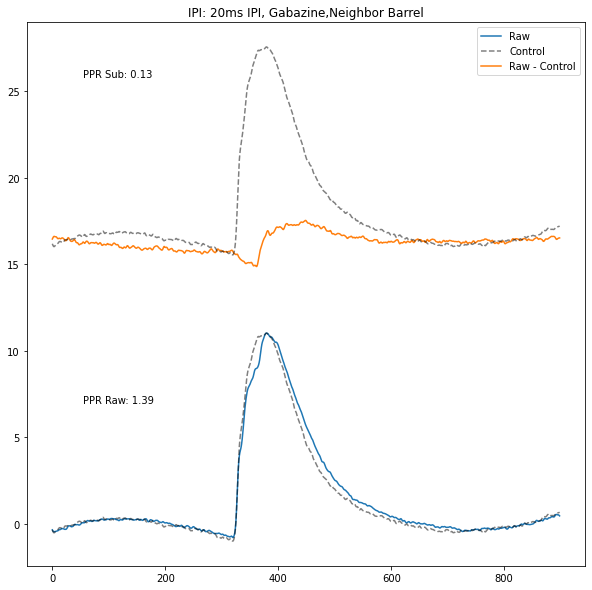

In [54]:
# for each ROI, load traces and perform summation decomposition by 
# subtracting the control trace from the paired-pulse trace.
# display the traces and the maxAmp arrays for each pulse
ppr = {}

for ipi in export_df['ipi'].unique():
    ipi_df = export_df[export_df['ipi'] == ipi]
    for drug in ipi_df['drug'].unique():
        drug_df = ipi_df[ipi_df['drug'] == drug]
        for roi in drug_df['ROI'].unique():
            roi_df = drug_df[drug_df['ROI'] == roi]
            
            ppr_row = roi_df[roi_df['num_pulses'].str.contains('PPR')]
            control_row = roi_df[roi_df['num_pulses'].str.contains('ontrol')]

            # load traces
            if ppr_row.empty or control_row.empty:
                continue
            ppr_trace = read_dat_trace_file(ppr_row['trace'].values[0])
            ppr_trace_non_polyfit = read_dat_trace_file(ppr_row['trace_non_polyfit'].values[0])
            control_trace = read_dat_trace_file(control_row['trace'].values[0])
            control_trace_non_polyfit = read_dat_trace_file(control_row['trace_non_polyfit'].values[0])

            # normalize the control traces to the max amp of the ppr traces
            control_trace_non_polyfit = control_trace_non_polyfit * (ppr_trace_non_polyfit.max() / control_trace_non_polyfit.max())
            control_trace = control_trace * (ppr_trace.max() / control_trace.max())

            trace_sub = ppr_trace_non_polyfit[roi_idx] - control_trace_non_polyfit[roi_idx]

            # calculate dist from zero of subtracted trace before second stim
            trace_sub_dist = trace_sub[(trace_sub.index < 356) | (trace_sub.index > 550)].abs().mean()
            if trace_sub_dist > 1:
                print('Warning: trace_sub_dist is greater than 1: ' + str(trace_sub_dist))
                continue

            # calculate maxAmp of subtracted trace in measure window (356 - 450)
            trace_sub_max = trace_sub[(trace_sub.index > 356) & (trace_sub.index < 450)].max()

            # calculate first and second maxAmp of raw trace in measure windows
            second_pulse_measure_window = [356, 450]
            first_pulse_measure_window = [116, 350]

            pulse1_raw_maxamp = ppr_trace[(ppr_trace.index > first_pulse_measure_window[0]) & 
                                          (ppr_trace.index < first_pulse_measure_window[1])][roi_idx].max()
            pulse2_raw_maxamp = ppr_trace[(ppr_trace.index > second_pulse_measure_window[0]) &
                                          (ppr_trace.index < second_pulse_measure_window[1])][roi_idx].max()

            ppr_raw = pulse2_raw_maxamp / pulse1_raw_maxamp
            ppr_sub = trace_sub_max / pulse1_raw_maxamp

            # show both traces and their subtraction (PPR - Control)
            fig, ax = plt.subplots(1, 1, figsize=(10, 10))
            roi_idx = 'ROI' + str(roi)
            ax.plot(ppr_trace['Pt'], ppr_trace[roi_idx], label='Raw')
            ax.plot(control_trace['Pt'], control_trace[roi_idx], 'k--', label='Control', alpha=0.5)
            ax.plot(ppr_trace['Pt'], 
                        trace_sub + np.max(control_trace[roi_idx]) * 1.5, 
                        label='Raw - Control')
            ax.plot(ppr_trace['Pt'], 
                        control_trace[roi_idx] + np.max(control_trace[roi_idx]) * 1.5, 'k--', 
                        alpha=0.5)
            ax.legend()
            # annotate with ppr_raw, ppr_sub, and trace_sub_dist
            ax.text(0.1, 0.3, 'PPR Raw: ' + str(round(ppr_raw,2)), transform=ax.transAxes)
            ax.text(0.1, 0.9, 'PPR Sub: ' + str(round(ppr_sub,2)), transform=ax.transAxes)
            ax.set_title('IPI: ' + str(ipi) + 'ms IPI, ' + drug + ',' + ("Home" if roi == 1 else "Neighbor") + " Barrel")
            #ax.text(0.1, 0.7, 'Trace Sub Dist: ' + str(trace_sub_dist)[:6], transform=ax.transAxes)
            plt.show()

            if ipi not in ppr:
                ppr[ipi] = {}
            if drug not in ppr[ipi]:
                ppr[ipi][drug] = {}
            if roi not in ppr[ipi][drug]:
                ppr[ipi][drug][roi] = {}
            ppr[ipi][drug][roi]['ppr_raw'] = ppr_raw
            ppr[ipi][drug][roi]['ppr_sub'] = ppr_sub

[14.721534432296664, 11.857249693956533, 39.539347287956076, 26.6357272876229, 12.705252820685388, 12.846145375147273]
ACSF ROI1 19.717542816277472 4.56032831570596
[16.188342100129944, 13.484685449883557, 29.689147619567365, 18.569399587290775, 69.16185830196233, 63.278912209406826]
ACSF ROI2 35.062057544706796 10.13519173904902
[116.07476578470363, 139.46701978328423, 156.36427946904092, 145.74493356513392, 145.8294619317751, 140.85022051866162, 153.46639123543656]
Gabazine ROI1 142.54243889829084 4.98640062418892
[107.97207937532289, 140.8982244518159, 162.94333979925534, 162.703831572659, 145.6575361525644, 139.69752430695831, 132.92101925959338]
Gabazine ROI2 141.82765070259558 7.116855146630082


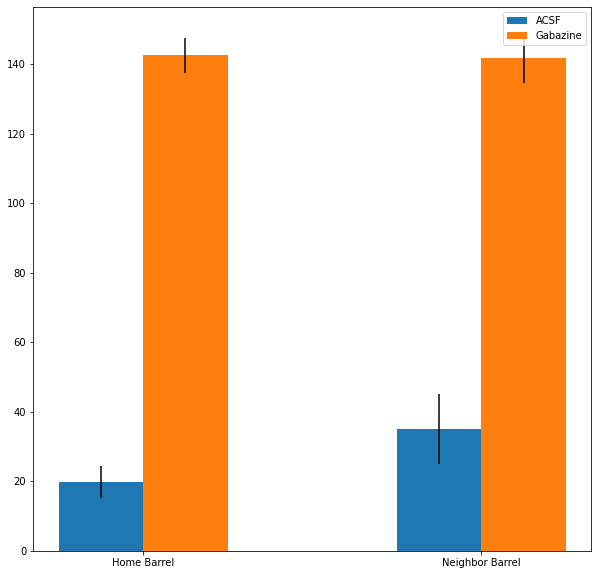

In [101]:
# compare control halfwidth ACSF versus GABAzine
# average over IPIs but compare Home versus Neighbor barrels and ACSF versus GABAzine

fig, ax = plt.subplots(1, 1, figsize=(10, 10))
handles = []
for drug in export_df['drug'].unique():
    drug_df = export_df[export_df['drug'] == drug]
    roi_df = drug_df[drug_df['ROI'] == 1]

    control_df = roi_df[roi_df['num_pulses'].str.contains('ontrol')]
    for roi in ['ROI1', 'ROI2']:
    

        halfwidths = []
        for _, control_row in control_df.iterrows():
        
            # get the trace and calculate halfwidth
            control_trace = read_dat_trace_file(control_row['trace'])[roi]

            # calculate maxAmp and its Pt index
            max_amp = control_trace.max()
            max_amp_idx = control_trace.idxmax()

            # calculate halfwidth (time from rising halfamp to falling halfamp)
            half_width = [0, 0]
            for i in range(max_amp_idx, len(control_trace)):
                if control_trace[i] < max_amp / 2:
                    # interpolate to get the exact time
                    half_width[0] = i + (control_trace[i] - max_amp / 2) / (control_trace[i] - control_trace[i - 1])
                    break

            for i in range(max_amp_idx, 0, -1):
                if control_trace[i] < max_amp / 2:
                    # interpolate to get the exact time
                    half_width[1] = i + (control_trace[i] - max_amp / 2) / (control_trace[i] - control_trace[i + 1])
                    break

            halfwidth = half_width[0] - half_width[1]
            halfwidths.append(halfwidth)
        print(halfwidths)
        i_plot_loc = int(roi[-1])
        i_plot_loc += (0.125 if drug == 'Gabazine' else -0.125)
        l1 = ax.bar(i_plot_loc, np.mean(halfwidths), yerr=sem(halfwidths),
                    label=drug, color= "tab:orange" if drug == 'Gabazine' else "tab:blue",
                    width=0.25)
        print(drug, roi, np.mean(halfwidths), sem(halfwidths))
        handles.append(l1)
# set ticks
ax.set_xticks([1, 2])
ax.set_xticklabels(['Home Barrel', 'Neighbor Barrel'])
ax.legend(handles=[handles[0], handles[-1]], labels=['ACSF', 'Gabazine'])
plt.show()
        


c:\Users\jjudge3\AppData\Local\anaconda3\envs\TSM\lib\site-packages\numpy\core\_methods.py:262: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
c:\Users\jjudge3\AppData\Local\anaconda3\envs\TSM\lib\site-packages\numpy\core\_methods.py:222: RuntimeWarning: invalid value encountered in true_divide
  arrmean = um.true_divide(arrmean, div, out=arrmean, casting='unsafe',
c:\Users\jjudge3\AppData\Local\anaconda3\envs\TSM\lib\site-packages\numpy\core\_methods.py:254: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
c:\Users\jjudge3\AppData\Local\anaconda3\envs\TSM\lib\site-packages\numpy\core\_methods.py:262: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
c:\Users\jjudge3\AppData\Local\anaconda3\envs\TSM\lib\site-packages\numpy\core\_methods.py:222: RuntimeWarning: invalid value encountered in true_divide
  arrmean = um.tr

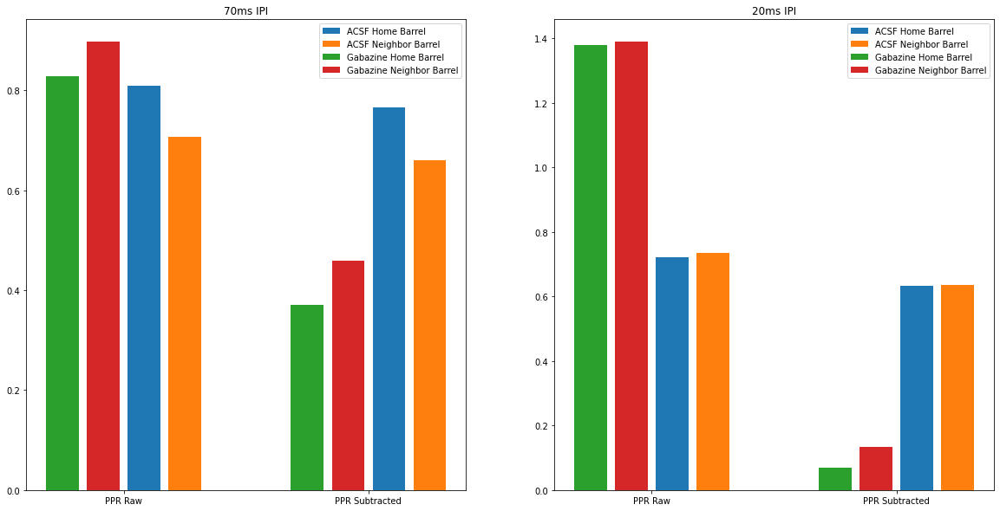

In [75]:
# plot ppr_raw and ppr_sub for each IPI on bar graphs
fig, ax = plt.subplots(1, 2, figsize=(20, 10))
i_plot = -1
base_spacing_sub_vs_raw = 3
for ipi in ppr.keys():
    i_plot += 1
    for drug in ppr[ipi].keys():
        i_drug_shift = -1 if drug == 'Gabazine' else 1
        ppr_raw = []
        ppr_sub = []
        for roi in ppr[ipi][drug].keys():
            ax[i_plot].bar([ipi - base_spacing_sub_vs_raw + roi + i_drug_shift, ipi + base_spacing_sub_vs_raw + roi + i_drug_shift], 
                [ppr[ipi][drug][roi]['ppr_raw'], ppr[ipi][drug][roi]['ppr_sub']], 
                yerr=[sem(ppr_raw), sem(ppr_sub)], 
                label=drug + ' ' + ("Home" if roi == 1 else "Neighbor") + " Barrel")
    ax[i_plot].legend()
    ax[i_plot].set_title(str(ipi) + 'ms IPI')

    # label the x-ticks with PPR Raw and PPR Subtracted
    ax[i_plot].set_xticks([ipi - base_spacing_sub_vs_raw + 1.5, ipi + base_spacing_sub_vs_raw + 1.5])
    ax[i_plot].set_xticklabels(['PPR Raw', 'PPR Subtracted'])
plt.show()

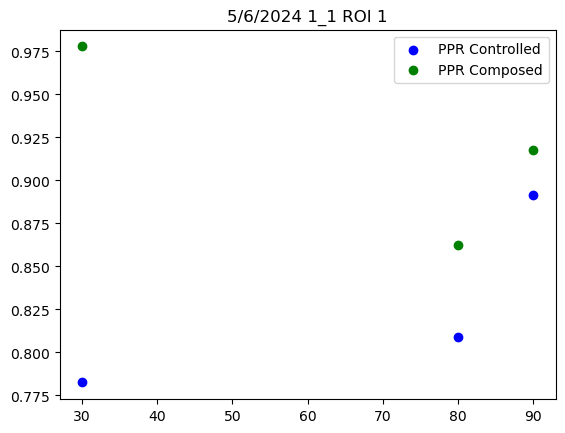

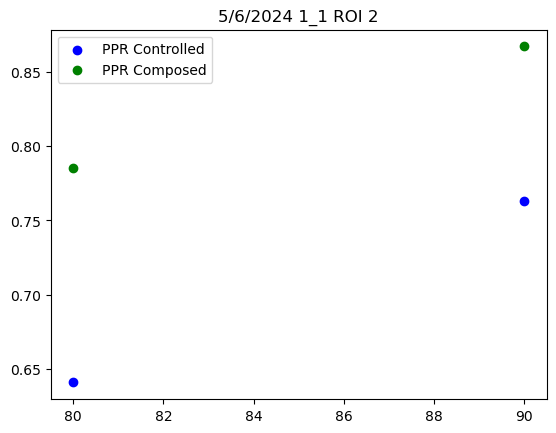

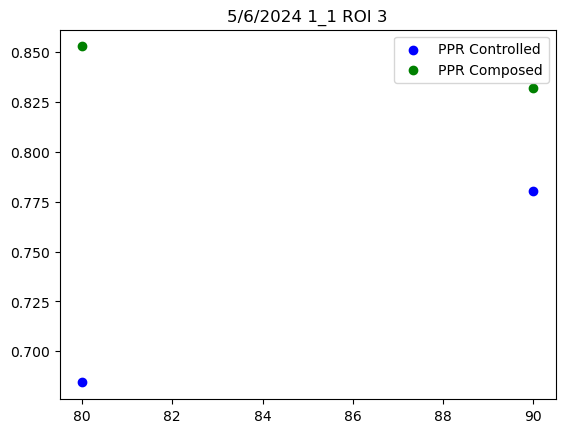

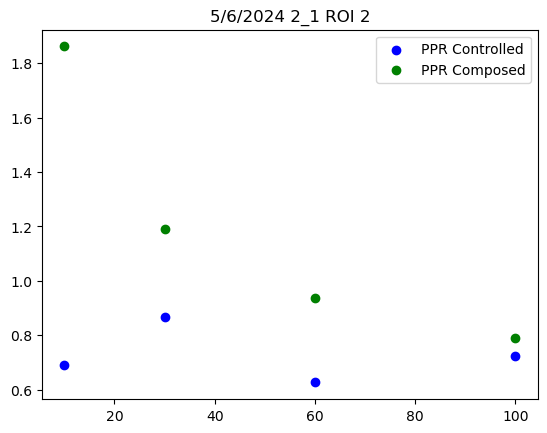

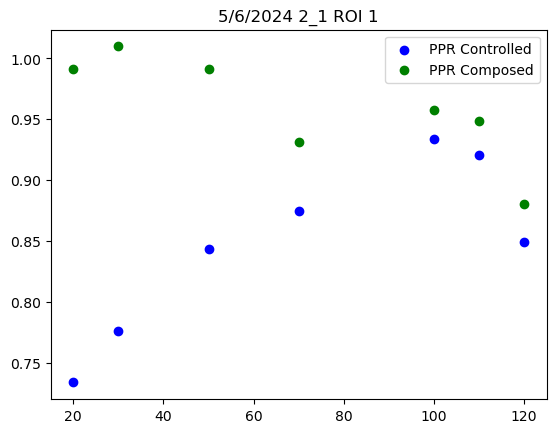

...

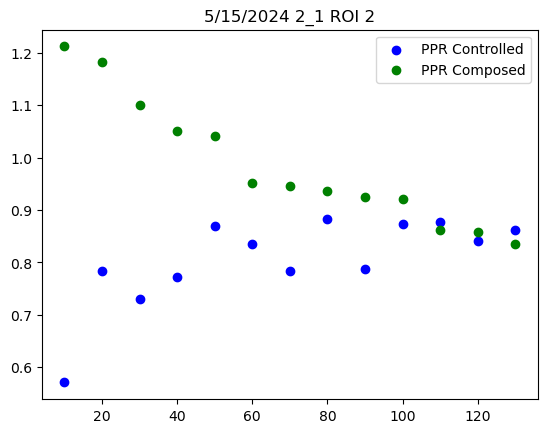

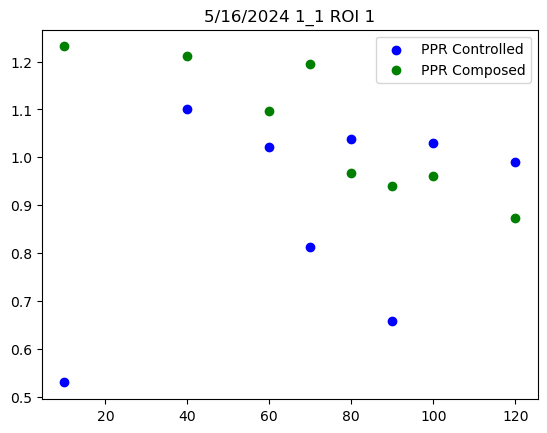

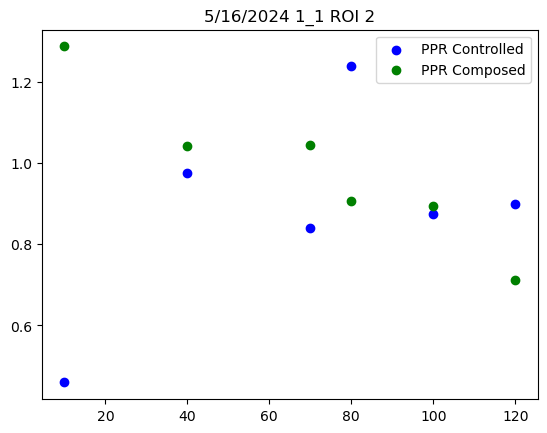

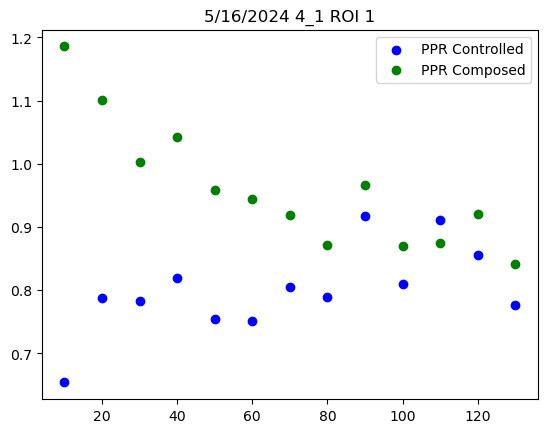

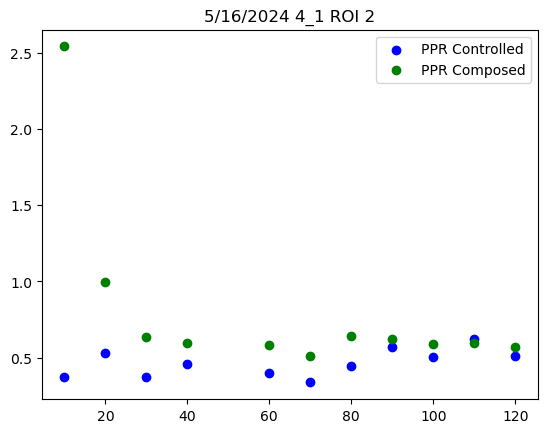

In [44]:
# for each date, slice/loc, and ROI, plot PPR vs IPI
plt.rcParams.update(plt.rcParamsDefault)
for date in df['Date'].unique():
    pfs_date = df[df["Date"] == date]
    for slic_loc in pfs_date['Slice_Loc'].unique():
        pfs_sl = pfs_date[pfs_date["Slice_Loc"] == slic_loc]
        for roi in pfs_sl['ROI'].unique():

            # plot PPR
            pfs_roi = pfs_sl[pfs_sl['ROI'] == roi]
            plt.scatter(pfs_roi['IPI'], pfs_roi['PPR'], label='PPR Controlled', c = 'b')
            plt.title(date + " " + slic_loc + " ROI " + str(roi))

            # plot PPR Composed
            plt.scatter(pfs_roi['IPI'], pfs_roi['PPR Composed'], label='PPR Composed', c='g')
            plt.legend()

            plt.show()
            '''plt.scatter(pfs_roi['IPI'], pfs_roi['PPL'], c='r')
            plt.title(date + " " + slic_loc + " ROI " + str(roi))
            plt.show()
            plt.scatter(pfs_roi['IPI'], pfs_roi['PPHW'], c='g')
            plt.title(date + " " + slic_loc + " ROI " + str(roi))
            plt.show()'''

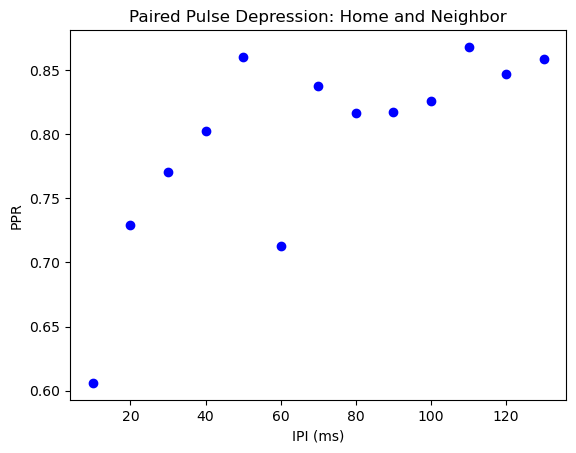

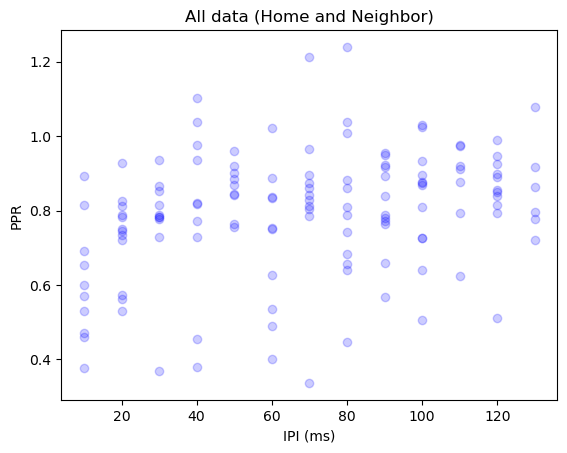

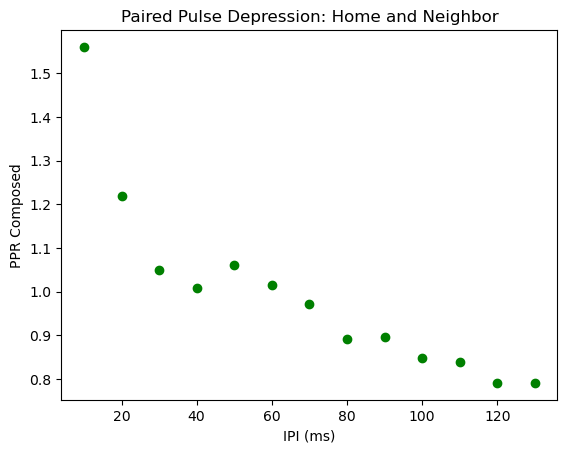

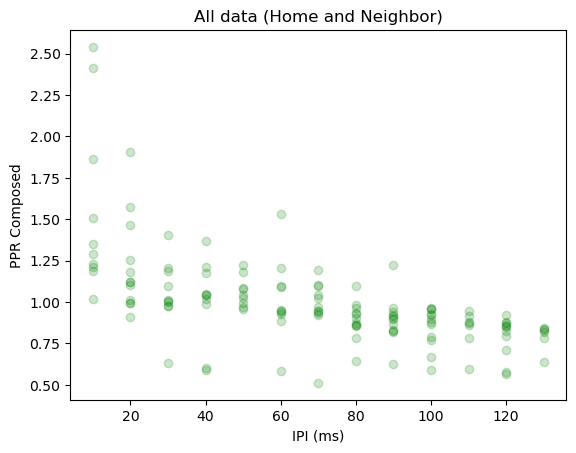

In [45]:
# average grouping by IPI
for pp_type, color in [['PPR', 'b'], ['PPR Composed', 'g']]: #, ['PPL', 'r'], ['PPHW', 'g']]:
    group_by_ipi = df[['IPI', pp_type]].groupby(by=['IPI']).mean()
    group_by_ipi_std = df[['IPI', pp_type]].groupby(by=['IPI']).agg(np.std)
    group_by_ipi.reset_index(inplace=True)
    
    

    # plot average PPR vs IPI
    plt.scatter(group_by_ipi['IPI'], group_by_ipi[pp_type], c=color)
    plt.title("Paired Pulse Depression: Home and Neighbor")
    plt.xlabel("IPI (ms)")
    plt.ylabel(pp_type)
    plt.show()
    plt.scatter(df['IPI'], df[pp_type], alpha=0.2, c=color)
    plt.xlabel("IPI (ms)")
    plt.ylabel(pp_type)
    plt.title("All data (Home and Neighbor)")
    plt.show()

     PPR
IPI     
10     7
20     7
30     8
40     6
50     6
60     7
70     7
80     8
90     9
100    7
110    4
120    6
130    4
i= 0
10
p_val for IPI 20 : 0.970413121532539
p_val for IPI 30 : 0.9832886378729021
p_val for IPI 40 : 0.9952573771380934
p_val for IPI 50 : 0.9895640301074398
p_val for IPI 60 : 0.9639269930566625
p_val for IPI 70 : 0.9928793269347761
p_val for IPI 80 : 0.9863182130887298
p_val for IPI 90 : 0.9927944372221966
p_val for IPI 100 : 0.9901196854072509
p_val for IPI 110 : 0.9991554682176128
p_val for IPI 120 : 0.9974817144924687
p_val for IPI 130 : 0.96678427540759
[None, None, None, None, None, None, None, None, None, None, None, None, None]
     PPR
IPI     
10     3
20     5
30     2
40     4
50     3
60     3
70     4
80     4
90     3
100    5
110    3
120    5
130    2
i= 1
110
p_val for IPI 10 : 0.0224153131954706
p_val for IPI 20 : 0.10777345716112412
p_val for IPI 30 : 0.24250523974321941
p_val for IPI 40 : 0.2072760905773358
p_val for IPI 50 : 0.85

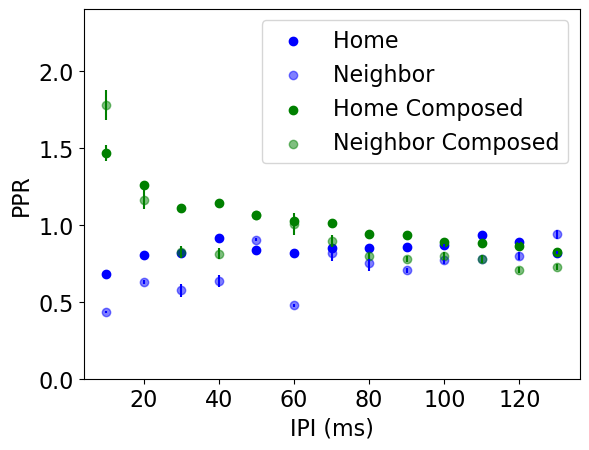

In [46]:
# home barrel or neighboring barrel
plt.rcParams.update({'font.size': 16})

home_barrel_df = df.query('`Home Barrel` == ROI')
neighbor_barrel_df = df.query('`Home Barrel` != ROI')
titles = ['Home Barrel', 'Neighbor Barrel']

for pp_type, color in [['PPR', 'b'], ['PPR Composed', 'g']]: #, ['PPL', 'r'], ['PPHW', 'g']]:
    i = 0
    for barrel_df in [home_barrel_df, neighbor_barrel_df]:
        
        if pp_type in ['PPL', 'PPHW']:
            barrel_df = barrel_df[barrel_df['IPI'] > 20]
        group_by_ipi = barrel_df[['IPI', pp_type]].groupby(by=['IPI']).mean()
        group_by_ipi_std = barrel_df[['IPI', pp_type]].groupby(by=['IPI']).agg(np.std) / np.sqrt(len(barrel_df))
        group_by_ipi.reset_index(inplace=True)

        count_by_ipi = barrel_df[['IPI', pp_type]].groupby(by=['IPI']).count()
        print(count_by_ipi)

        # significance tests against the first IPI
        first_ipi = np.min(group_by_ipi['IPI'])
        pvals = []
        print("i=", i)
        if pp_type == 'PPR' and titles[i] == 'Neighbor Barrel':
            first_ipi = 110
        print(first_ipi)
        
        first_ipi_data = barrel_df[barrel_df['IPI'] == first_ipi][pp_type]
        for ipi in group_by_ipi['IPI']:
            if ipi == first_ipi:
                pvals.append(1)
                continue
            ipi_data = barrel_df[barrel_df['IPI'] == ipi][pp_type]
            
            # one-sided t-test if ipi_data is less than first_ipi_data
            t_stat, p_val = ttest_ind(ipi_data, first_ipi_data, alternative='less', equal_var=False)
            print("p_val for IPI", ipi, ":", p_val)
            pvals.append(p_val)

        def get_sig_level(x):
            if x < 0.001:
                return '***'
            if x < 0.01:
                return '**'
            if x < 0.05:
                return '*'
        significance_levels = [get_sig_level(x) for x in pvals]
        print(significance_levels)
            
        alph = 1.0
        if titles[i] == 'Neighbor Barrel':
            alph = 0.5

        label = titles[i].split(" ")[0] + " "
        if len(pp_type.split(" ")) > 1:
            label += pp_type.split(" ")[1]
        plt.scatter(group_by_ipi['IPI'], group_by_ipi[pp_type], c=color, alpha=alph, label=label)
        plt.errorbar(group_by_ipi['IPI'], group_by_ipi[pp_type], 
                     group_by_ipi_std[pp_type], ls='none', c=color)
        y_label = pp_type
        if pp_type == 'PPL':
            y_label = "Paired-pulse ratio\n of Latency"
        if pp_type == 'PPHW':
            y_label = "Paired-pulse ratio\n of Half-width"
        # plt.title("Paired Pulse Depression in " + titles[i])
        
        # place significance levels on plot
        #for j, txt in enumerate(significance_levels):
        #    plt.annotate(txt, (group_by_ipi['IPI'].iloc[j], min(0.95, group_by_ipi[pp_type].iloc[j] + 0.25)), fontsize=12)

        plt.xlabel("IPI (ms)")
        #plt.xticks([])
        
        plt.ylim([0, 2.4])
        plt.ylabel(y_label)
        
        i += 1
plt.legend()
plt.ylabel("PPR")
plt.show()

In [47]:
# home barrel or neighboring barrel
plt.rcParams.update({'font.size': 16})

home_barrel_df = df.query('`Home Barrel` == ROI')
neighbor_barrel_df = df.query('`Home Barrel` != ROI')
pvals = []
# significance tests: home versus neighbor
for ipi in group_by_ipi['IPI']:
    
    # one-sided t-test if ipi_data is less than first_ipi_data
    t_stat, p_val = ttest_ind(neighbor_barrel_df[neighbor_barrel_df['IPI'] == ipi]["PPR"],
                              home_barrel_df[home_barrel_df['IPI'] == ipi]["PPR"],  
                                alternative='less', 
                                equal_var=False)
    print("p_val for IPI", ipi, ":", p_val)
    pvals.append(p_val)

def get_sig_level(x):
    if x < 0.001:
        return '***'
    if x < 0.01:
        return '**'
    if x < 0.05:
        return '*'
significance_levels = [get_sig_level(x) for x in pvals]
print(significance_levels)

p_val for IPI 10 : 0.0015510520244377357
p_val for IPI 20 : 0.007545862301815003
p_val for IPI 30 : 0.21839428064328484
p_val for IPI 40 : 0.06544119290578133
p_val for IPI 50 : 0.8942021512717975
p_val for IPI 60 : 0.00041879963240638694
p_val for IPI 70 : 0.4315536084487397
p_val for IPI 80 : 0.31007251885470655
p_val for IPI 90 : 0.0696926916431726
p_val for IPI 100 : 0.17955185669537727
p_val for IPI 110 : 0.10254482442909542
p_val for IPI 120 : 0.144065681205382
p_val for IPI 130 : 0.7255047379679819
['**', '**', None, None, None, '***', None, None, None, None, None, None, None]


In [56]:
# autoPhotoZ to save amplitude arrays for each measure window and 
# baseline correction to create PPR maps
def get_amp_array_filename(subdir, slic_loc_id, ipi, pulse):
    return subdir + "/" + "ampArray_" + slic_loc_id + "_ipi" + str(ipi) + "_p" + str(pulse) + ".dat"

overwrite_amp_arrays = False
select_amp_bkg = False
for subdir in data_map:
    aPhz = AutoPhotoZ(data_dir=subdir)
    if not select_amp_bkg and enable_photoZ_interact:
        aPhz.select_MaxAmp_array()
    print(subdir)
    for slic_id in data_map[subdir]:

        for loc_id in data_map[subdir][slic_id]:
            if type(loc_id) == str:
                continue
            slic_loc_id = str(slic_id) + "_" + str(loc_id)

            ipi_file = data_map[subdir][slic_id][loc_id]['shuffle_file']
            with open(ipi_file, 'r') as f:
                lines = f.readlines() 
            ipi_order = [x for x in lines]
            for k in range(len(ipi_order)):
                ipi = ipi_order[k].split("\t")
                ipi = int(ipi[1]) - int(ipi[0])
                ipi_order[k] = ipi

            # open zda files in order
            i_ipi = -1
            for zda_file in data_map[subdir][slic_id][loc_id]['zda_files']:

                i_ipi += 1
                try:
                    ipi = ipi_order[i_ipi]
                except Exception as e:
                    print(e)
                    print("Not enough IPIs for how many recordings we have! Last IPI:", ipi, "Check", subdir)
                print(slic_id, loc_id, "IPI:", ipi, "ms for recording", zda_file.split("/")[-1])
                
                # check if all amp arrays are already saved for this recording/IPI
                all_saved = True
                for i_pulse in [1, 2]:
                    amp_array_filename = get_amp_array_filename(subdir, slic_loc_id, ipi, i_pulse)
                    if not os.path.exists(amp_array_filename):
                        print("Missing", amp_array_filename)
                        all_saved = False
                        break
                if overwrite_amp_arrays:
                    all_saved = False

                if enable_photoZ_interact and not all_saved:
                    aPhz.open_zda_file(zda_file)

                    # set polynomial skip window to eclipse BOTH pulses
                    end_skip = 550
                    first_pulse_start = 356 - (ipi * 2)
                    skip_width = end_skip - first_pulse_start
                    aPhz.set_polynomial_skip_window(first_pulse_start,
                                                            skip_width=skip_width)
                for i_pulse in [1, 2]:
                    amp_array_filename = get_amp_array_filename(subdir, slic_loc_id, ipi, i_pulse)
                    if not os.path.exists(amp_array_filename) or overwrite_amp_arrays:
                        if enable_photoZ_interact and not all_saved:
                            #measure_window_start = 96 + (i_pulse - 1) * ipi * 2
                            measure_window_start = 356
                            if i_pulse == 1:
                                measure_window_start -= ipi * 2
                            aPhz.set_measure_window(measure_window_start, None)


                        # take Amplitude array from PhotoZ
                        if enable_photoZ_interact and not all_saved:
                            aPhz.save_background(filename=amp_array_filename)
                    else:
                        if not all_saved:
                            time.sleep(5)

                    if ipi not in data_map[subdir][slic_id][loc_id]:
                        data_map[subdir][slic_id][loc_id][ipi] = {}
                    if i_pulse not in data_map[subdir][slic_id][loc_id][ipi]:
                        data_map[subdir][slic_id][loc_id][ipi][i_pulse] = {}
                    data_map[subdir][slic_id][loc_id][ipi][i_pulse]['amp_array'] = amp_array_filename
                    
            if i_ipi < len(ipi_order) - 1:
                print("Not enough recordings for how many IPIs we have! Last IPI:", ipi, "Check", subdir)
                        

C:/Users/jjudge3/Desktop/Data/mm_full_pipeline_targets/controlled_baseline/05-06-24
1 1 IPI: 80 ms for recording 01_01_02.zda
1 1 IPI: 10 ms for recording 01_01_03.zda
Missing C:/Users/jjudge3/Desktop/Data/mm_full_pipeline_targets/controlled_baseline/05-06-24/ampArray_1_1_ipi10_p2.dat
1 1 IPI: 30 ms for recording 01_01_04.zda
Missing C:/Users/jjudge3/Desktop/Data/mm_full_pipeline_targets/controlled_baseline/05-06-24/ampArray_1_1_ipi30_p1.dat
1 1 IPI: 90 ms for recording 01_01_05.zda
Missing C:/Users/jjudge3/Desktop/Data/mm_full_pipeline_targets/controlled_baseline/05-06-24/ampArray_1_1_ipi90_p1.dat
1 1 IPI: 120 ms for recording 01_01_06.zda
Missing C:/Users/jjudge3/Desktop/Data/mm_full_pipeline_targets/controlled_baseline/05-06-24/ampArray_1_1_ipi120_p1.dat
1 1 IPI: 100 ms for recording 01_01_07.zda
Missing C:/Users/jjudge3/Desktop/Data/mm_full_pipeline_targets/controlled_baseline/05-06-24/ampArray_1_1_ipi100_p1.dat
1 1 IPI: 70 ms for recording 01_01_08.zda
Missing C:/Users/jjudge3/Des

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1
<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


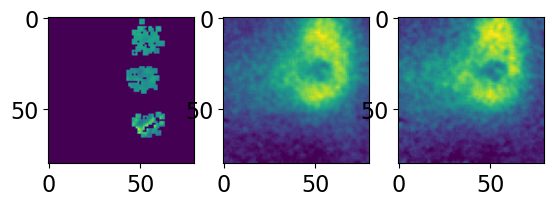

[208, 193, 160]
          params     sigma
mu1     0.765780  0.695013
sigma1  0.180571  0.661297
A1      0.262676  0.586720
mu2     0.867679  0.004452
sigma2  0.047279  0.006256
A2      5.997597  0.743265
          params     sigma
mu1     0.798485  0.013662
sigma1  0.069530  0.016300
A1      2.949902  1.525235
mu2     0.781063  0.006221
sigma2  0.027977  0.009986
A2      3.328671  1.483476
          params     sigma
mu1     0.723588  0.007500
sigma1  0.017355  0.008014
A1      2.110337  0.807706
mu2     0.873525  0.023587
sigma2  0.221722  0.023518
A2      2.886472  0.239303


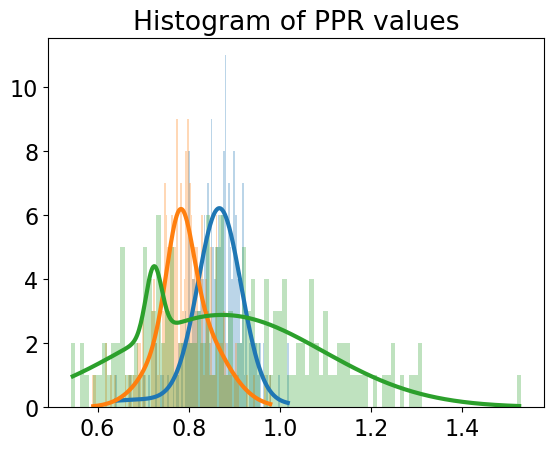

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1
<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


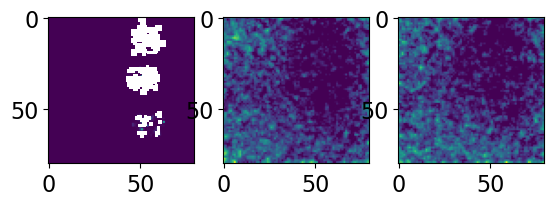

[19, 39, 61]
              params          sigma
mu1     7.000000e-01  136015.931490
sigma1  2.000000e-02  136749.916603
A1     -1.672236e-15       0.889284
mu2     8.000000e-01  241351.139591
sigma2  2.000000e-02  242653.547540
A2     -1.077663e-16       0.889284
           params       sigma
mu1      0.704881   13.023303
sigma1  -0.004230    2.864980
A1       1.001763  184.194176
mu2      0.992147    0.121245
sigma2  -0.005502    0.071627
A2      30.632816  963.467999
          params     sigma
mu1     0.834202  0.069662
sigma1  0.352101  0.092430
A1      1.700470  0.659556
mu2     0.780959  0.032784
sigma2  0.092436  0.045585
A2     -1.771932  0.748090


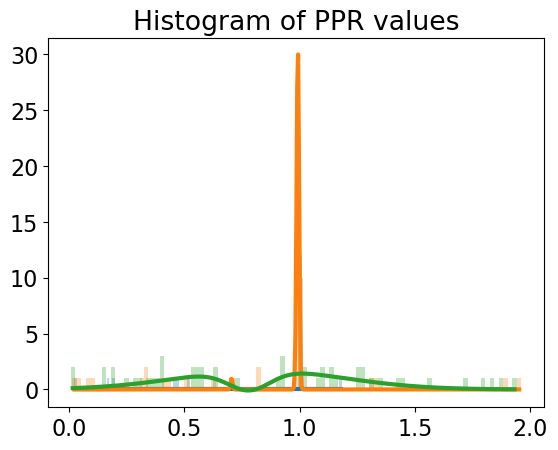

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


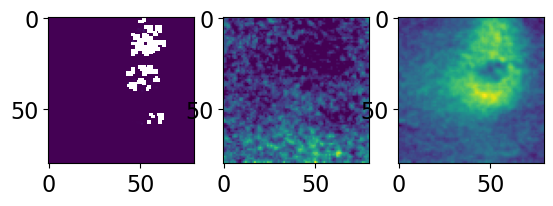

[0, 0, 0]


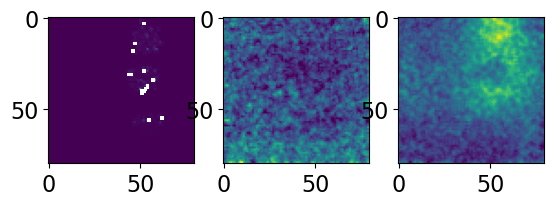

[0, 0, 34]
              params  sigma
mu1     2.909388e+04    inf
sigma1 -1.127205e+03    inf
A1     -4.890881e+07    inf
mu2     1.671074e+00    inf
sigma2  4.747669e-01    inf
A2      4.752726e-01    inf


c:\Users\jjudge3\AppData\Local\anaconda3\envs\TSM-to-ZDA\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


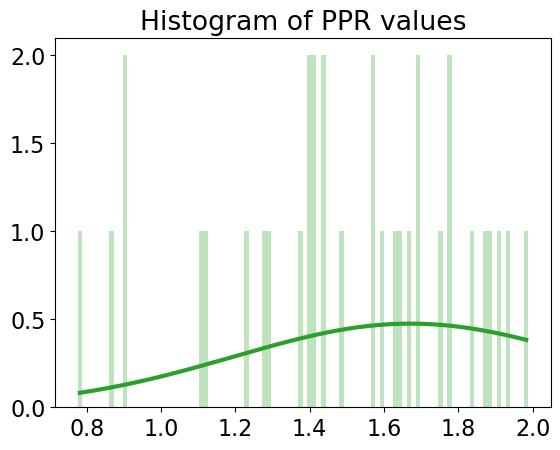

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1
<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


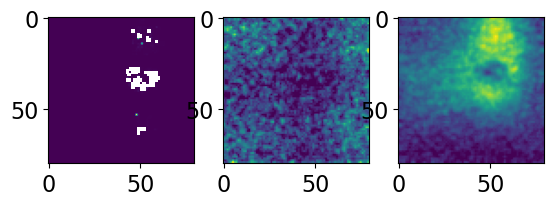

[0, 0, 13]
        params  sigma
mu1       0.70    inf
sigma1    0.02    inf
A1       25.00    inf
mu2       0.80    inf
sigma2    0.02    inf
A2       15.00    inf


c:\Users\jjudge3\AppData\Local\anaconda3\envs\TSM-to-ZDA\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


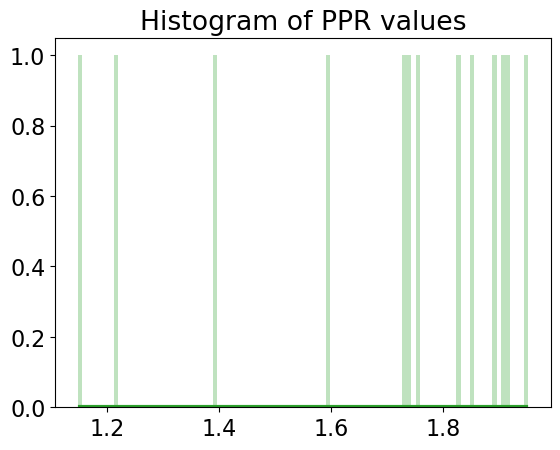

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1
<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


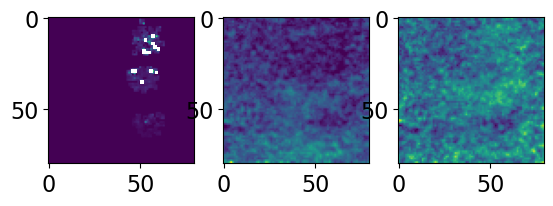

[59, 96, 145]
              params         sigma
mu1     1.610635e+04  7.734578e+59
sigma1 -9.727145e+02  4.075551e+58
A1     -2.067384e+07           NaN
mu2     8.022782e-01  7.616187e+04
sigma2  4.918193e-03  1.198440e+04
A2      7.289234e+00  1.520992e+08


<ipython-input-84-e21b85474538>:129: RuntimeWarning: invalid value encountered in sqrt
  sigma=np.sqrt(np.diag(cov))
c:\Users\jjudge3\AppData\Local\anaconda3\envs\TSM-to-ZDA\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


        params  sigma
mu1       0.70    inf
sigma1    0.02    inf
A1       25.00    inf
mu2       0.80    inf
sigma2    0.02    inf
A2       15.00    inf
          params     sigma
mu1     0.807607  0.025165
sigma1  0.289645  0.026927
A1      3.744353  0.337496
mu2     0.820774  0.007230
sigma2  0.020218  0.007714
A2     -3.438770  1.090967


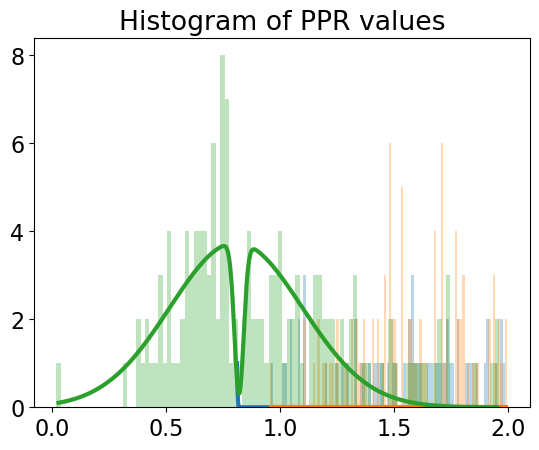

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


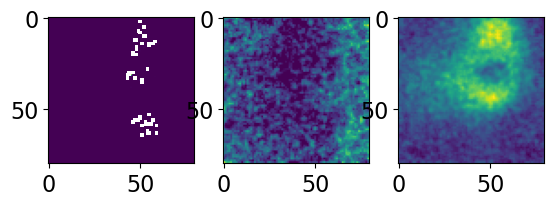

[0, 0, 4]


<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


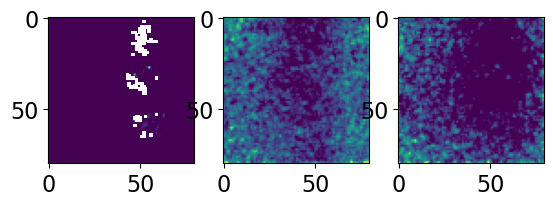

[1, 19, 55]
          params          sigma
mu1     0.687705    2234.682606
sigma1  0.002656     485.309313
A1      1.078410  386083.622862
mu2     0.866007       3.761063
sigma2  0.003348       1.021949
A2      1.030921     307.426398
              params  sigma
mu1     7.220216e-01    inf
sigma1 -1.429544e-05    inf
A1     -4.311498e-11    inf
mu2     8.827923e-01    inf
sigma2  3.985189e-03    inf
A2      1.528432e+01    inf


c:\Users\jjudge3\AppData\Local\anaconda3\envs\TSM-to-ZDA\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


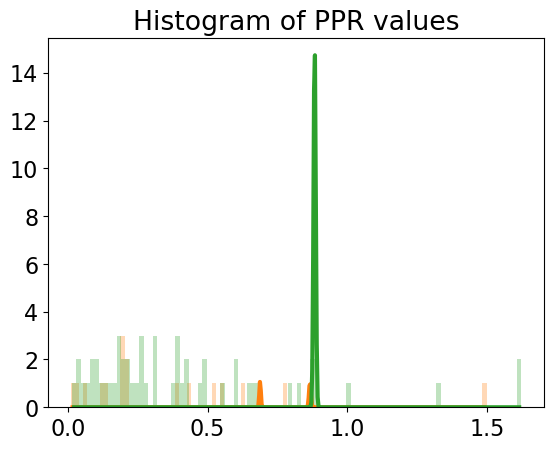

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1
<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


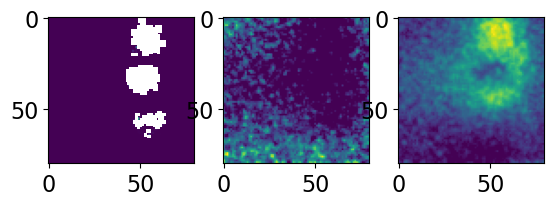

[0, 0, 15]
          params         sigma
mu1     0.731211  1.424284e+00
sigma1  0.003425  3.425618e-01
A1      2.010005  8.518297e+01
mu2     0.809292           NaN
sigma2  0.000480  9.450781e+04
A2      1.134962  6.839301e+07


<ipython-input-84-e21b85474538>:129: RuntimeWarning: invalid value encountered in sqrt
  sigma=np.sqrt(np.diag(cov))


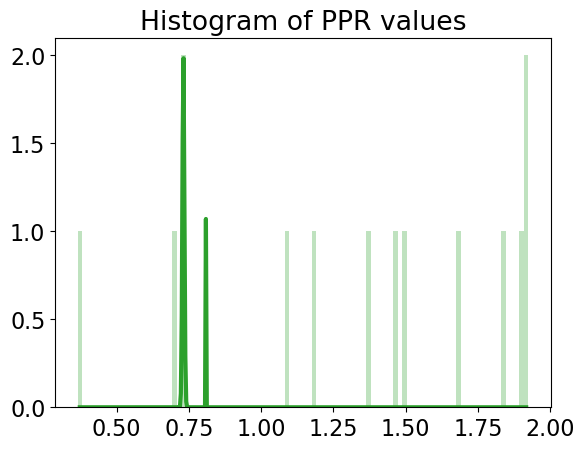

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1
<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


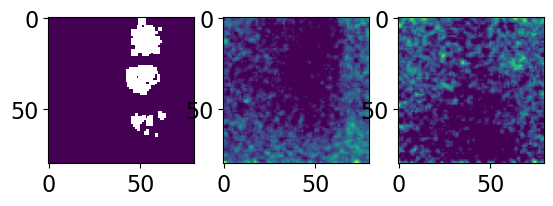

[9, 20, 50]
           params          sigma
mu1      0.494314       8.472092
sigma1   0.186949      11.225669
A1      35.734735  458643.408013
mu2      0.495604       8.376587
sigma2   0.185228      11.252396
A2     -35.471640  458643.376146
          params     sigma
mu1     0.604205  0.111201
sigma1  0.046630  0.118507
A1     -0.202383  0.427168
mu2     0.146033  1.230284
sigma2 -1.182938  1.014573
A2      0.693937  0.171583


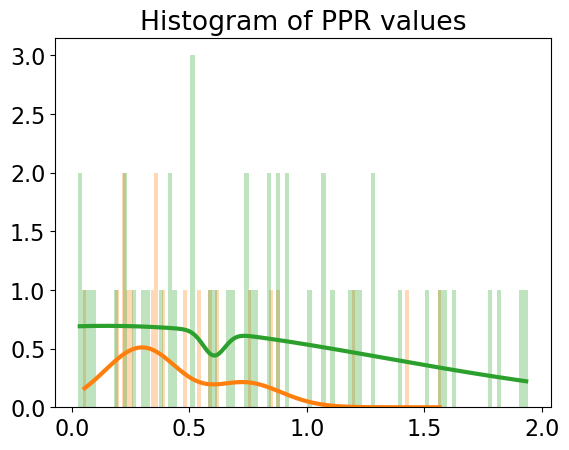

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1
<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


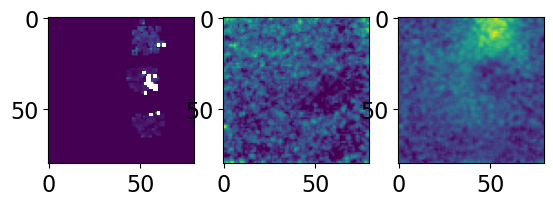

[0, 49, 49]
              params         sigma
mu1     7.365420e-01  6.359255e+08
sigma1 -5.646023e-03  6.124494e+08
A1     -9.200155e-19  2.453626e+01
mu2     7.999083e-01  3.558765e+01
sigma2  3.055378e-03  9.349795e+00
A2      1.058491e+00  4.583329e+03
            params         sigma
mu1       0.700000           NaN
sigma1    0.020000  4.406219e+26
A1       25.000000           NaN
mu2       0.859995  9.550534e+02
sigma2    0.006330  1.044277e+02
A2      937.589038  3.088823e+08


<ipython-input-84-e21b85474538>:129: RuntimeWarning: invalid value encountered in sqrt
  sigma=np.sqrt(np.diag(cov))


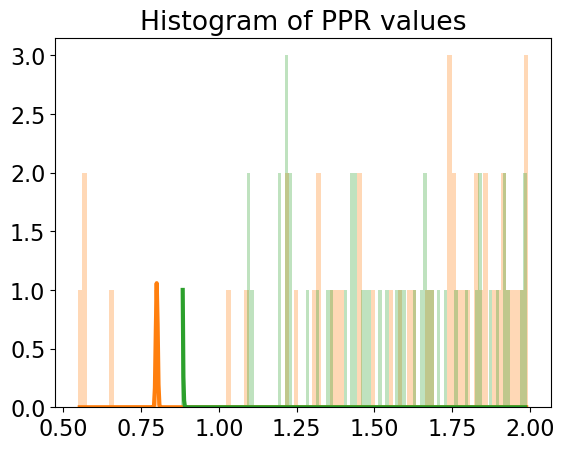

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1
<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


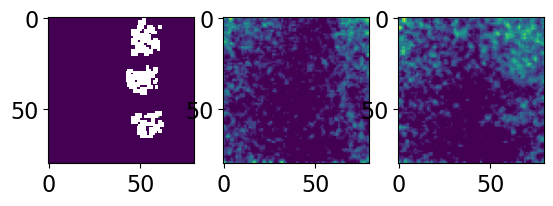

[24, 25, 19]
          params  sigma
mu1     0.712768    NaN
sigma1  0.007073    NaN
A1      2.358772    NaN
mu2     0.694509    NaN
sigma2 -0.005968    NaN
A2     -0.003751    NaN
          params        sigma
mu1     0.713649     0.001316
sigma1  0.005935     3.367731
A1      3.681048  5413.092103
mu2     0.781271    56.990384
sigma2  0.003923    12.318825
A2      1.009980  2123.064085


<ipython-input-84-e21b85474538>:129: RuntimeWarning: invalid value encountered in sqrt
  sigma=np.sqrt(np.diag(cov))


              params         sigma
mu1     7.512347e-01  2.487024e+09
sigma1  1.987760e-03  1.196342e+09
A1      6.848969e-03  5.601556e+11
mu2     7.985073e-01  1.654410e+08
sigma2  1.920757e-02  1.882697e+08
A2      5.494856e-13  4.744808e-01


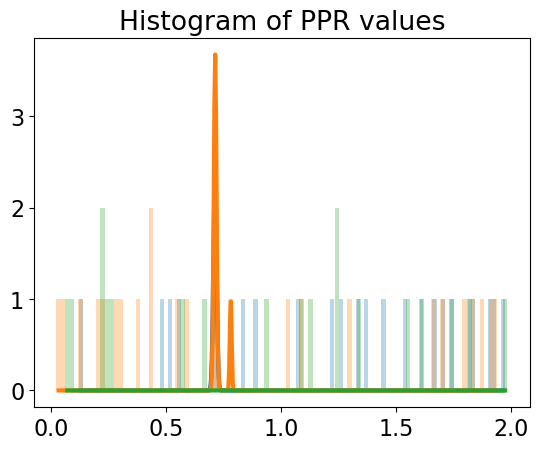

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


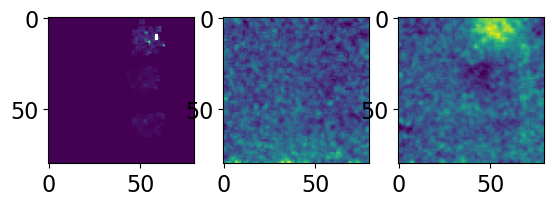

[10, 144, 125]
        params  sigma
mu1       0.70    inf
sigma1    0.02    inf
A1       25.00    inf
mu2       0.80    inf
sigma2    0.02    inf
A2       15.00    inf
          params         sigma
mu1     0.680191  6.765528e+00
sigma1 -0.005045  8.544380e+02
A1      2.407860  1.498122e+06
mu2     0.881568  1.749137e-01
sigma2  1.045020  3.310272e-01
A2      1.649723  1.704269e-01
          params         sigma
mu1     0.707715     20.823391
sigma1  0.004396    140.685903
A1      0.657667  59241.958009
mu2     1.276663      0.053516
sigma2  0.459782      0.064416
A2      1.846739      0.177065


c:\Users\jjudge3\AppData\Local\anaconda3\envs\TSM-to-ZDA\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


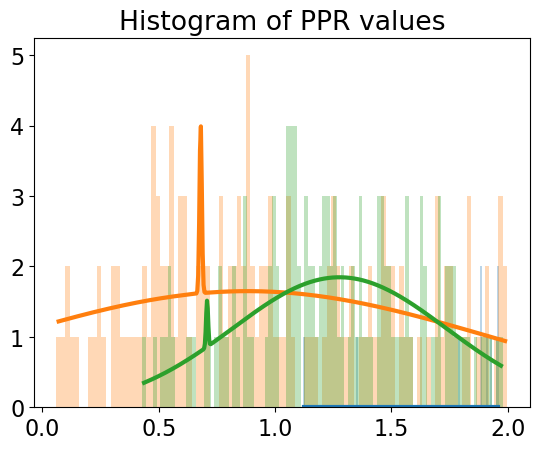

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1
<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


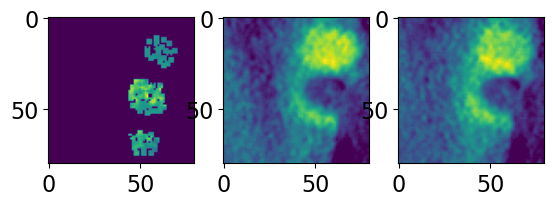

[165, 300, 150]
              params  sigma
mu1    -7.715899e+04    inf
sigma1  3.532372e+03    inf
A1      2.247005e+08    inf
mu2     9.367737e-01    inf
sigma2  5.858576e-02    inf
A2      3.413846e+00    inf
          params     sigma
mu1     1.032618  0.099135
sigma1  0.301023  0.059482
A1      6.980839  0.781567
mu2     0.795903  0.014933
sigma2  0.088222  0.028879
A2     -5.768503  2.330278
          params          sigma
mu1     0.783605       1.193748
sigma1 -0.002359      41.409889
A1      6.812182  400076.813901
mu2     1.060130       0.015323
sigma2  0.162603       0.015784
A2      3.127441       0.251451


c:\Users\jjudge3\AppData\Local\anaconda3\envs\TSM-to-ZDA\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


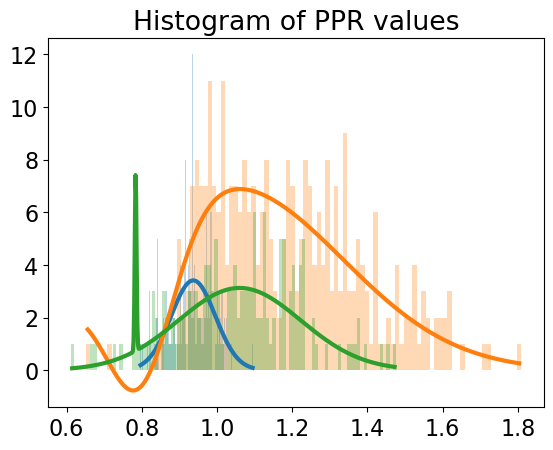

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1
<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


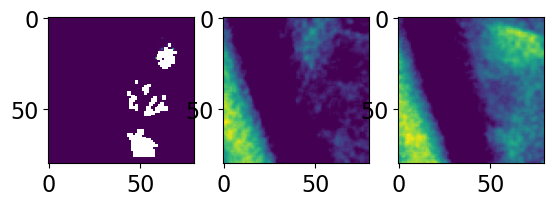

[1, 31, 1]


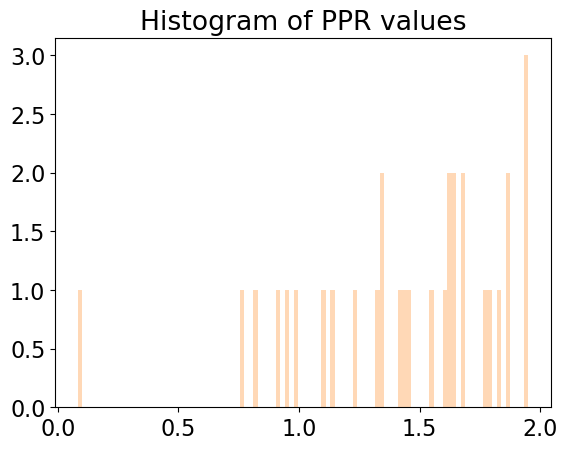

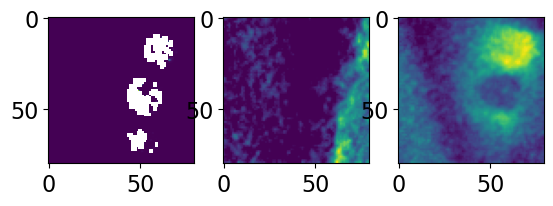

[0, 10, 3]
        params  sigma
mu1       0.70    inf
sigma1    0.02    inf
A1       25.00    inf
mu2       0.80    inf
sigma2    0.02    inf
A2       15.00    inf


c:\Users\jjudge3\AppData\Local\anaconda3\envs\TSM-to-ZDA\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


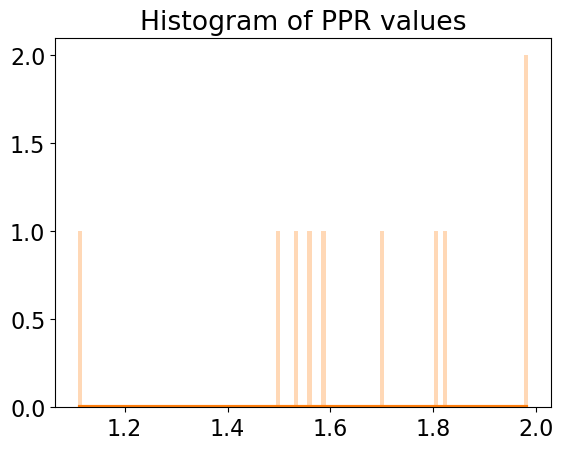

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1
<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


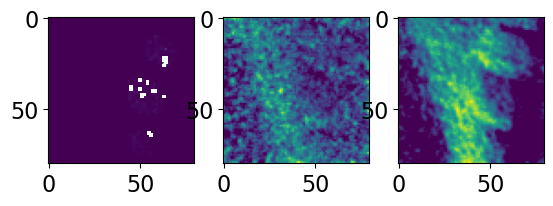

[14, 76, 66]
        params  sigma
mu1       0.70    inf
sigma1    0.02    inf
A1       25.00    inf
mu2       0.80    inf
sigma2    0.02    inf
A2       15.00    inf


c:\Users\jjudge3\AppData\Local\anaconda3\envs\TSM-to-ZDA\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


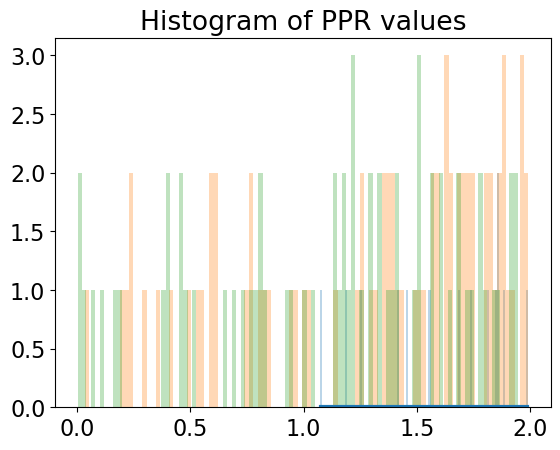

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1
<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


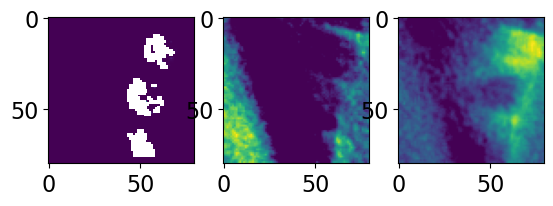

[0, 0, 0]


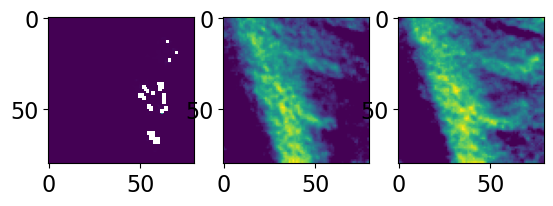

[78, 145, 117]
          params         sigma
mu1     1.440642  3.447281e-02
sigma1  0.384744  3.898821e-02
A1      2.544953  1.831777e-01
mu2     0.805143  8.869391e+05
sigma2  0.001429  4.806083e+06
A2      0.365907  1.188245e+08


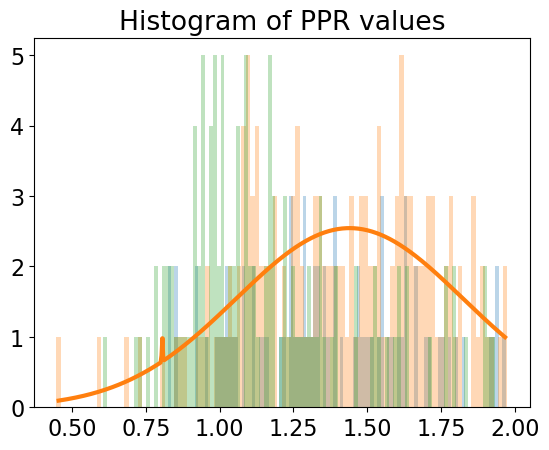

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


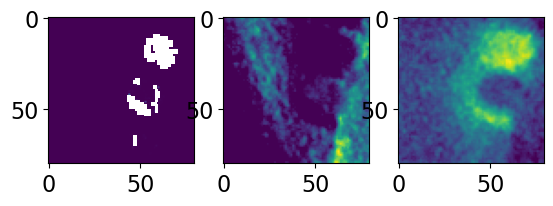

[0, 9, 40]
              params  sigma
mu1     9.251862e+09    inf
sigma1 -8.790891e+08    inf
A1      2.500000e+01    inf
mu2     2.358196e+01    inf
sigma2  4.063088e-01    inf
A2     -2.776572e+04    inf


c:\Users\jjudge3\AppData\Local\anaconda3\envs\TSM-to-ZDA\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


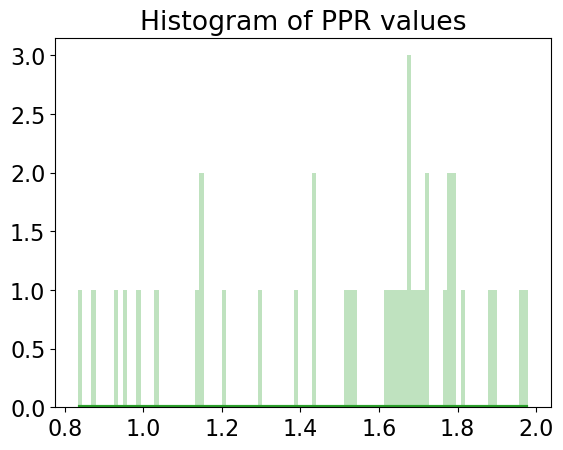

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1
<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


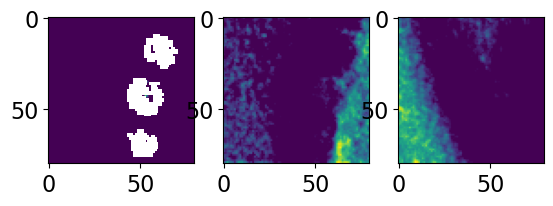

[0, 5, 0]


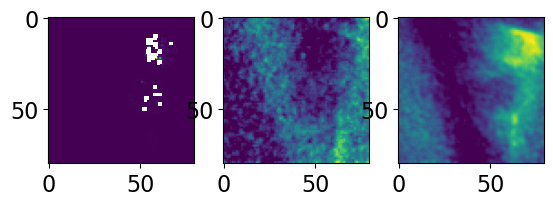

[0, 16, 80]
            params  sigma
mu1     224.829858    inf
sigma1  157.106950    inf
A1        2.207808    inf
mu2       0.799423    inf
sigma2   -0.000498    inf
A2       -2.261938    inf


<ipython-input-84-e21b85474538>:18: RuntimeWarning: overflow encountered in square
  return A*np.exp(-(x-mu)**2/2/sigma**2)
<ipython-input-84-e21b85474538>:18: RuntimeWarning: overflow encountered in double_scalars
  return A*np.exp(-(x-mu)**2/2/sigma**2)
<ipython-input-84-e21b85474538>:18: RuntimeWarning: invalid value encountered in true_divide
  return A*np.exp(-(x-mu)**2/2/sigma**2)
c:\Users\jjudge3\AppData\Local\anaconda3\envs\TSM-to-ZDA\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


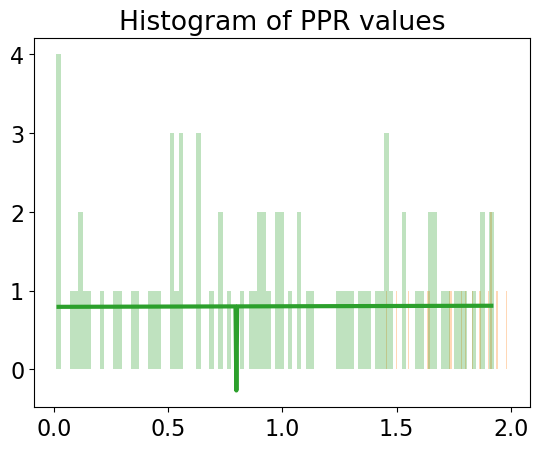

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1
<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


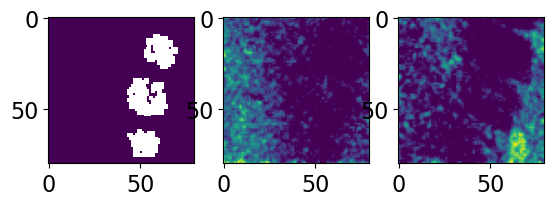

[0, 20, 3]
              params  sigma
mu1     6.999656e-01    inf
sigma1  1.995329e-02    inf
A1     -9.320382e-15    inf
mu2     7.944323e-01    inf
sigma2 -4.002863e-04    inf
A2     -1.811666e-04    inf


c:\Users\jjudge3\AppData\Local\anaconda3\envs\TSM-to-ZDA\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


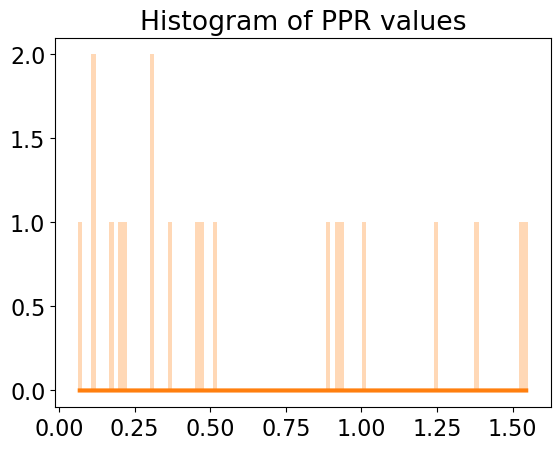

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1
<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


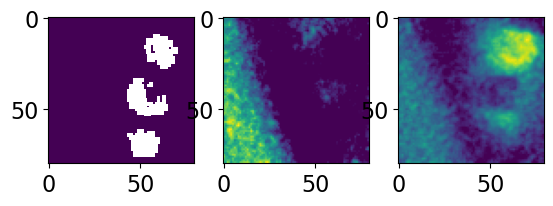

[0, 16, 0]
             params         sigma
mu1        0.700000  3.697120e+13
sigma1     0.020000           NaN
A1        25.000000           NaN
mu2        0.837186           NaN
sigma2    -0.005901           NaN
A2      1454.227768  3.461696e+10


<ipython-input-84-e21b85474538>:129: RuntimeWarning: invalid value encountered in sqrt
  sigma=np.sqrt(np.diag(cov))


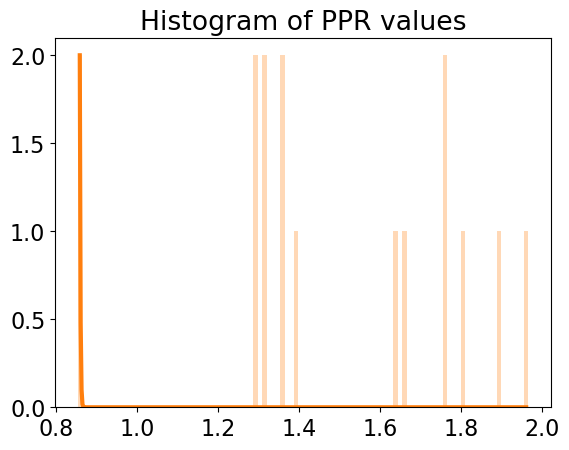

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1
<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


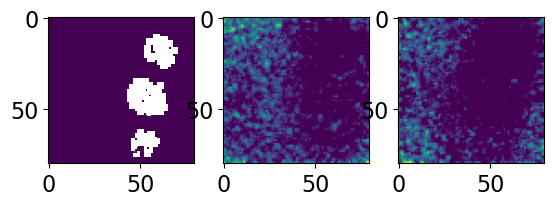

[0, 1, 11]
              params          sigma
mu1     7.000000e-01  396398.592873
sigma1  2.000000e-02  398537.685767
A1      2.881562e-17       0.243757
mu2     8.000000e-01   93830.083724
sigma2  2.000000e-02   94336.420096
A2     -7.681376e-16       0.243757


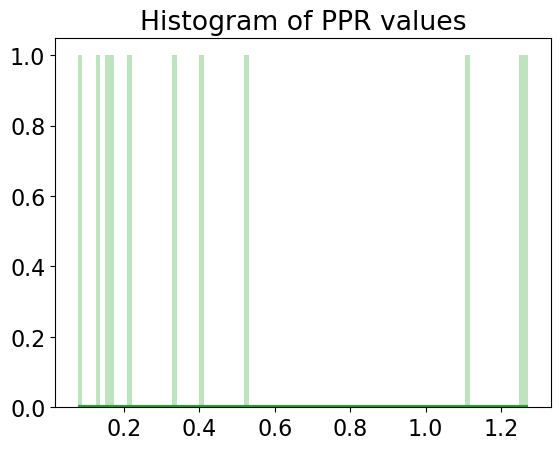

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


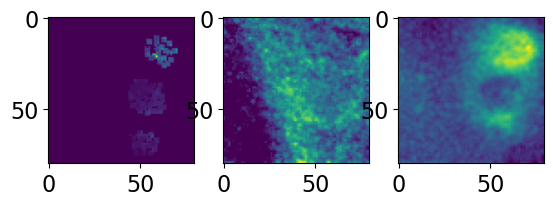

[0, 127, 72]
        params  sigma
mu1       0.70    inf
sigma1    0.02    inf
A1       25.00    inf
mu2       0.80    inf
sigma2    0.02    inf
A2       15.00    inf
        params  sigma
mu1       0.70    inf
sigma1    0.02    inf
A1       25.00    inf
mu2       0.80    inf
sigma2    0.02    inf
A2       15.00    inf


c:\Users\jjudge3\AppData\Local\anaconda3\envs\TSM-to-ZDA\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\Users\jjudge3\AppData\Local\anaconda3\envs\TSM-to-ZDA\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


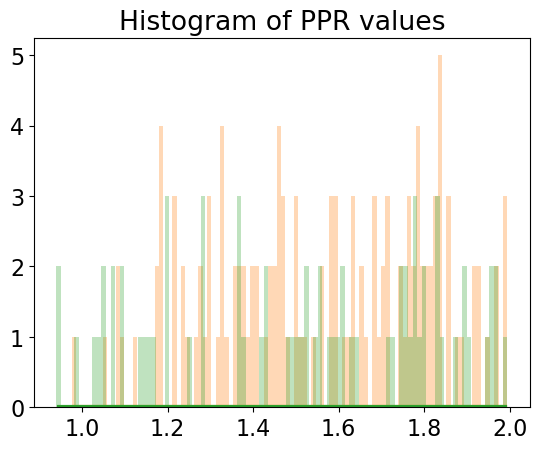

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1
<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


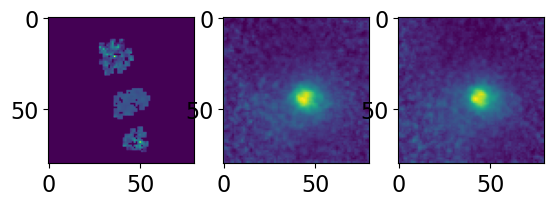

[243, 220, 117]
          params      sigma
mu1     0.711828   0.020224
sigma1  0.007887   0.026276
A1      4.233760  16.568914
mu2     0.965008   0.022677
sigma2  0.339093   0.022188
A2      5.017583   0.286998
              params  sigma
mu1     6.063466e+03    inf
sigma1 -3.871601e+02    inf
A1     -1.354296e+07    inf
mu2     1.008911e+00    inf
sigma2 -8.042665e-02    inf
A2      6.809120e+00    inf
          params      sigma
mu1     0.130414   7.162663
sigma1 -0.210253   2.040765
A1      1.645390  48.763298
mu2     1.112950   0.032313
sigma2  0.257182   0.035187
A2      2.396191   0.204017


c:\Users\jjudge3\AppData\Local\anaconda3\envs\TSM-to-ZDA\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


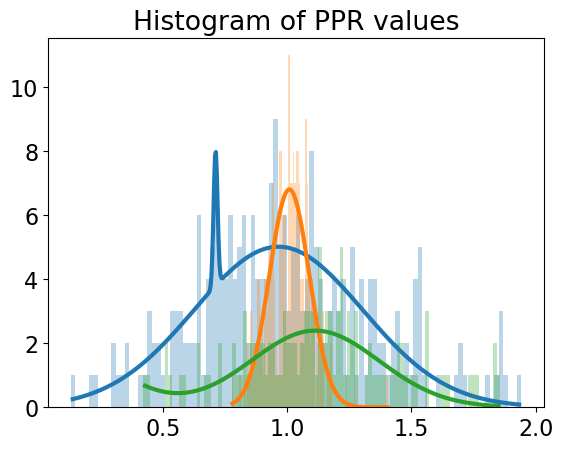

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1
<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


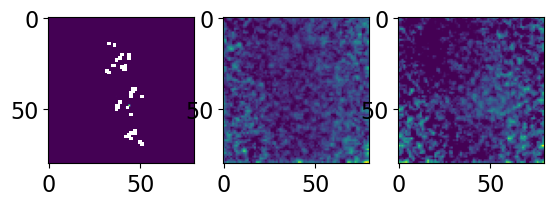

[160, 138, 76]
           params          sigma
mu1      0.036788       0.405055
sigma1   0.759697       0.257288
A1       2.808480       0.465675
mu2      0.806678      26.094598
sigma2   0.004592      83.797162
A2      10.511102  675949.968125
          params     sigma
mu1     0.917480  0.070291
sigma1 -0.063602  0.078403
A1     -0.625981  0.626127
mu2     1.082028  0.088571
sigma2  0.636717  0.130921
A2      1.909929  0.274958


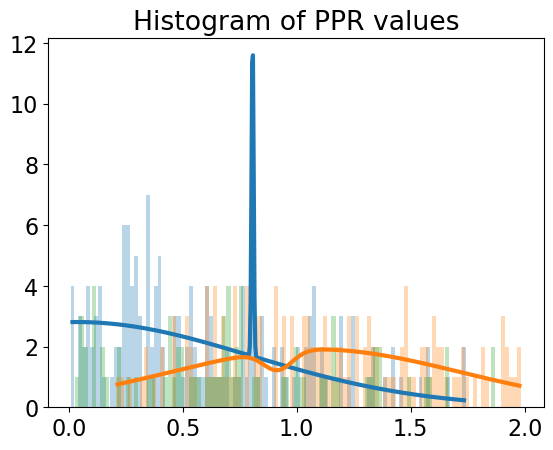

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1
<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


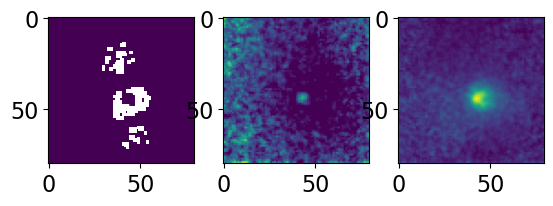

[52, 0, 23]
        params  sigma
mu1       0.70    inf
sigma1    0.02    inf
A1       25.00    inf
mu2       0.80    inf
sigma2    0.02    inf
A2       15.00    inf


c:\Users\jjudge3\AppData\Local\anaconda3\envs\TSM-to-ZDA\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


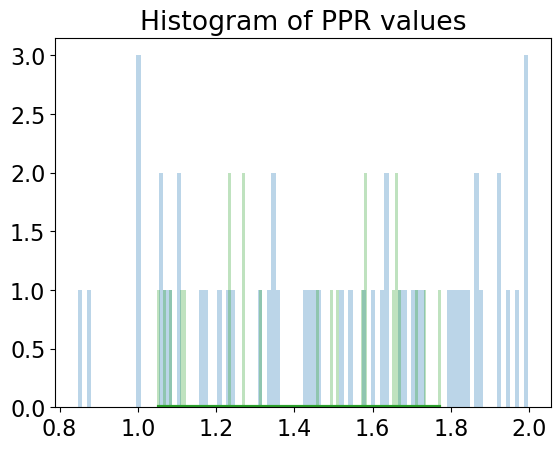

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1
<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


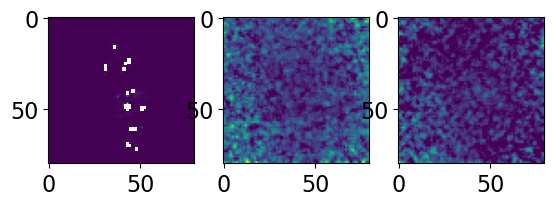

[149, 157, 75]
          params     sigma
mu1     0.537417  0.080860
sigma1  0.258801  0.082617
A1      2.609464  1.486172
mu2     1.256666  0.507688
sigma2 -0.462314  0.414250
A2      1.275500  0.363633
          params          sigma
mu1     0.028758     111.510274
sigma1  0.006061     104.879949
A1      4.324506  171806.666957
mu2    -0.290640       1.211225
sigma2 -0.918968       0.570178
A2      1.664912       1.036942


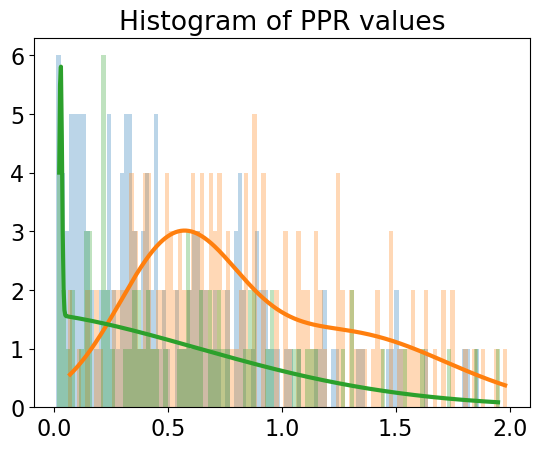

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1
<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


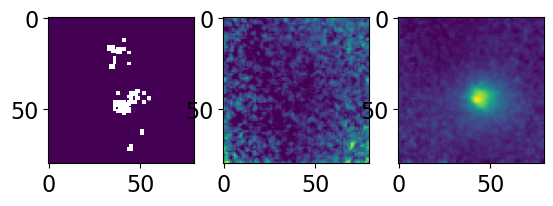

[71, 0, 11]
          params      sigma
mu1     0.646832  11.330126
sigma1  0.003268   2.466516
A1      2.000017  28.773653
mu2     0.799492   0.035957
sigma2  0.021579   0.035957
A2      0.621514   0.895424
        params  sigma
mu1       0.70    inf
sigma1    0.02    inf
A1       25.00    inf
mu2       0.80    inf
sigma2    0.02    inf
A2       15.00    inf


c:\Users\jjudge3\AppData\Local\anaconda3\envs\TSM-to-ZDA\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


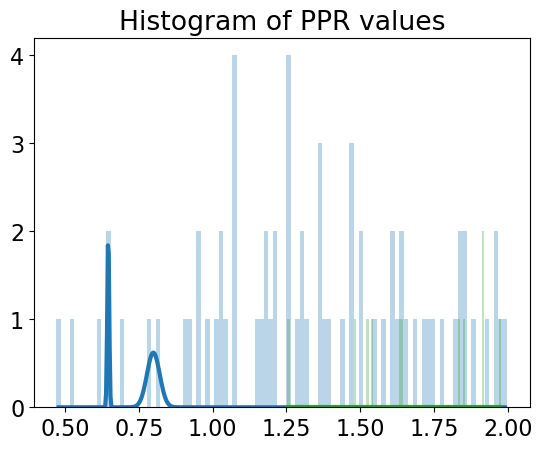

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1
<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


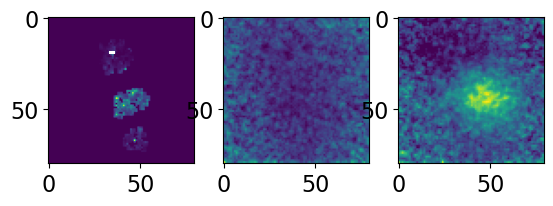

[203, 0, 94]
          params     sigma
mu1     0.932039  0.289289
sigma1  0.397151  0.200319
A1      2.380874  0.504884
mu2     0.408524  0.036023
sigma2  0.174185  0.064358
A2      3.581266  1.861243
          params          sigma
mu1     0.696593       0.003196
sigma1  0.005307     125.815888
A1      5.245063  412182.582591
mu2     0.789353       0.029399
sigma2  0.008262       0.031091
A2      3.835960      16.707989


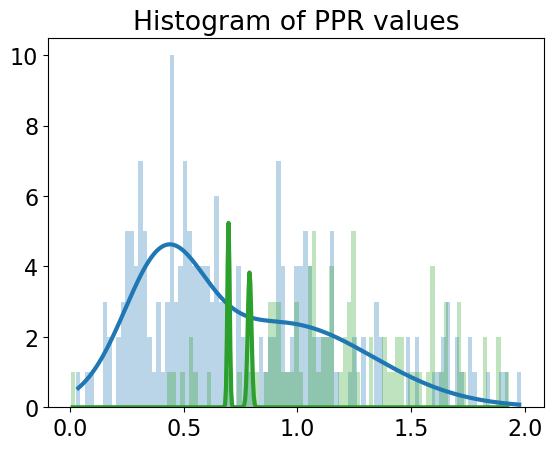

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


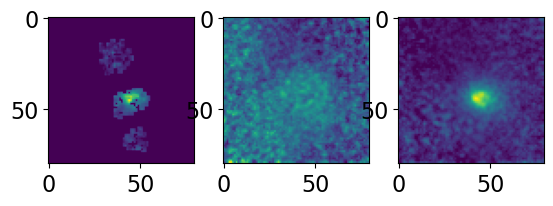

[247, 120, 121]
          params  sigma
mu1     0.580007    inf
sigma1  0.295490    inf
A1      6.228869    inf
mu2     0.790056    inf
sigma2  0.000305    inf
A2     -5.245913    inf
          params     sigma
mu1     0.729294  0.028359
sigma1  0.018677  0.029709
A1     -0.654281  0.875463
mu2     1.652548  0.167355
sigma2  0.604355  0.187860
A2      1.665177  0.170862


c:\Users\jjudge3\AppData\Local\anaconda3\envs\TSM-to-ZDA\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


          params     sigma
mu1     0.541137  0.076747
sigma1  0.150227  0.063123
A1      1.838820  0.982715
mu2     0.987245  0.161392
sigma2  0.250300  0.123464
A2      1.754455  0.353070


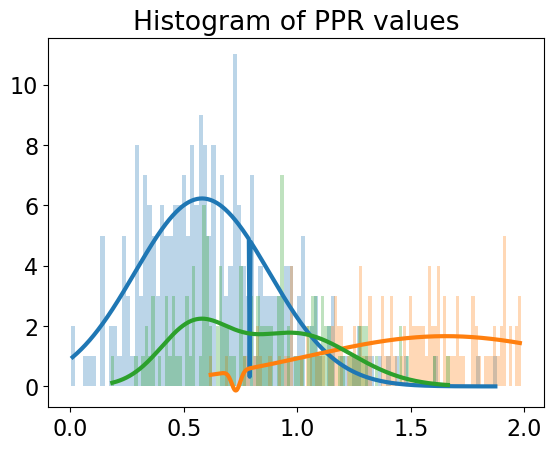

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1
<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


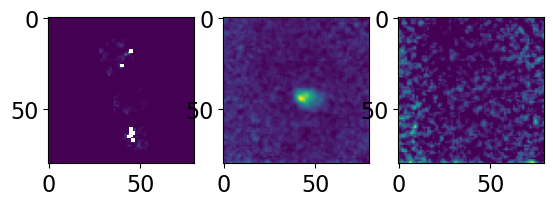

[127, 154, 75]
          params     sigma
mu1     0.673235  0.018582
sigma1 -0.035275  0.019853
A1     -1.654764  0.771868
mu2     0.180452  0.112729
sigma2  0.443636  0.088067
A2      3.118336  0.245196
          params     sigma
mu1     0.281789  0.150969
sigma1  0.459717  0.129721
A1      1.783311  0.205256
mu2     0.806885  0.057382
sigma2  0.085397  0.067883
A2     -0.787675  0.496288


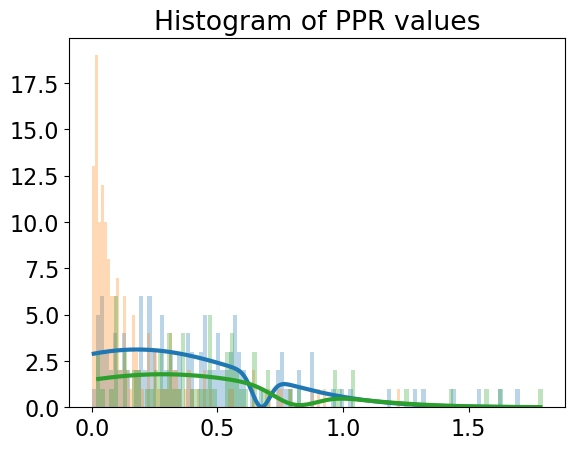

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1
<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


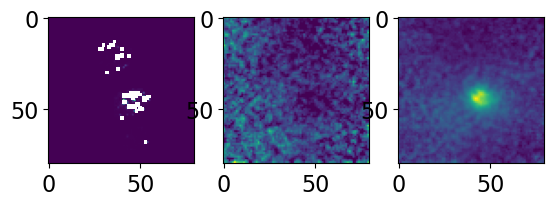

[76, 0, 43]
              params       sigma
mu1     6.969134e-01  227.450601
sigma1  1.705775e-02  227.346859
A1     -1.901599e-09    1.098815
mu2     8.015450e-01    1.199899
sigma2  3.652659e-03    0.308698
A2      2.004841e+00   46.383841
        params  sigma
mu1       0.70    inf
sigma1    0.02    inf
A1       25.00    inf
mu2       0.80    inf
sigma2    0.02    inf
A2       15.00    inf


c:\Users\jjudge3\AppData\Local\anaconda3\envs\TSM-to-ZDA\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


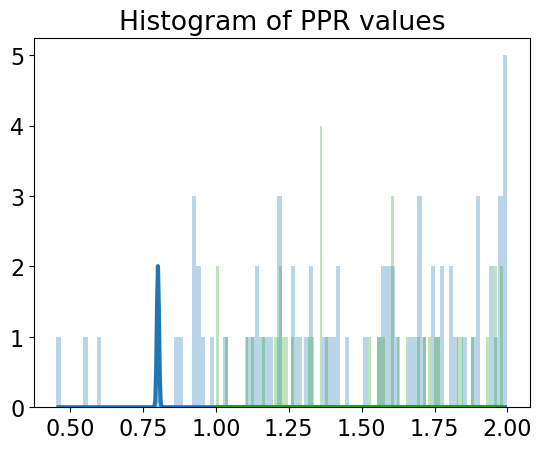

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1
<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


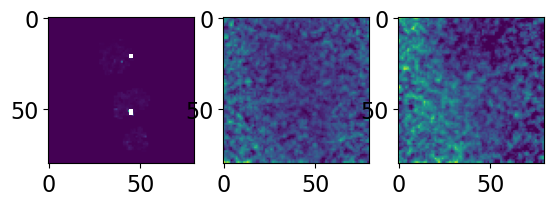

[226, 167, 99]
          params     sigma
mu1     0.679505  0.008089
sigma1 -0.018282  0.008585
A1     -3.777047  1.481746
mu2     0.776363  0.045961
sigma2  0.518860  0.053012
A2      3.869388  0.306953
          params     sigma
mu1     0.712122  0.026928
sigma1 -0.025962  0.028395
A1      1.057453  0.969018
mu2     1.173874  0.050102
sigma2  0.424973  0.054362
A2      2.597522  0.243264
          params     sigma
mu1     0.755531  0.037617
sigma1  0.115222  0.044266
A1      1.416600  0.417124
mu2     1.445303  0.571562
sigma2 -1.003717  0.773789
A2      0.870092  0.169290


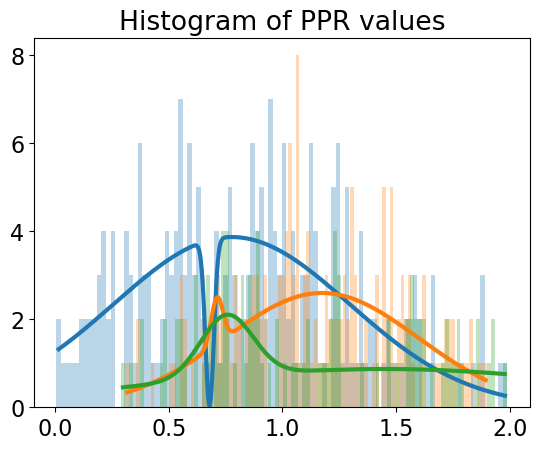

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1
<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


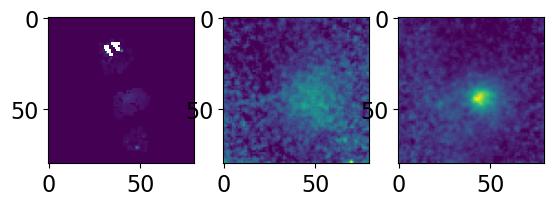

[200, 101, 109]
          params     sigma
mu1     0.837105  0.055713
sigma1  0.586632  0.082582
A1      3.081510  0.400963
mu2     0.800983  0.084497
sigma2  0.089258  0.102543
A2     -0.714894  0.651543
              params         sigma
mu1        -0.123154  1.238289e+02
sigma1      0.177764  1.350294e+01
A1      11632.640975  1.853303e+07
mu2         0.720446           NaN
sigma2     -0.002846           NaN
A2         -2.427387           NaN


<ipython-input-84-e21b85474538>:129: RuntimeWarning: invalid value encountered in sqrt
  sigma=np.sqrt(np.diag(cov))


          params          sigma
mu1     0.745859      19.192930
sigma1 -0.004457      47.843013
A1      6.975994  251150.706586
mu2     1.061929       0.034905
sigma2 -0.277742       0.034256
A2      2.325164       0.242637


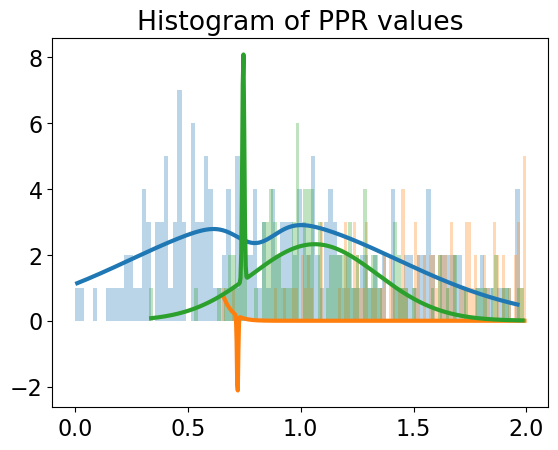

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1
<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


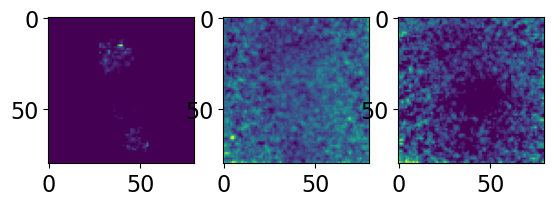

[203, 18, 93]
          params     sigma
mu1     0.249427  0.057600
sigma1  0.194699  0.113333
A1      3.815166  6.249062
mu2     0.610635  0.642242
sigma2  0.326563  0.278958
A2      2.753057  2.932817
        params  sigma
mu1       0.70    inf
sigma1    0.02    inf
A1       25.00    inf
mu2       0.80    inf
sigma2    0.02    inf
A2       15.00    inf
          params     sigma
mu1     0.148625  0.124609
sigma1  0.433359  0.097476
A1      2.585578  0.226953
mu2     0.786258  0.023437
sigma2  0.008049  0.011356
A2      2.172175  1.785293


c:\Users\jjudge3\AppData\Local\anaconda3\envs\TSM-to-ZDA\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


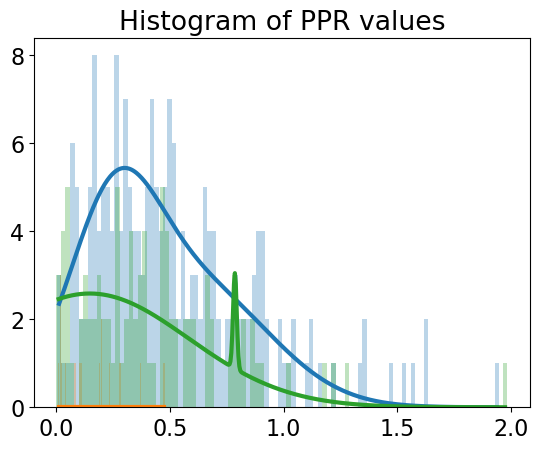

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1
<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


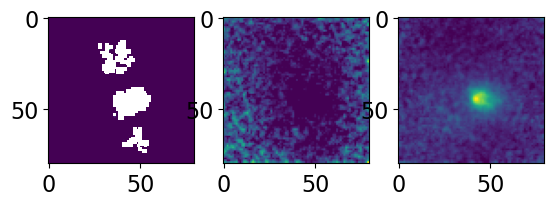

[56, 0, 17]
              params          sigma
mu1     7.000000e-01  104601.571025
sigma1  2.000000e-02  105167.773150
A1      3.610443e-16       0.379343
mu2     8.000000e-01  808764.087911
sigma2  2.000000e-02  813122.115004
A2      1.110539e-17       0.379340


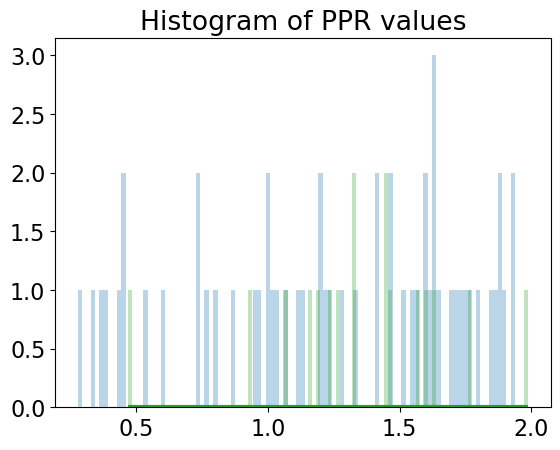

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


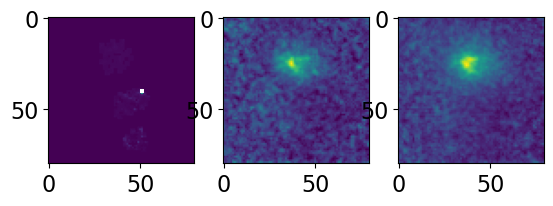

[231, 151, 79]
        params  sigma
mu1       0.70    inf
sigma1    0.02    inf
A1       25.00    inf
mu2       0.80    inf
sigma2    0.02    inf
A2       15.00    inf
              params         sigma
mu1     7.424771e-01  6.356000e+08
sigma1 -7.179493e-03  6.268484e+08
A1      1.874583e-09  3.725086e+02
mu2     7.568035e-01  4.477370e+09
sigma2  1.198899e-02  1.397954e+09
A2     -8.317568e-10  2.180238e+02
          params     sigma
mu1     0.661707  0.053241
sigma1  0.087069  0.065438
A1      0.770897  0.459199
mu2     1.378273  0.104255
sigma2  0.449518  0.148042
A2      1.146036  0.196420


c:\Users\jjudge3\AppData\Local\anaconda3\envs\TSM-to-ZDA\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


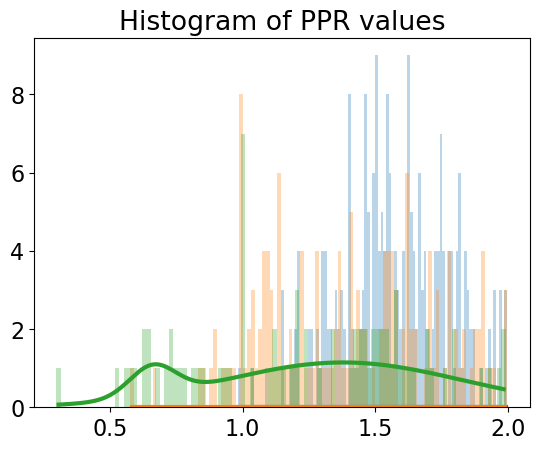

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1
<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


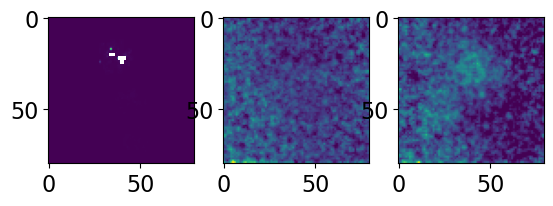

[98, 198, 110]
           params         sigma
mu1      0.727446  3.459567e+05
sigma1   0.005696  4.473270e+04
A1      47.917490  5.037437e+09
mu2      0.781260  4.174789e+00
sigma2   0.002893  1.017459e+00
A2       1.000753  5.815178e+01
          params     sigma
mu1     0.714714  0.032985
sigma1  0.379317  0.036693
A1      4.044359  0.368235
mu2     0.834607  0.037432
sigma2  0.042143  0.041793
A2     -1.070909  0.861277
          params         sigma
mu1     0.668063  1.915518e+02
sigma1 -0.004359  4.183950e+02
A1     -8.271949  3.183126e+06
mu2     0.713099  7.905216e-02
sigma2  0.554354  9.645997e-02
A2      1.656853  1.862301e-01


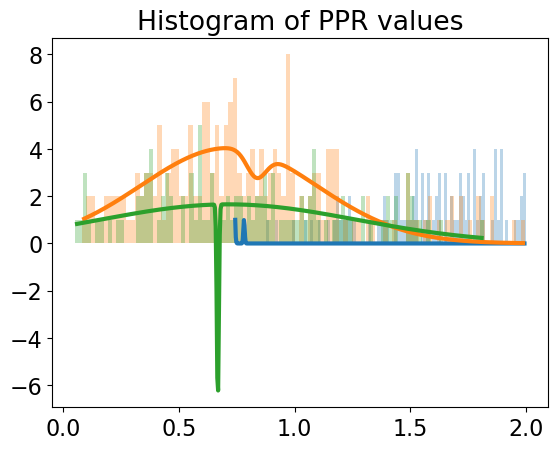

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1
<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


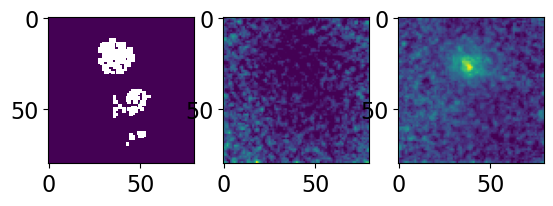

[0, 43, 67]
          params          sigma
mu1     0.667030       9.887043
sigma1 -0.005216     257.680459
A1     -1.576626  265539.740439
mu2     1.250316       0.076001
sigma2 -0.398232       0.082900
A2      0.841323       0.134056
          params     sigma
mu1     0.621193  0.014059
sigma1 -0.019828  0.014455
A1     -0.997803  0.618373
mu2     0.862266  0.122479
sigma2 -0.626151  0.186269
A2      0.879550  0.131751


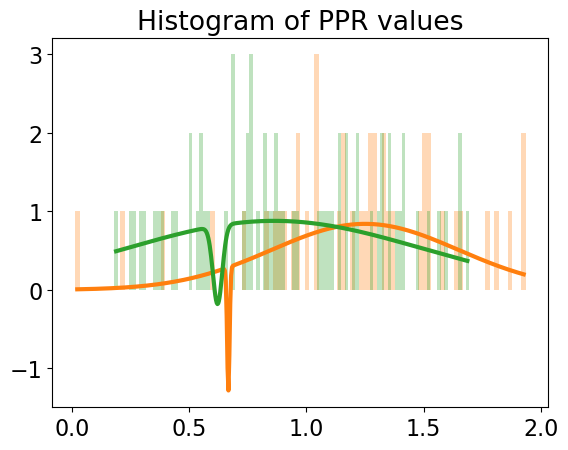

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1
<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


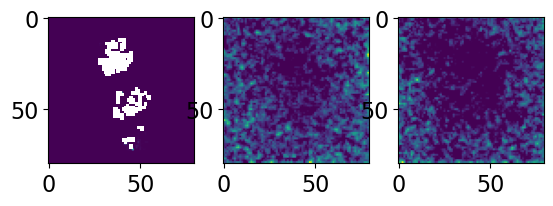

[17, 32, 58]
              params          sigma
mu1     7.000000e-01   36748.742336
sigma1  2.000000e-02   36921.738916
A1      2.158509e-15       0.427303
mu2     8.000000e-01  252950.140391
sigma2  2.000000e-02  254255.495357
A2     -7.631977e-17       0.427374
          params          sigma
mu1     0.758445       0.001580
sigma1 -0.005576       6.378674
A1      3.905365   12121.681652
mu2     0.843111    3532.526328
sigma2 -0.003455     832.075897
A2      1.149228  691420.691263
           params        sigma
mu1      0.871772     0.060705
sigma1  -0.052373     0.065054
A1       0.446251     0.459289
mu2    -14.249972   469.490237
sigma2   5.170813    80.303410
A2      40.356980  5348.490066


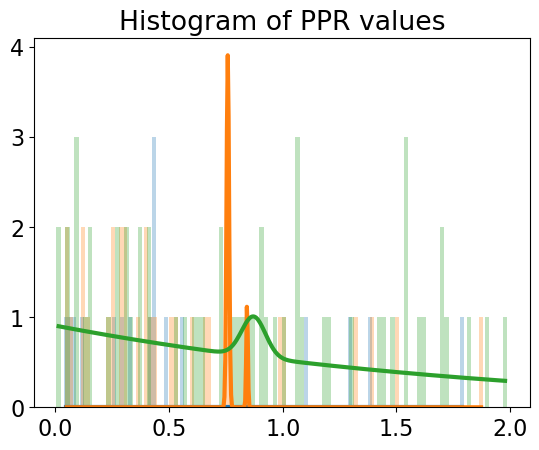

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1
<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


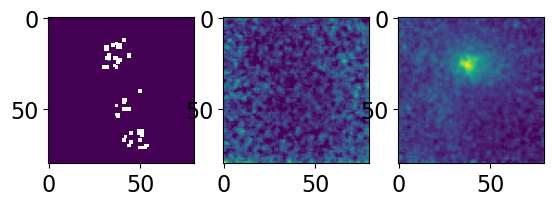

[4, 59, 62]
           params     sigma
mu1      0.636905       NaN
sigma1   0.002349       NaN
A1      30.941962       NaN
mu2      1.966916  0.600058
sigma2  -0.689483  0.408202
A2       0.933671  0.239374
          params  sigma
mu1     0.726438    inf
sigma1 -0.000310    inf
A1      0.515506    inf
mu2     1.135008    inf
sigma2  0.485311    inf
A2      0.902389    inf


<ipython-input-84-e21b85474538>:129: RuntimeWarning: invalid value encountered in sqrt
  sigma=np.sqrt(np.diag(cov))
c:\Users\jjudge3\AppData\Local\anaconda3\envs\TSM-to-ZDA\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


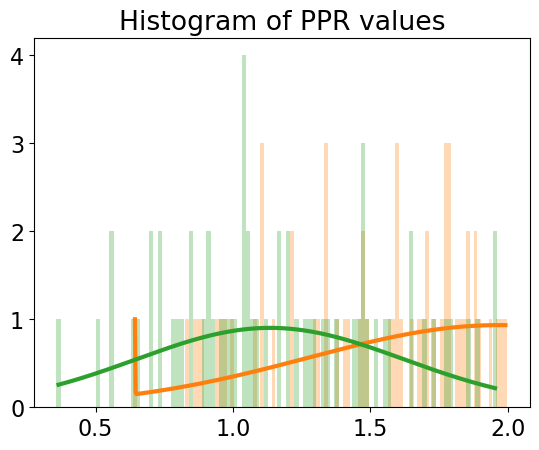

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1
<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


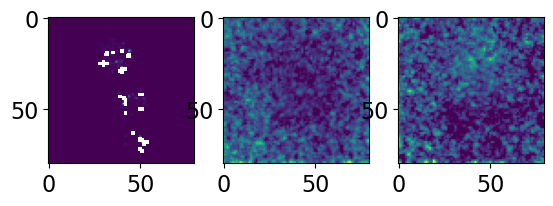

[113, 144, 87]
          params     sigma
mu1     0.972730  0.002780
sigma1 -0.011974  0.003832
A1      5.819814  1.445275
mu2     1.457301  0.111674
sigma2  0.579372  0.122205
A2      1.581207  0.182239
          params     sigma
mu1     1.628826  0.184277
sigma1  0.308473  0.246286
A1      0.903464  0.292180
mu2     0.573791  0.087645
sigma2 -0.422511  0.120065
A2      2.307724  0.234381
          params         sigma
mu1    -0.372889  1.382078e+00
sigma1  1.000713  6.609525e-01
A1      1.796523  1.151331e+00
mu2     0.797773  2.649051e+01
sigma2  0.004140  3.301426e+03
A2      9.905144  3.470474e+07


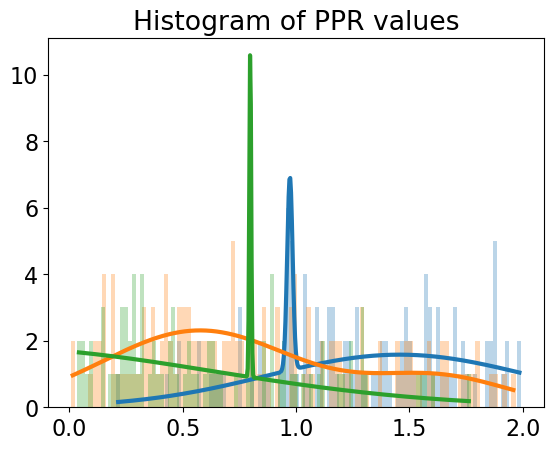

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1
<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


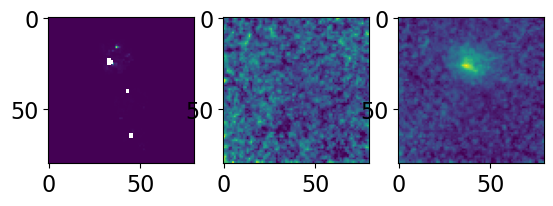

[31, 183, 101]
        params  sigma
mu1       0.70    inf
sigma1    0.02    inf
A1       25.00    inf
mu2       0.80    inf
sigma2    0.02    inf
A2       15.00    inf
          params     sigma
mu1     0.655298  0.070183
sigma1 -0.213342  0.065395
A1      2.716500  1.065156
mu2     1.354287  0.184296
sigma2  0.396764  0.187660
A2      2.268995  0.325386
          params     sigma
mu1     0.690386  0.015099
sigma1 -0.021246  0.015640
A1      1.266909  0.789177
mu2     0.888648  0.056390
sigma2  0.450059  0.060140
A2      1.648408  0.186328


c:\Users\jjudge3\AppData\Local\anaconda3\envs\TSM-to-ZDA\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


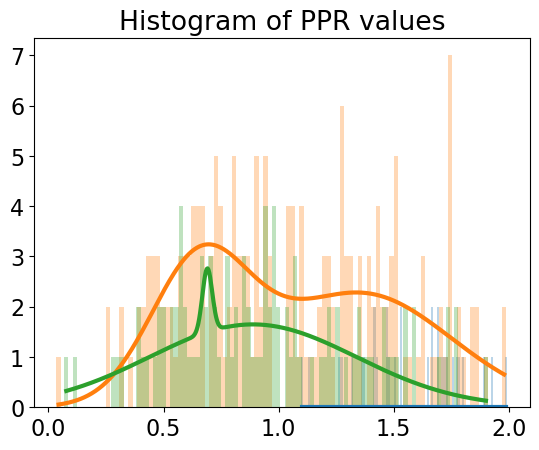

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1
<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


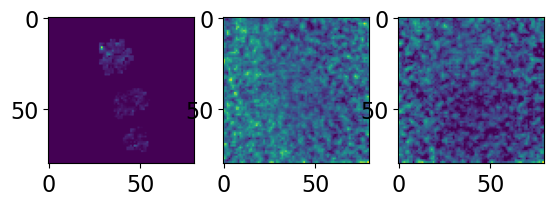

[225, 202, 103]
          params         sigma
mu1     0.534207  5.267918e+05
sigma1  0.001171           NaN
A1      2.060621  5.476654e+08
mu2     1.004883  4.553461e-02
sigma2  0.435421  4.727405e-02
A2      4.050957  3.643178e-01


<ipython-input-84-e21b85474538>:129: RuntimeWarning: invalid value encountered in sqrt
  sigma=np.sqrt(np.diag(cov))


           params         sigma
mu1      0.449202      0.111018
sigma1   0.530008      0.112288
A1       1.826927      0.206068
mu2      0.861115      5.230375
sigma2   0.005532     11.565136
A2      12.622866  83366.219567


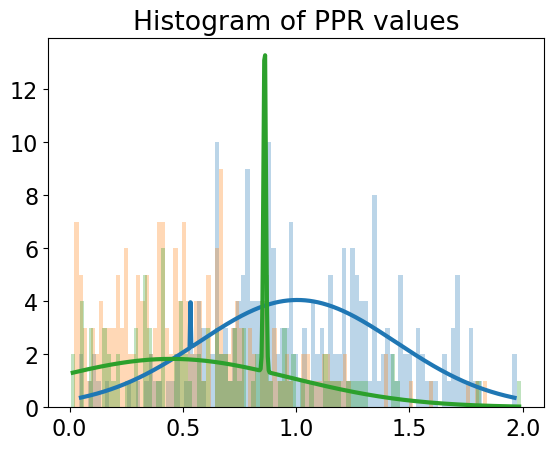

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1
<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


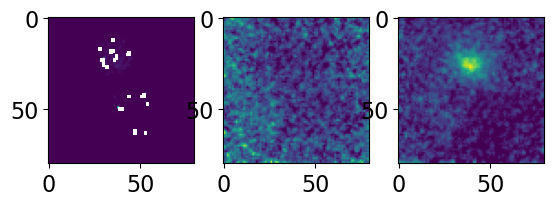

[12, 162, 62]
            params         sigma
mu1       0.700000  5.785472e+26
sigma1    0.020000           NaN
A1       25.000000  6.568467e+30
mu2       0.856952  1.102266e+01
sigma2    0.005987  8.491938e-01
A2      782.730966  3.968689e+06
          params     sigma
mu1     0.740745  0.054235
sigma1  0.504095  0.062962
A1      3.000084  0.376006
mu2     0.913869  0.031624
sigma2  0.091186  0.039089
A2     -1.692489  0.576060
          params     sigma
mu1     0.702512       NaN
sigma1  0.002149       NaN
A1      0.205133       NaN
mu2     0.335942  0.087125
sigma2  0.374873  0.089044
A2      1.451295  0.181485


<ipython-input-84-e21b85474538>:129: RuntimeWarning: invalid value encountered in sqrt
  sigma=np.sqrt(np.diag(cov))
<ipython-input-84-e21b85474538>:129: RuntimeWarning: invalid value encountered in sqrt
  sigma=np.sqrt(np.diag(cov))


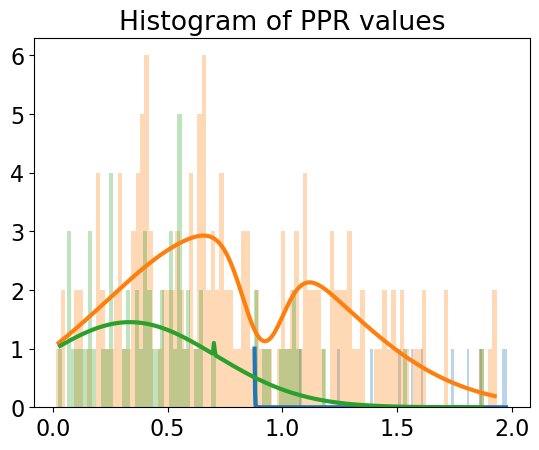

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1
<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


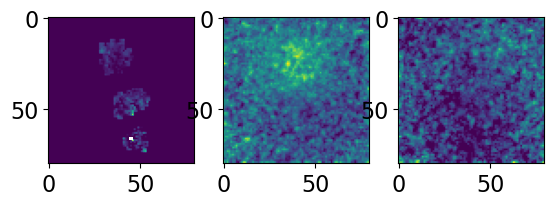

[240, 209, 87]
          params     sigma
mu1     0.290492  0.024229
sigma1  0.261349  0.031936
A1      5.788737  0.384256
mu2     0.852185  0.122101
sigma2 -0.052360  0.130183
A2     -0.393428  0.805897
          params     sigma
mu1     0.232099  0.012990
sigma1  0.049789  0.015966
A1      3.588859  0.894534
mu2     0.485359  0.042303
sigma2  0.290945  0.035235
A2      4.063971  0.363527
          params         sigma
mu1     0.782613  2.383592e+05
sigma1 -0.002884  5.485141e+04
A1      1.634546  1.627429e+08
mu2     0.362292  5.995070e-02
sigma2  0.361729  6.477505e-02
A2      1.985752  2.071011e-01


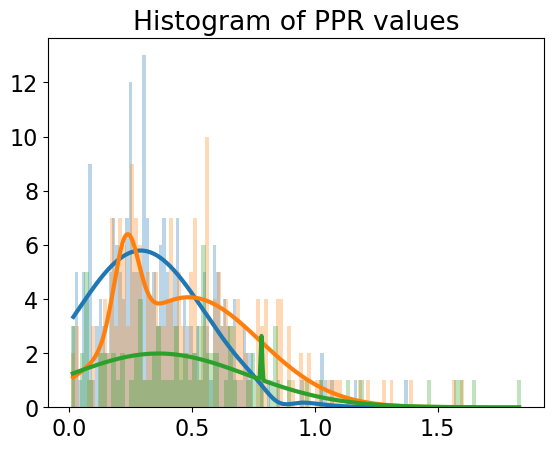

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1
<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


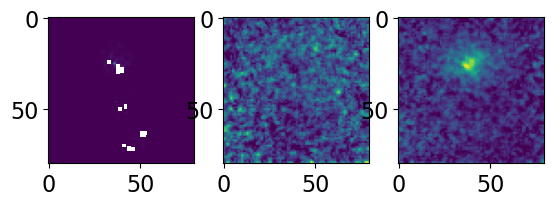

[72, 178, 83]
          params     sigma
mu1     1.246610  0.082051
sigma1  0.089991  0.091685
A1     -0.793297  0.650256
mu2     0.616538  0.127073
sigma2  0.708104  0.130771
A2      2.645711  0.250151
          params          sigma
mu1     0.692171      12.366943
sigma1  0.005146      34.727177
A1      8.311166  188360.390082
mu2     0.672427       0.402079
sigma2  1.104013       0.647992
A2      0.921195       0.144117


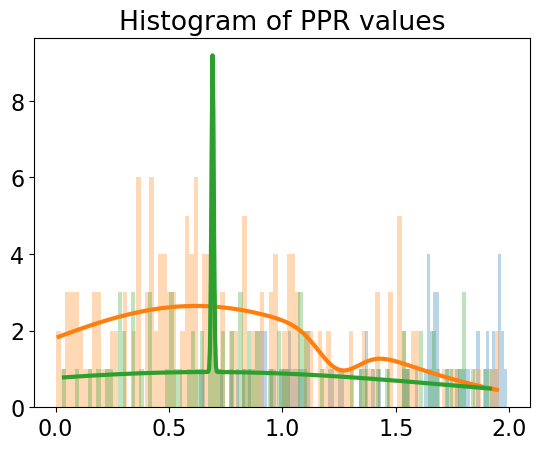

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1
<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


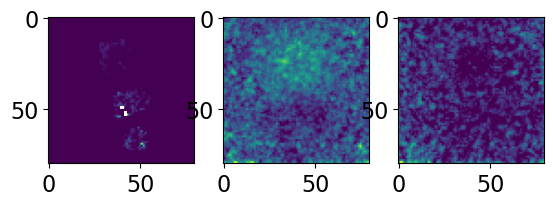

[127, 151, 94]
             params         sigma
mu1       -0.731128  2.481413e+00
sigma1     0.615761  7.661190e-01
A1         5.693201  1.810928e+01
mu2        0.763306  9.602256e+04
sigma2     0.001609  4.317114e+04
A2      1112.617088  3.016993e+11
             params          sigma
mu1        0.934063            NaN
sigma1    -0.003468            NaN
A1        -9.989624            NaN
mu2       -8.908035      59.048004
sigma2     2.418364       7.551010
A2      4189.370126  199763.778796
          params     sigma
mu1     0.682082  0.047034
sigma1  0.053512  0.051531
A1      0.763618  0.601623
mu2    -1.251603  4.204732
sigma2  1.287587  1.394527
A2      3.380944  7.890149


<ipython-input-84-e21b85474538>:129: RuntimeWarning: invalid value encountered in sqrt
  sigma=np.sqrt(np.diag(cov))


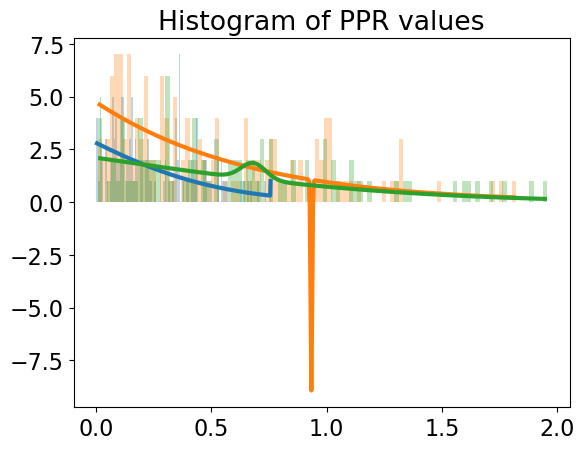

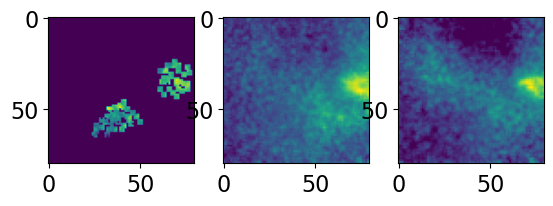

[226, 249]
          params     sigma
mu1     0.694216  0.014629
sigma1 -0.059737  0.021710
A1     -3.939525  1.828987
mu2     0.796108  0.030066
sigma2  0.129015  0.012767
A2      6.718648  1.328701
          params     sigma
mu1     0.671024  0.012326
sigma1  0.174071  0.011559
A1      6.958577  0.398488
mu2     0.836720  0.006321
sigma2  0.010952  0.006484
A2     -3.152861  1.586158


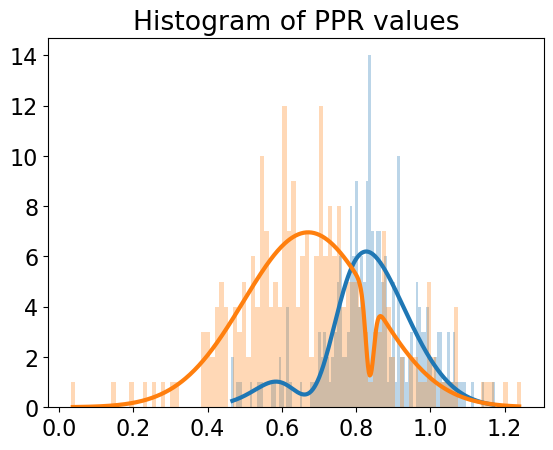

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1
<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


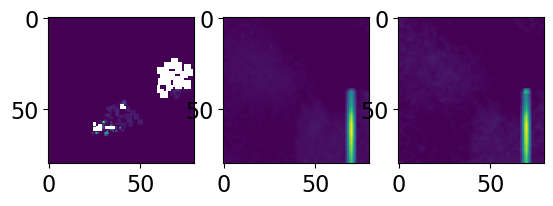

[35, 179]
          params      sigma
mu1     0.688202   0.957222
sigma1  0.002517   0.244568
A1      1.000433  11.271481
mu2     0.804758   0.019016
sigma2  0.015240   0.019016
A2      0.616414   0.666124
          params     sigma
mu1     0.488623  0.010862
sigma1  0.117044  0.011980
A1      8.192136  0.566562
mu2     0.810324  0.056138
sigma2  0.075522  0.056218
A2      1.289118  0.688010


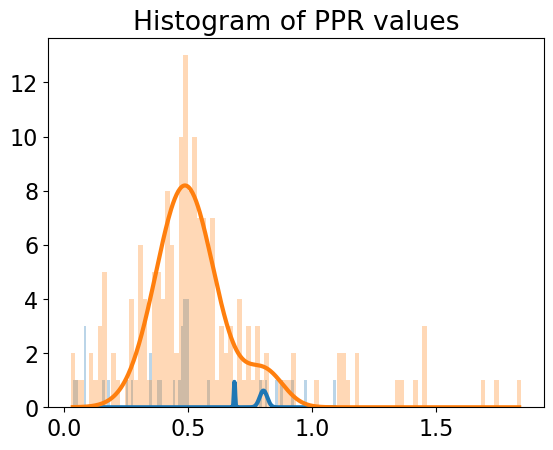

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1
<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


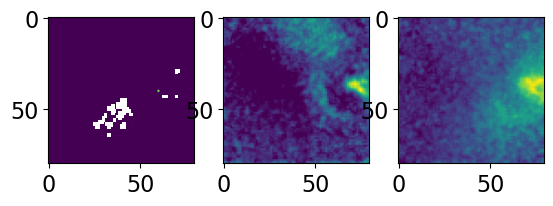

[38, 10]
        params  sigma
mu1       0.70    inf
sigma1    0.02    inf
A1       25.00    inf
mu2       0.80    inf
sigma2    0.02    inf
A2       15.00    inf


c:\Users\jjudge3\AppData\Local\anaconda3\envs\TSM-to-ZDA\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
<ipython-input-84-e21b85474538>:18: RuntimeWarning: overflow encountered in square
  return A*np.exp(-(x-mu)**2/2/sigma**2)
<ipython-input-84-e21b85474538>:18: RuntimeWarning: overflow encountered in double_scalars
  return A*np.exp(-(x-mu)**2/2/sigma**2)
<ipython-input-84-e21b85474538>:18: RuntimeWarning: invalid value encountered in true_divide
  return A*np.exp(-(x-mu)**2/2/sigma**2)


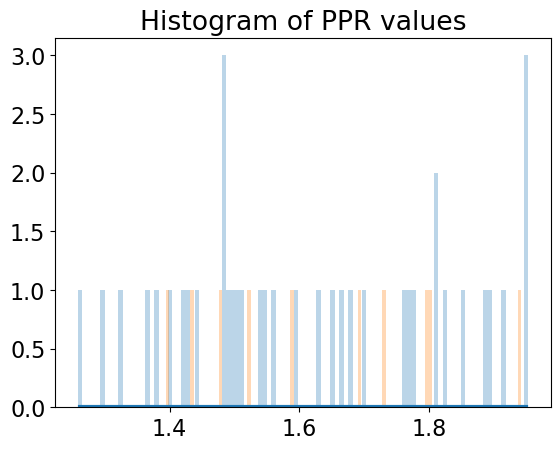

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1
<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


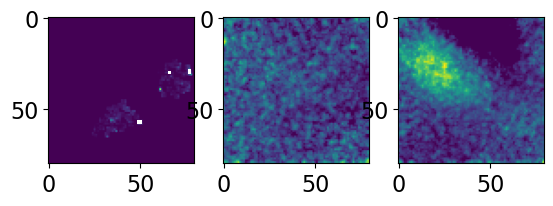

[160, 179]
          params       sigma
mu1     0.014019    2.774548
sigma1  0.477724    1.411559
A1     -6.039550   63.858396
mu2    -0.585858   16.258879
sigma2  1.168226    3.653823
A2      7.922621  123.494007
           params          sigma
mu1      1.162428       0.060999
sigma1   0.545141       0.070519
A1       2.626829       0.244477
mu2      0.781040      32.068419
sigma2   0.004901      55.601287
A2      11.046798  435898.496673


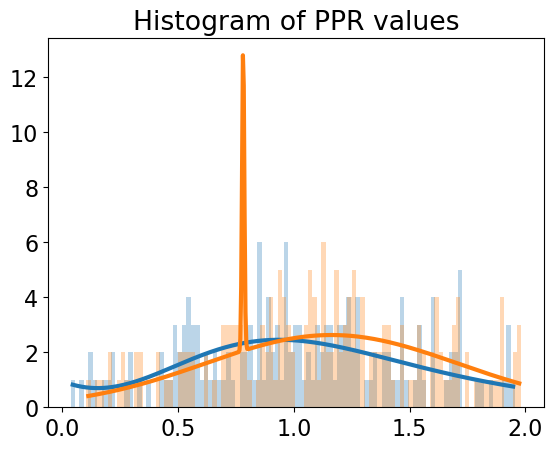

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1
<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


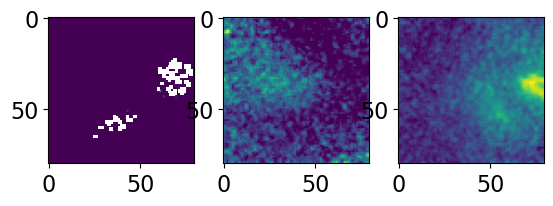

[0, 36]


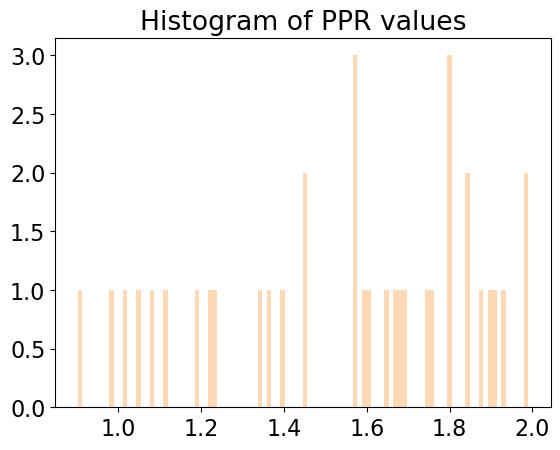

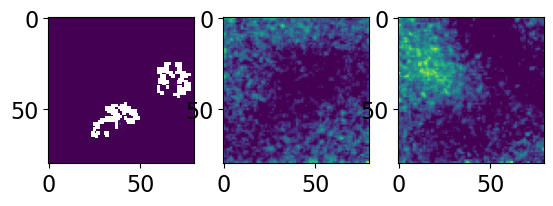

[13, 57]
              params         sigma
mu1     7.147822e-01  1.726790e+08
sigma1 -4.604868e-03  1.221822e+08
A1     -2.141953e-10  7.088723e+00
mu2     8.003222e-01  1.865462e+09
sigma2  1.955596e-02  1.865674e+09
A2     -3.504980e-12  2.895571e-01
          params          sigma
mu1     0.704209       0.002634
sigma1  0.006040       8.785002
A1      3.820712   14726.848537
mu2     0.814194    3179.274367
sigma2  0.003599     658.738330
A2      2.113927  663776.233555


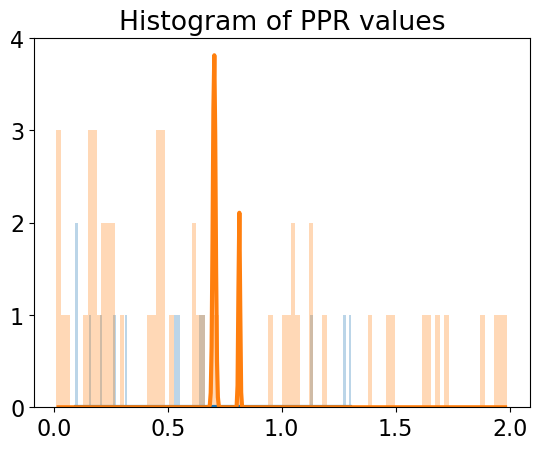

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1
<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


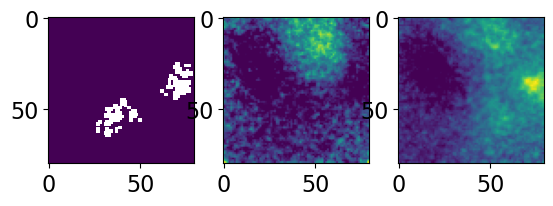

[3, 11]
              params          sigma
mu1     7.000000e-01  173965.522349
sigma1  2.000000e-02  174903.836088
A1     -3.849835e-17       0.317762
mu2     8.000000e-01  169249.456648
sigma2  2.000000e-02  170164.776733
A2      5.976938e-17       0.317764


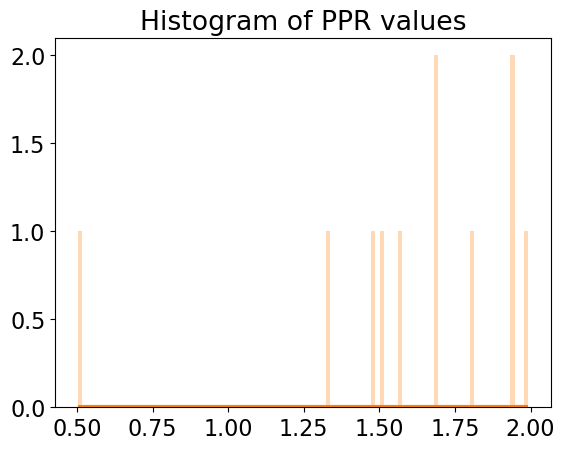

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1
<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


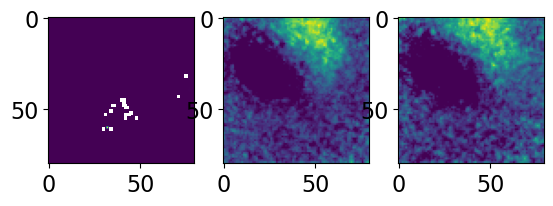

[166, 173]
          params     sigma
mu1     0.697740  0.022299
sigma1 -0.015199  0.023076
A1     -0.939221  1.208563
mu2     1.258337  0.035581
sigma2  0.337944  0.038905
A2      2.907822  0.259758
          params     sigma
mu1     1.220723  0.039106
sigma1  0.068649  0.042904
A1     -1.258941  0.641659
mu2     0.894381  0.078950
sigma2  0.668733  0.096804
A2      2.513562  0.258558


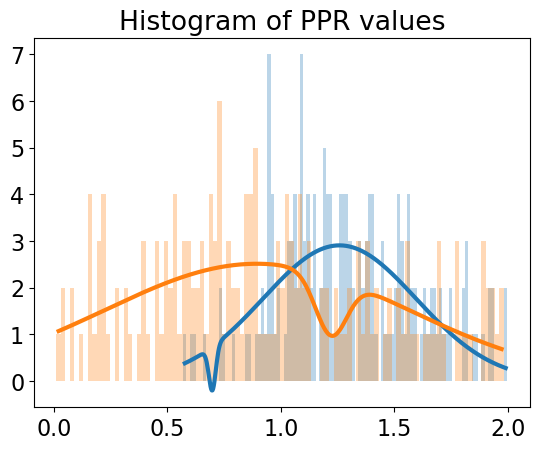

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1
<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


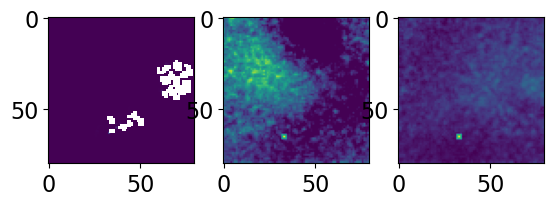

[0, 100]
          params     sigma
mu1     1.799011  0.441831
sigma1  0.769589  0.414278
A1      1.321570  0.183676
mu2     0.749729       NaN
sigma2 -0.002948       NaN
A2     -7.380681       NaN


<ipython-input-84-e21b85474538>:129: RuntimeWarning: invalid value encountered in sqrt
  sigma=np.sqrt(np.diag(cov))


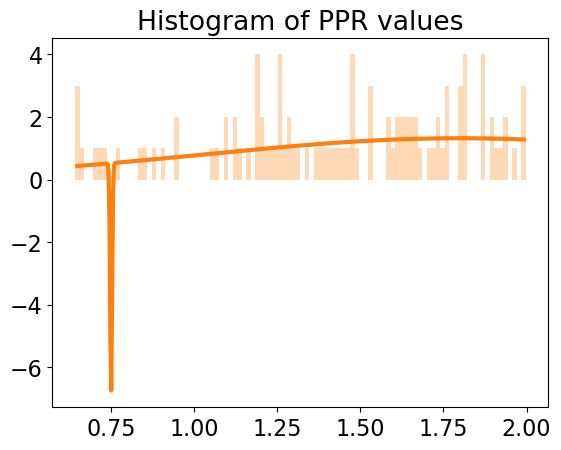

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1
<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


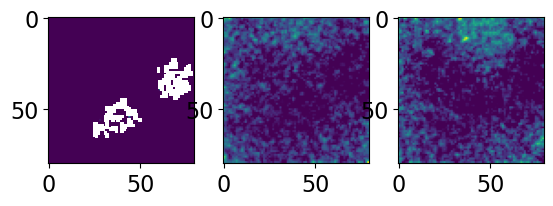

[25, 45]
          params  sigma
mu1     0.690611    inf
sigma1 -0.000723    inf
A1     -0.460312    inf
mu2     0.645528    inf
sigma2  0.747806    inf
A2      0.318468    inf


c:\Users\jjudge3\AppData\Local\anaconda3\envs\TSM-to-ZDA\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


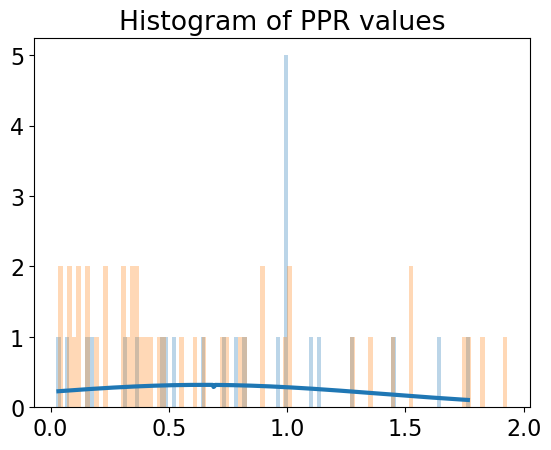

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1
<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


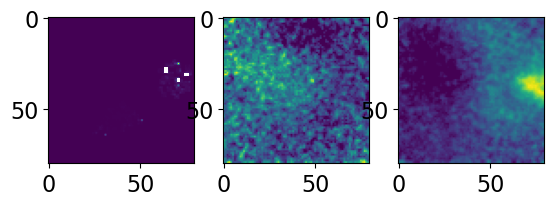

[0, 141]


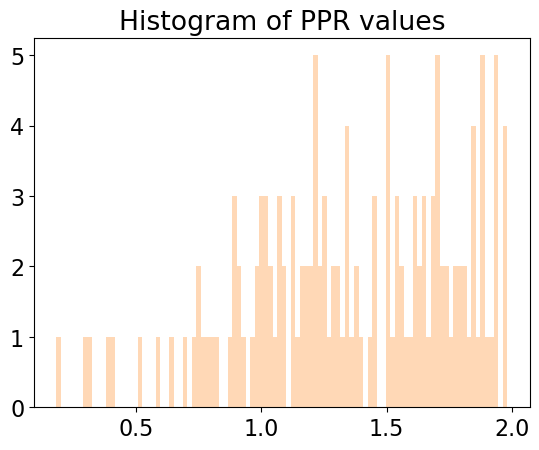

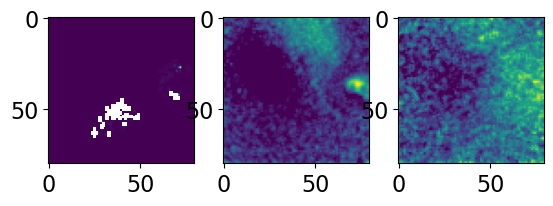

[86, 70]
          params     sigma
mu1     0.658781  0.058099
sigma1  0.307224  0.063601
A1      1.709166  0.260502
mu2     0.791349  0.013369
sigma2 -0.023460  0.014393
A2     -1.559506  0.790616
          params         sigma
mu1     0.679277  3.504091e+02
sigma1 -0.003817  7.636602e+02
A1      9.223018  7.940254e+06
mu2     2.356163  1.734749e+00
sigma2 -1.088297  9.241895e-01
A2      1.206710  8.071674e-01


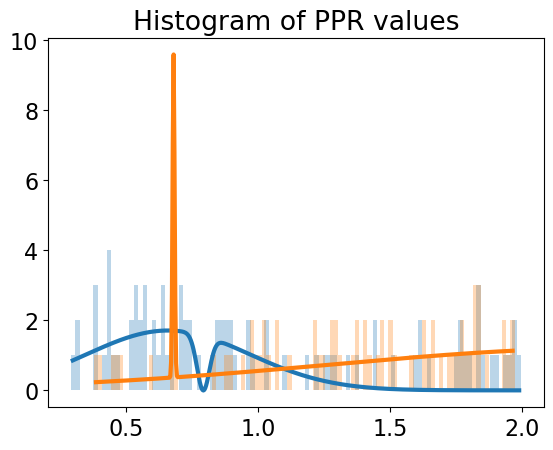

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


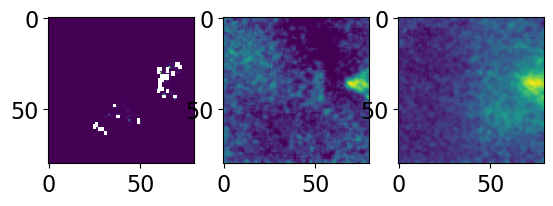

[25, 19]
        params  sigma
mu1       0.70    inf
sigma1    0.02    inf
A1       25.00    inf
mu2       0.80    inf
sigma2    0.02    inf
A2       15.00    inf


c:\Users\jjudge3\AppData\Local\anaconda3\envs\TSM-to-ZDA\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\Users\jjudge3\AppData\Local\anaconda3\envs\TSM-to-ZDA\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


        params  sigma
mu1       0.70    inf
sigma1    0.02    inf
A1       25.00    inf
mu2       0.80    inf
sigma2    0.02    inf
A2       15.00    inf


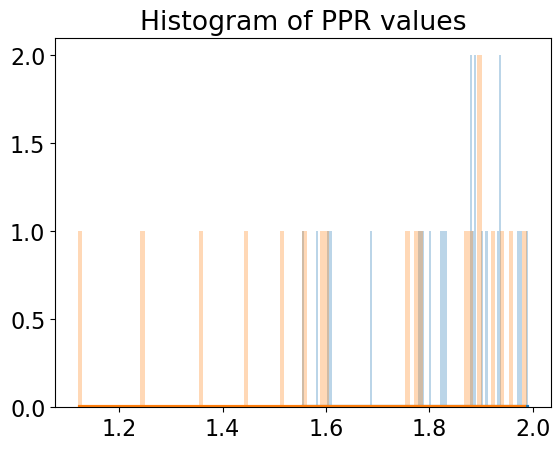

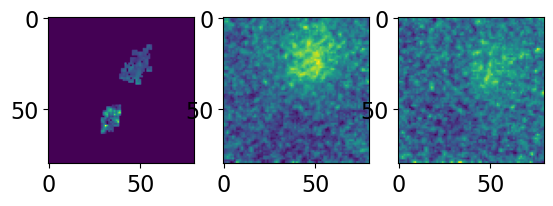

[204, 126]
          params     sigma
mu1     0.545006  0.004983
sigma1  0.032886  0.005986
A1      4.776085  0.688414
mu2     0.681748  0.019676
sigma2  0.160113  0.014989
A2      3.744100  0.324104
          params     sigma
mu1     0.791277  0.054188
sigma1  0.351999  0.067256
A1      2.361256  0.299430
mu2     1.733260  0.167103
sigma2  0.177408  0.206778
A2      0.616179  0.414164


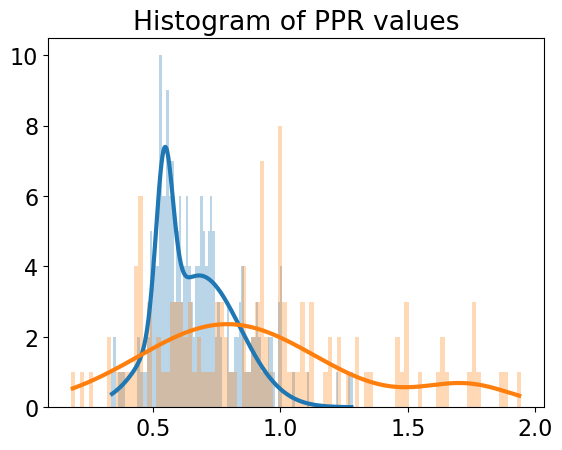

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1
<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


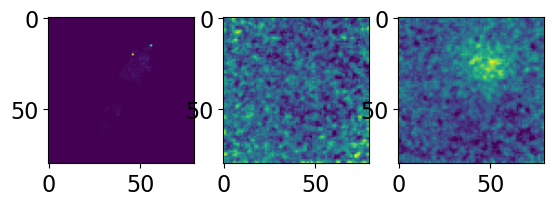

[22, 105]
        params  sigma
mu1       0.70    inf
sigma1    0.02    inf
A1       25.00    inf
mu2       0.80    inf
sigma2    0.02    inf
A2       15.00    inf
          params     sigma
mu1     0.699963  0.082682
sigma1  0.274569  0.215318
A1      1.846885  3.559374
mu2     1.271205  2.265968
sigma2  0.494995  1.298275
A2      0.669605  1.326291


c:\Users\jjudge3\AppData\Local\anaconda3\envs\TSM-to-ZDA\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


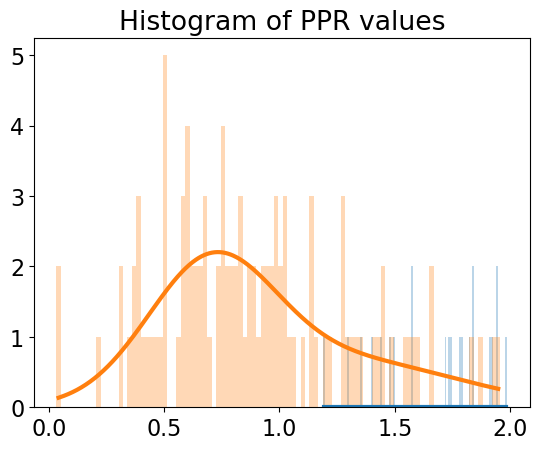

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1
<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


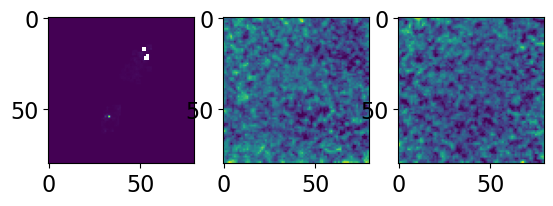

[183, 112]
          params     sigma
mu1     0.727473  0.027036
sigma1  0.125642  0.034474
A1      2.847975  0.652658
mu2     1.039716  0.084334
sigma2  0.417073  0.054239
A2      2.616701  0.431877
          params     sigma
mu1     0.708977  0.043950
sigma1  0.377242  0.047337
A1      2.254963  0.226691
mu2     1.699468  0.043154
sigma2 -0.052663  0.043472
A2      0.838943  0.595183


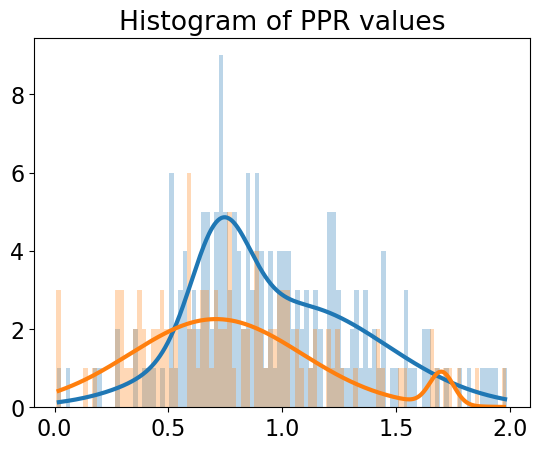

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


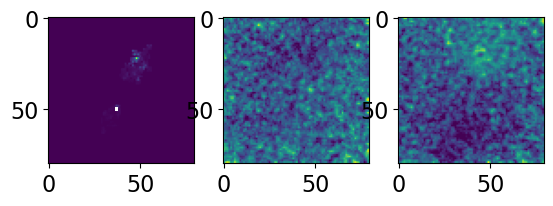

[80, 108]
          params     sigma
mu1     0.705448  0.049449
sigma1  0.020103  0.050735
A1     -0.347938  0.747720
mu2     1.760070  0.185390
sigma2  0.551811  0.151213
A2      1.651352  0.169816


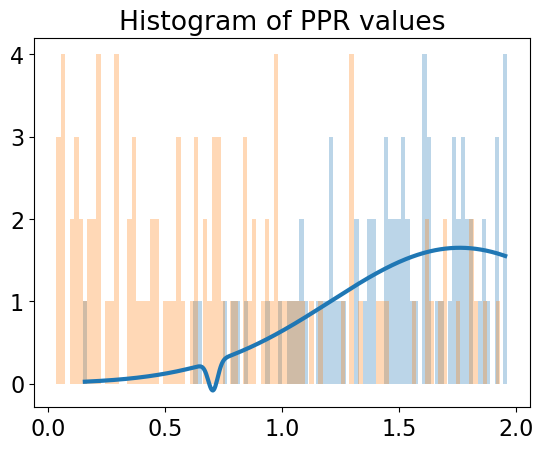

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


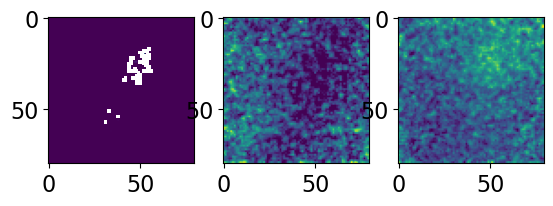

[7, 90]
          params  sigma
mu1     0.703866    inf
sigma1  0.000130    inf
A1      1.909544    inf
mu2     0.992788    inf
sigma2  0.570169    inf
A2      1.261757    inf


c:\Users\jjudge3\AppData\Local\anaconda3\envs\TSM-to-ZDA\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


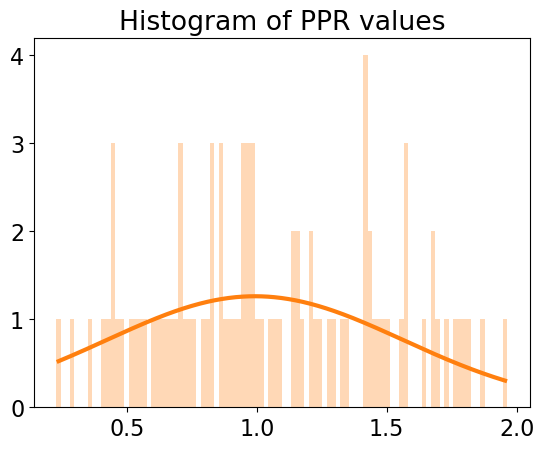

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1
<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


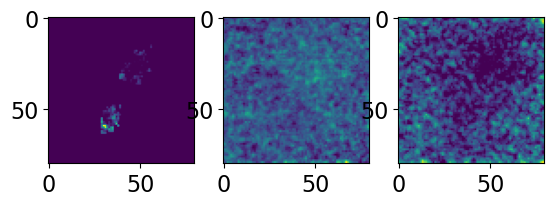

[85, 107]
           params         sigma
mu1     -1.227944  3.430761e+00
sigma1   0.526851  6.427217e-01
A1      51.464939  4.444154e+02
mu2      0.794688  4.801569e-01
sigma2   0.002000  4.910495e+02
A2       7.241655  7.125756e+06


<ipython-input-84-e21b85474538>:129: RuntimeWarning: invalid value encountered in sqrt
  sigma=np.sqrt(np.diag(cov))


          params         sigma
mu1     0.711589  9.562420e-03
sigma1  0.017119  9.375481e-03
A1      3.720343  1.779063e+00
mu2     0.796151           NaN
sigma2  0.001714           NaN
A2      3.475131  3.518558e+08


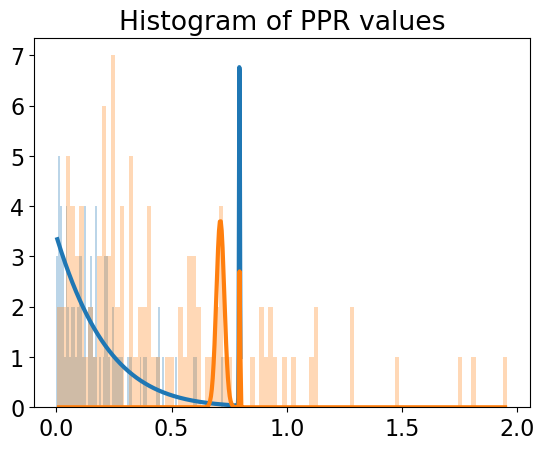

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1
<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


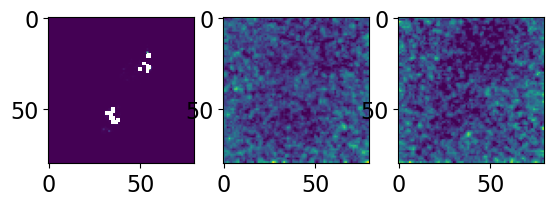

[136, 79]
          params     sigma
mu1     0.330901  0.144116
sigma1  0.527130  0.130124
A1      2.344620  0.250265
mu2     0.796021       NaN
sigma2 -0.002421       NaN
A2      1.420157       NaN
          params         sigma
mu1     0.708807  4.350368e-01
sigma1 -0.005141  2.649295e+02
A1      6.671020  1.262678e+06
mu2     0.525106  4.022326e-01
sigma2  1.021372  4.718775e-01
A2      0.966147  1.317033e-01


<ipython-input-84-e21b85474538>:129: RuntimeWarning: invalid value encountered in sqrt
  sigma=np.sqrt(np.diag(cov))


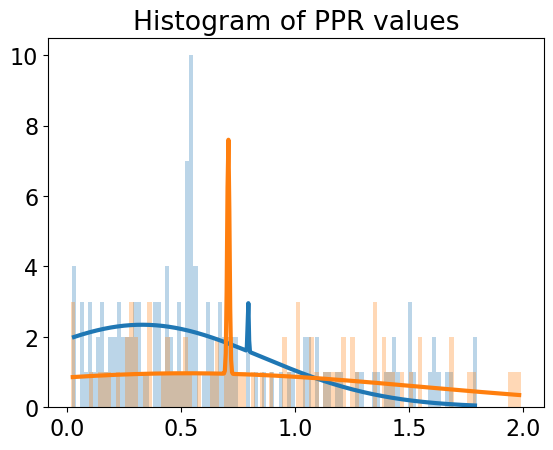

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


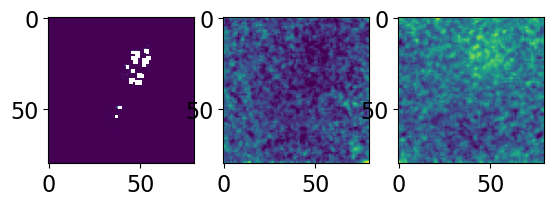

[4, 84]
          params     sigma
mu1     0.716692  0.020650
sigma1  0.024503  0.021273
A1     -0.902645  0.665842
mu2     1.367408  0.138493
sigma2  0.671186  0.159584
A2      1.218723  0.137352


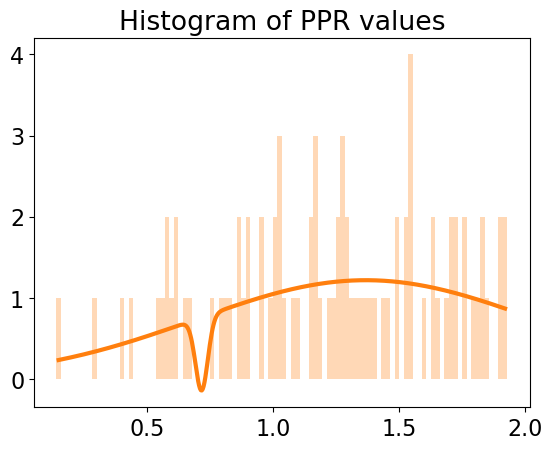

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


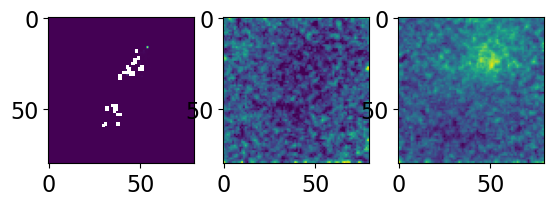

[3, 68]
          params         sigma
mu1     0.744138    886.313681
sigma1  0.003569    167.515254
A1      1.475909  16499.279827
mu2     1.492079      0.174383
sigma2  0.615372      0.178951
A2      1.099445      0.155629


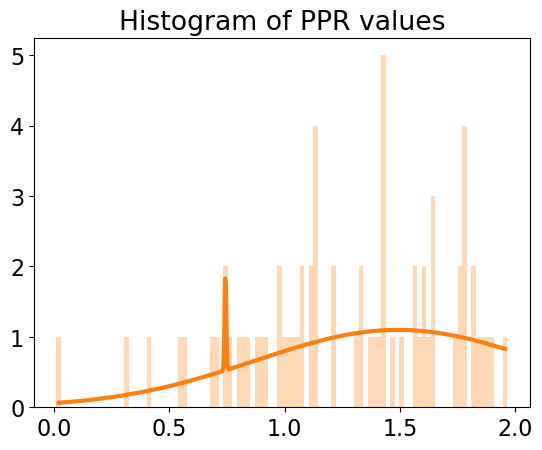

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1
<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


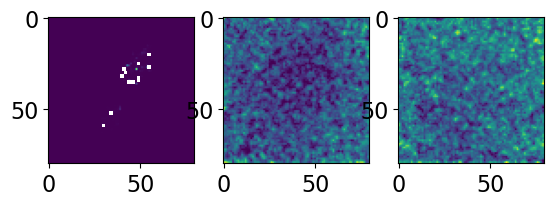

[84, 94]
          params     sigma
mu1     0.756463  0.008352
sigma1  0.013611  0.008478
A1      2.344274  1.254955
mu2     0.829775       NaN
sigma2  0.001358       NaN
A2      2.349024       NaN
          params     sigma
mu1     0.702962  0.009663
sigma1  0.019128  0.009889
A1      2.368560  1.045212
mu2     1.248490  0.179235
sigma2  0.735608  0.235238
A2      1.166333  0.188725


<ipython-input-84-e21b85474538>:129: RuntimeWarning: invalid value encountered in sqrt
  sigma=np.sqrt(np.diag(cov))


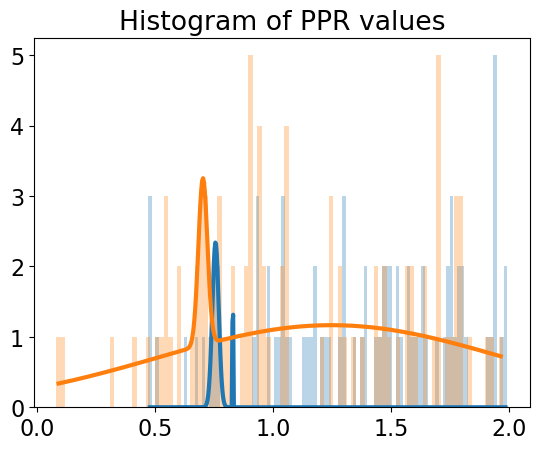

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1
<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


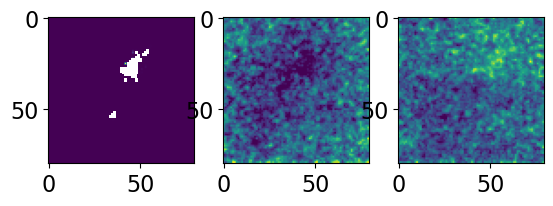

[28, 107]
          params     sigma
mu1     0.719693  0.039645
sigma1  0.021470  0.035349
A1      0.574781  0.494839
mu2     0.780356  0.039614
sigma2  0.021443  0.035303
A2      0.574682  0.495383
          params     sigma
mu1     0.806444  0.065470
sigma1  0.409453  0.054512
A1      2.021966  0.263020
mu2     0.527755  0.068531
sigma2  0.073200  0.079428
A2     -0.630612  0.542584


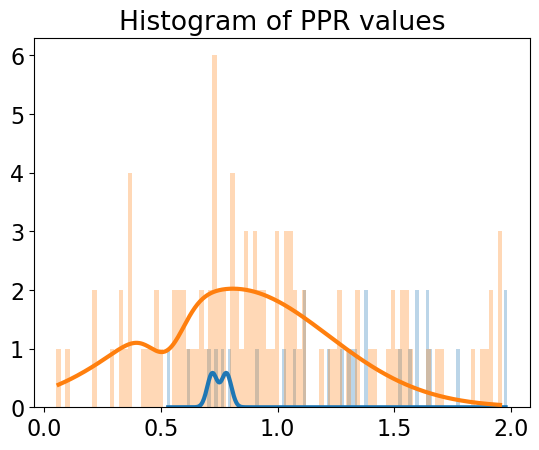

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1
<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


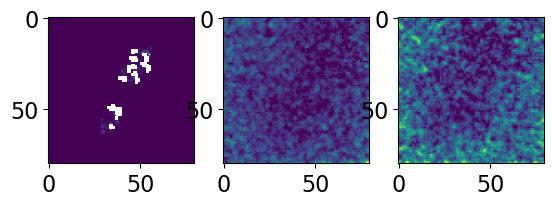

[104, 77]
          params     sigma
mu1     0.442211  0.051641
sigma1 -0.091564  0.058390
A1      0.874091  0.440461
mu2     0.542242  0.394206
sigma2  1.009063  0.488044
A2      1.132976  0.208361
          params     sigma
mu1     0.516091  0.277837
sigma1  0.810660  0.307864
A1      1.023071  0.148812
mu2     0.817787       NaN
sigma2 -0.003093       NaN
A2      4.983931       NaN


<ipython-input-84-e21b85474538>:129: RuntimeWarning: invalid value encountered in sqrt
  sigma=np.sqrt(np.diag(cov))


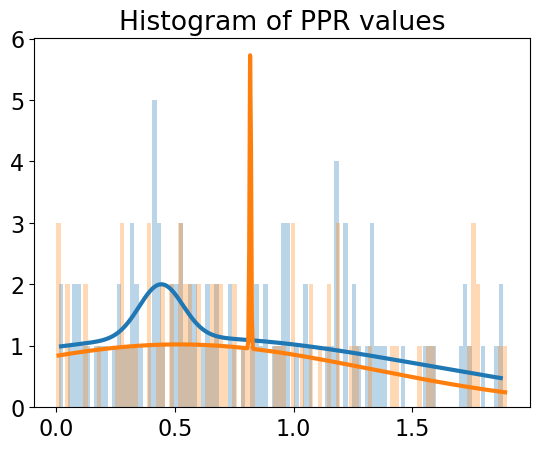

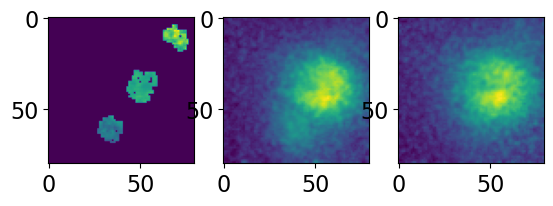

[133, 211, 147]
           params         sigma
mu1      1.114325  1.753595e-02
sigma1  -0.151248  1.869696e-02
A1       2.429190  2.424544e-01
mu2      0.822062  1.240696e+05
sigma2   0.001489  1.851797e+04
A2      23.803172  3.274152e+09
          params     sigma
mu1     0.606251  0.009451
sigma1  0.082753  0.010942
A1      3.476599  0.310234
mu2     0.825451  0.063960
sigma2  0.046781  0.064850
A2      0.391636  0.399089


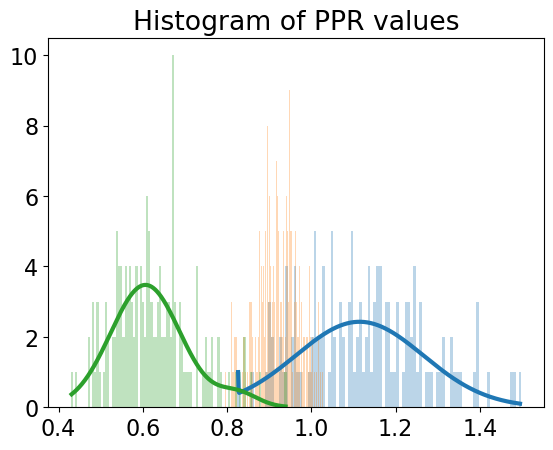

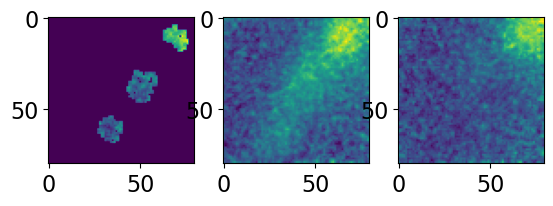

[133, 211, 147]
          params     sigma
mu1     0.753856  0.036898
sigma1  0.078286  0.026764
A1      2.597076  0.439292
mu2     0.927357  0.059155
sigma2  0.066923  0.038860
A2      1.374956  0.670629
           params     sigma
mu1      0.700735       NaN
sigma1   0.000822       NaN
A1      14.823215       NaN
mu2      0.391158  0.013472
sigma2  -0.131928  0.015072
A2       3.544876  0.303901
              params  sigma
mu1     6.843303e-01    NaN
sigma1  2.030534e-03    NaN
A1      5.259251e+02    NaN
mu2     2.100693e+06    NaN
sigma2  3.235831e+05    NaN
A2      2.077547e+09    NaN


<ipython-input-84-e21b85474538>:129: RuntimeWarning: invalid value encountered in sqrt
  sigma=np.sqrt(np.diag(cov))
<ipython-input-84-e21b85474538>:129: RuntimeWarning: invalid value encountered in sqrt
  sigma=np.sqrt(np.diag(cov))


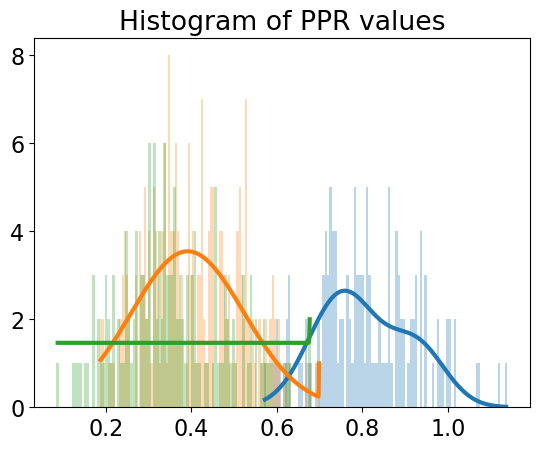

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


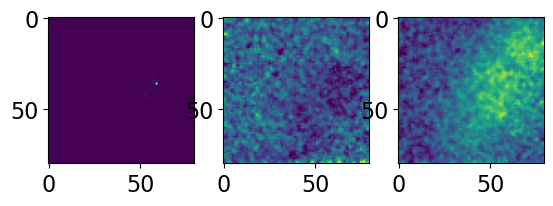

[2, 1, 43]
           params       sigma
mu1      0.704529         NaN
sigma1   0.007042         NaN
A1      75.615271         NaN
mu2      0.738071  446.911201
sigma2   0.018554  203.323621
A2      -0.000508    6.109754


<ipython-input-84-e21b85474538>:129: RuntimeWarning: invalid value encountered in sqrt
  sigma=np.sqrt(np.diag(cov))


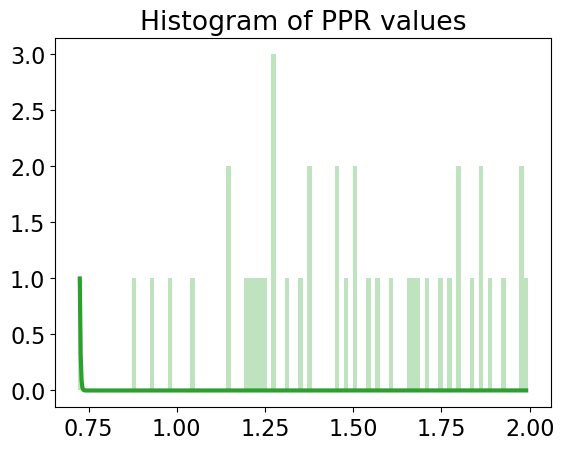

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


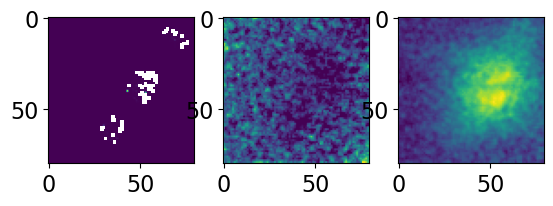

[0, 0, 0]


<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


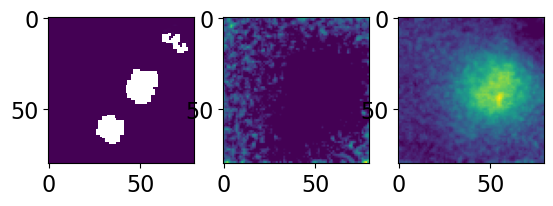

[45, 0, 0]


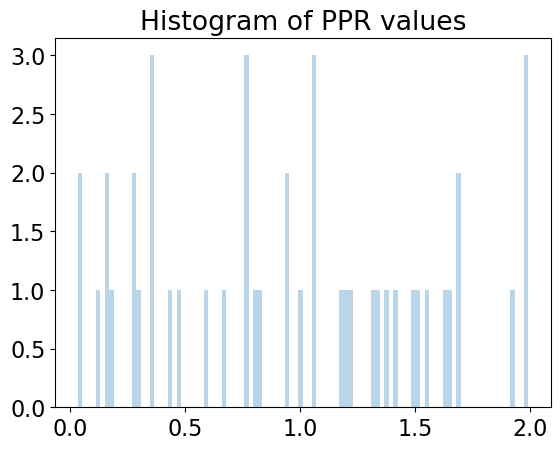

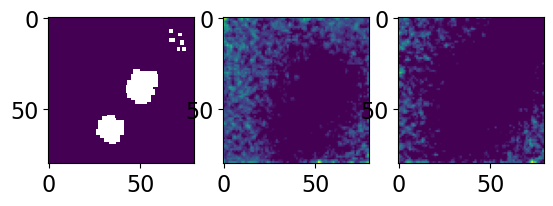

[0, 0, 0]


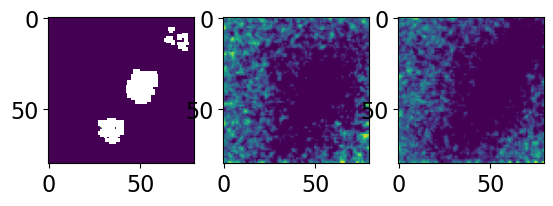

[1, 0, 4]


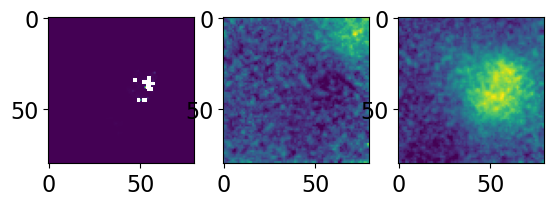

[133, 0, 78]
           params         sigma
mu1      0.629779      0.012073
sigma1   0.121049      0.012607
A1       4.149421      0.357629
mu2      0.876084      3.417724
sigma2  -0.002923      6.774104
A2      11.715103  84047.943126
          params     sigma
mu1     0.761086  0.039250
sigma1 -0.041101  0.041673
A1     -0.729144  0.614847
mu2     1.379267  0.146728
sigma2 -0.613911  0.172995
A2      1.167337  0.169383


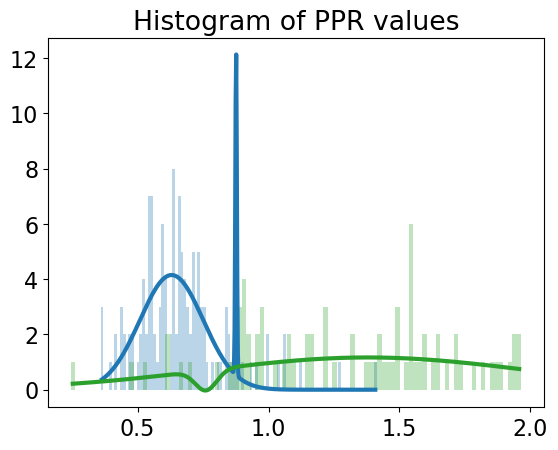

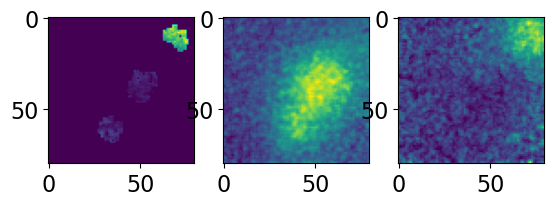

[133, 209, 144]
             params         sigma
mu1        0.740023  7.144191e+05
sigma1     0.003351  6.552823e+04
A1      5765.497117  3.162456e+12
mu2        0.801114  3.581058e+01
sigma2     0.002243  9.954562e+01
A2         9.196441  1.501769e+06


c:\Users\jjudge3\AppData\Local\anaconda3\envs\TSM-to-ZDA\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\Users\jjudge3\AppData\Local\anaconda3\envs\TSM-to-ZDA\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


        params  sigma
mu1       0.70    inf
sigma1    0.02    inf
A1       25.00    inf
mu2       0.80    inf
sigma2    0.02    inf
A2       15.00    inf
        params  sigma
mu1       0.70    inf
sigma1    0.02    inf
A1       25.00    inf
mu2       0.80    inf
sigma2    0.02    inf
A2       15.00    inf


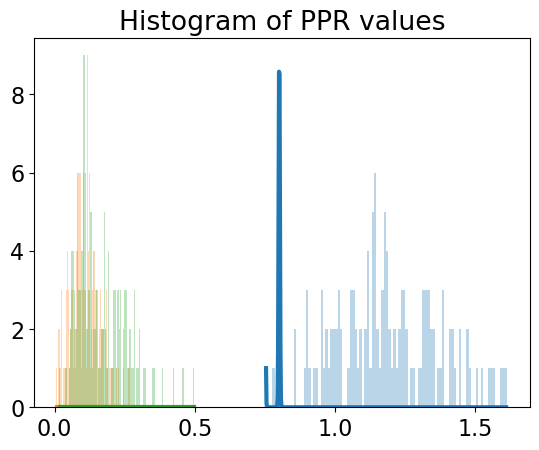

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


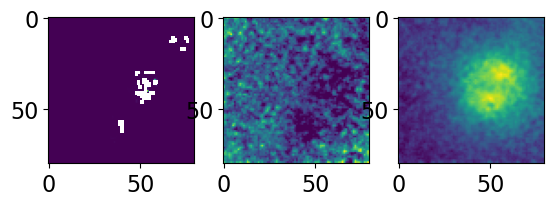

[0, 0, 11]
        params  sigma
mu1       0.70    inf
sigma1    0.02    inf
A1       25.00    inf
mu2       0.80    inf
sigma2    0.02    inf
A2       15.00    inf


c:\Users\jjudge3\AppData\Local\anaconda3\envs\TSM-to-ZDA\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


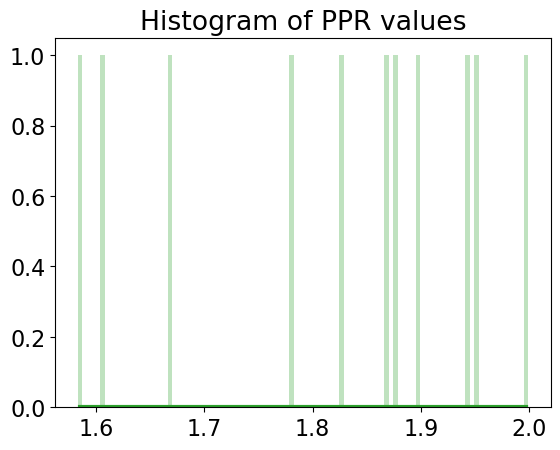

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


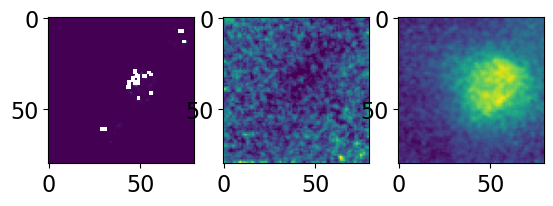

[0, 0, 2]


<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


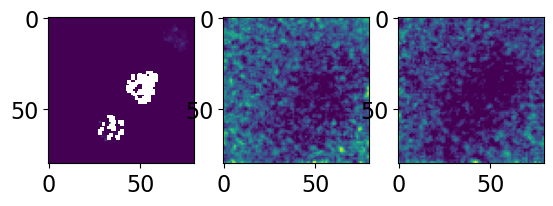

[123, 19, 60]
          params         sigma
mu1     0.697616  6.048466e+01
sigma1 -0.004813  2.836639e+03
A1      6.248297  1.516463e+07
mu2     0.567295  5.720370e-02
sigma2  0.410028  6.434389e-02
A2      2.337042  2.743259e-01
              params         sigma
mu1     7.094997e-01  1.714680e+10
sigma1 -4.446540e-03  9.379044e+09
A1      1.176350e-10  5.383754e+02
mu2     8.003951e-01  2.036351e+10
sigma2  1.946008e-02  2.036601e+10
A2     -5.513351e-13  4.996541e-01


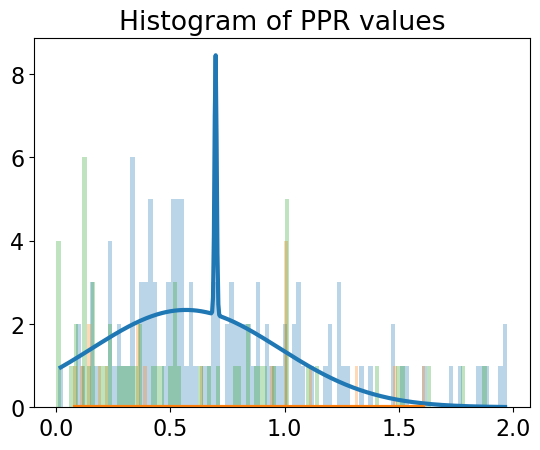

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1
<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


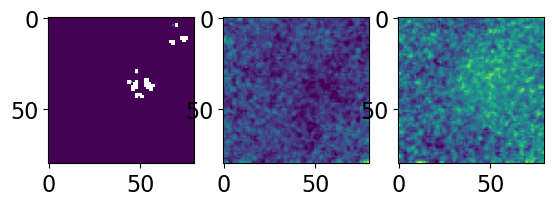

[55, 6, 114]
          params          sigma
mu1     0.747104      33.637468
sigma1 -0.003608     102.865781
A1     -2.057014  175569.789317
mu2     0.769260       0.062235
sigma2  0.022534       0.031764
A2      0.694297       1.586390
          params     sigma
mu1     0.589602  0.020814
sigma1  0.021321  0.021823
A1     -0.957280  0.822349
mu2     1.088415  0.080148
sigma2 -0.556582  0.100787
A2      1.603971  0.172137


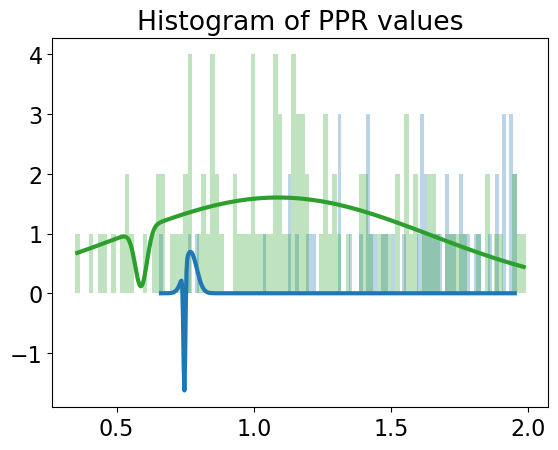

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1
<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


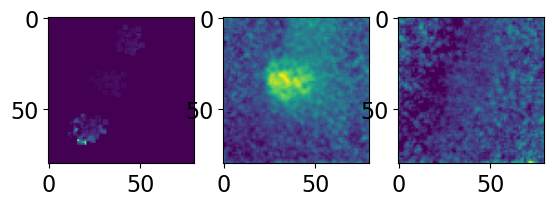

[148, 170, 211]
              params  sigma
mu1    -3.025828e+05    inf
sigma1  4.644474e+04    inf
A1      2.436905e+09    inf
mu2     8.000000e-01    inf
sigma2  2.000000e-02    inf
A2      1.500000e+01    inf
        params  sigma
mu1       0.70    inf
sigma1    0.02    inf
A1       25.00    inf
mu2       0.80    inf
sigma2    0.02    inf
A2       15.00    inf
          params     sigma
mu1     0.368489  0.038954
sigma1  0.232679  0.037609
A1      5.426329  0.742342
mu2     1.104480  0.324418
sigma2 -0.373743  0.280536
A2      1.126520  0.326613


c:\Users\jjudge3\AppData\Local\anaconda3\envs\TSM-to-ZDA\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\Users\jjudge3\AppData\Local\anaconda3\envs\TSM-to-ZDA\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


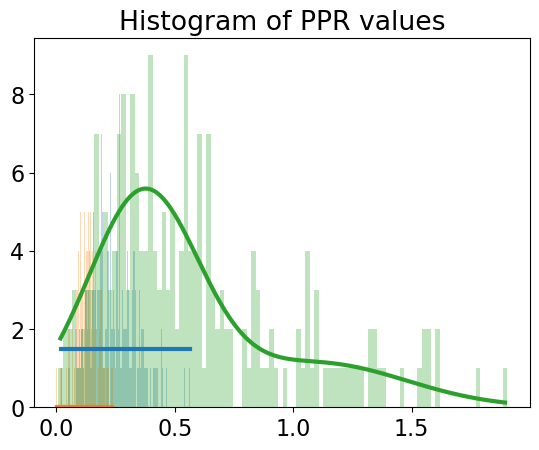

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1
<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


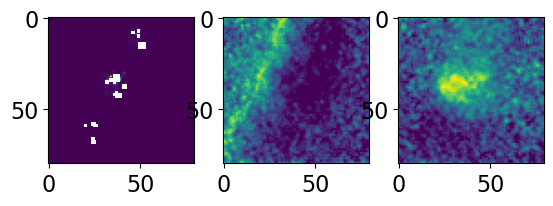

[38, 17, 185]


c:\Users\jjudge3\AppData\Local\anaconda3\envs\TSM-to-ZDA\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\Users\jjudge3\AppData\Local\anaconda3\envs\TSM-to-ZDA\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


        params  sigma
mu1       0.70    inf
sigma1    0.02    inf
A1       25.00    inf
mu2       0.80    inf
sigma2    0.02    inf
A2       15.00    inf
        params  sigma
mu1       0.70    inf
sigma1    0.02    inf
A1       25.00    inf
mu2       0.80    inf
sigma2    0.02    inf
A2       15.00    inf
          params     sigma
mu1     0.431118  0.128823
sigma1  0.595051  0.097161
A1      3.543560  0.294823
mu2     1.023503  0.087503
sigma2  0.150856  0.108694
A2     -1.025724  0.598127


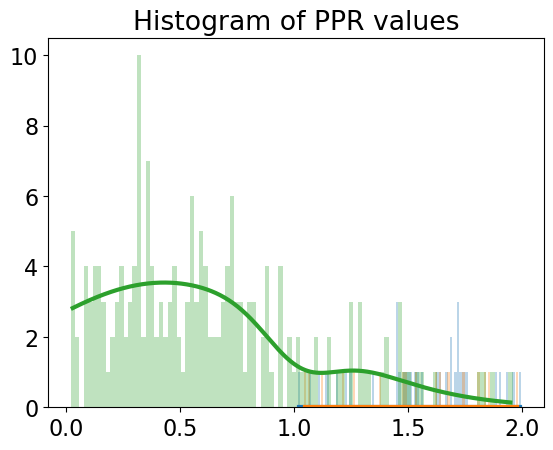

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1
<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


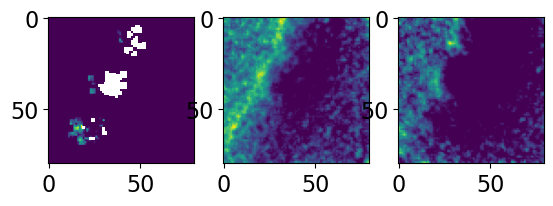

[12, 23, 110]
              params         sigma
mu1     7.087536e-01  3.939442e+08
sigma1 -5.023292e-03  2.590250e+08
A1      1.100947e-11  4.440837e-01
mu2     8.004533e-01  4.916980e+10
sigma2  1.937984e-02  4.916985e+10
A2     -1.053771e-13  2.315397e-01
          params     sigma
mu1     0.491412  0.121599
sigma1  0.292735  0.165321
A1      0.269615  0.082178
mu2     0.801434  0.003902
sigma2  0.007824  0.004022
A2      1.053439  0.459233
          params     sigma
mu1     0.283195  0.146214
sigma1  0.510657  0.130252
A1      1.822666  0.193439
mu2     0.508404  0.006506
sigma2 -0.011427  0.006559
A2      2.400380  1.170162


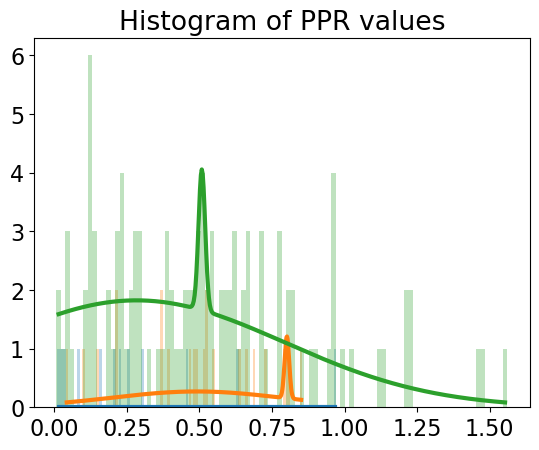

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1
<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


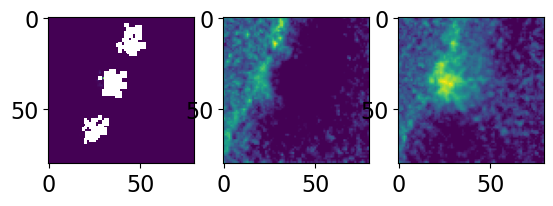

[6, 4, 108]
          params     sigma
mu1     0.492600  0.019229
sigma1  0.038564  0.020298
A1      1.444907  0.634985
mu2     0.489023  0.188445
sigma2  0.734988  0.191287
A2      1.492286  0.180001


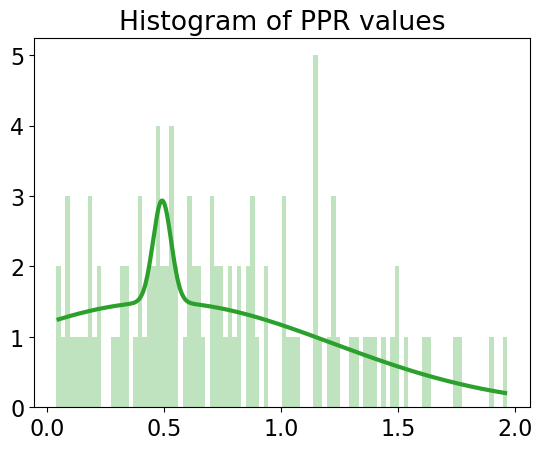

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


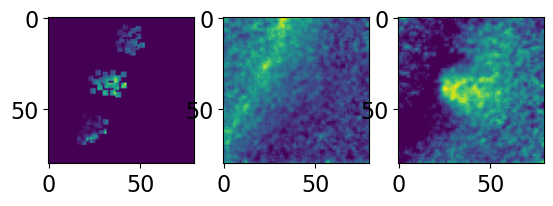

[148, 114, 162]
          params     sigma
mu1     0.761518  0.046539
sigma1  0.369258  0.052252
A1      2.871778  0.340876
mu2     0.827144  0.006151
sigma2 -0.017496  0.006392
A2      4.466251  1.377267
          params          sigma
mu1     0.647431      13.825691
sigma1  0.004858      21.546014
A1      8.658783  122378.261481
mu2     0.812708       0.022534
sigma2  0.074012       0.023830
A2      2.620596       0.682355
          params      sigma
mu1     0.078542   3.607162
sigma1  0.610870   1.636519
A1      6.876750  29.267375
mu2     0.514984   1.065964
sigma2 -0.351657   0.937357
A2     -3.229496  37.822875


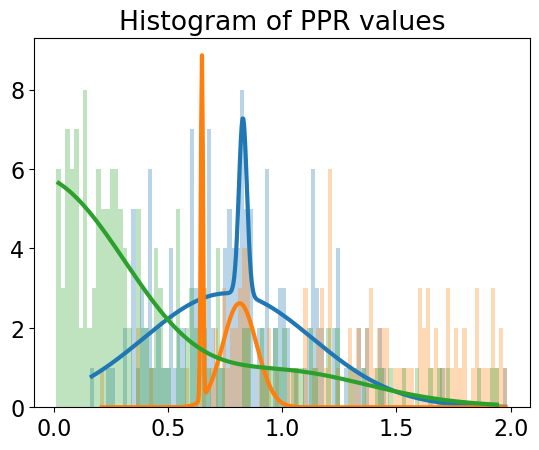

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1
<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


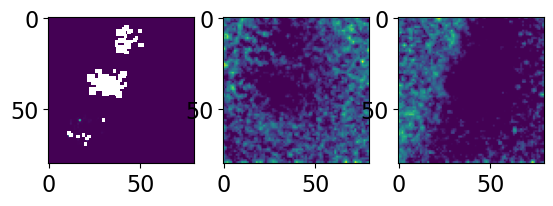

[4, 2, 131]


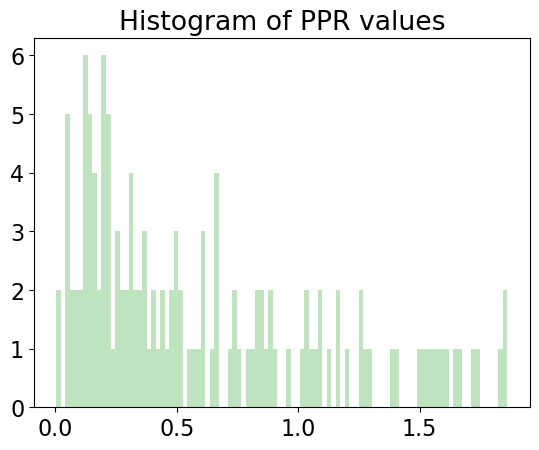

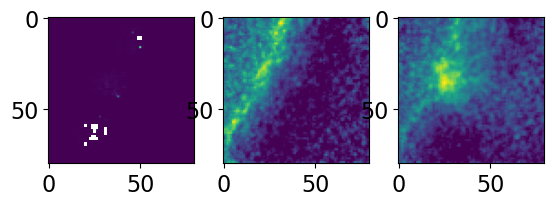

[54, 9, 163]
        params  sigma
mu1       0.70    inf
sigma1    0.02    inf
A1       25.00    inf
mu2       0.80    inf
sigma2    0.02    inf
A2       15.00    inf


c:\Users\jjudge3\AppData\Local\anaconda3\envs\TSM-to-ZDA\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


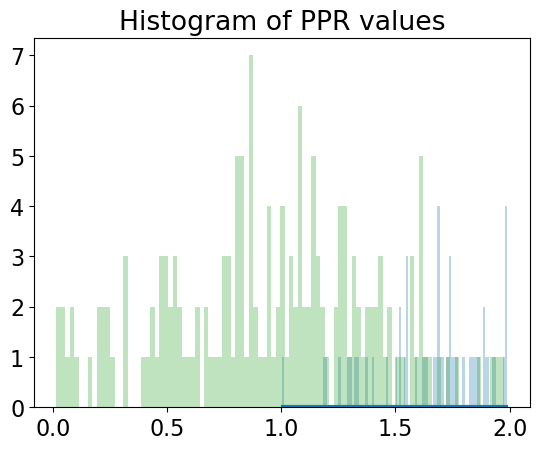

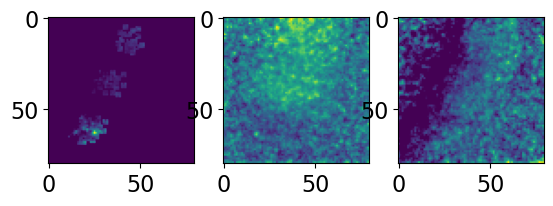

[148, 155, 197]
          params  sigma
mu1     0.428298    inf
sigma1  0.148496    inf
A1      3.005311    inf
mu2     1.017067    inf
sigma2  0.013954    inf
A2     -0.144998    inf


c:\Users\jjudge3\AppData\Local\anaconda3\envs\TSM-to-ZDA\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
<ipython-input-84-e21b85474538>:129: RuntimeWarning: invalid value encountered in sqrt
  sigma=np.sqrt(np.diag(cov))


              params       sigma
mu1     6.579341e-01    0.141504
sigma1  2.830622e-03    0.233330
A1      2.904172e+00  279.953350
mu2    -5.137310e+07         NaN
sigma2 -4.026296e+06         NaN
A2      1.500000e+01         NaN
            params         sigma
mu1       0.742981  1.850572e+01
sigma1   -0.429065  1.469203e+01
A1      178.790145  1.124351e+06
mu2       0.748742  1.826101e+01
sigma2   -0.424453  1.473616e+01
A2     -176.366517  1.124351e+06


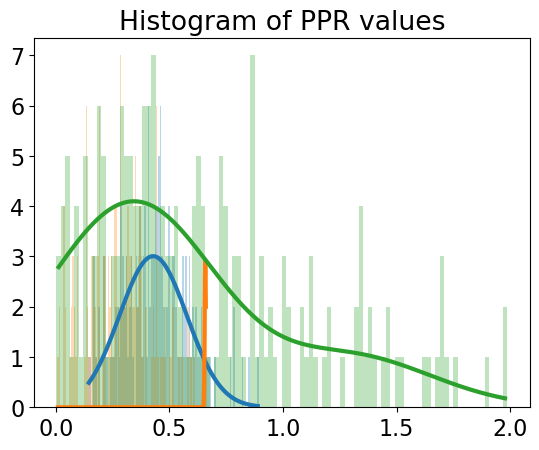

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1
<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


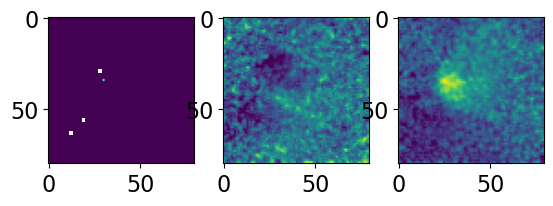

[116, 6, 218]
          params          sigma
mu1     0.695906            NaN
sigma1  0.001935  103659.712026
A1      1.021235            NaN
mu2     1.606157       0.083358
sigma2  0.492510       0.088216
A2      1.775099       0.150374
          params     sigma
mu1     0.717189  0.008846
sigma1  0.025086  0.009292
A1      3.568708  1.109429
mu2     0.781413  0.041048
sigma2  0.461693  0.047512
A2      3.551298  0.300087


<ipython-input-84-e21b85474538>:129: RuntimeWarning: invalid value encountered in sqrt
  sigma=np.sqrt(np.diag(cov))


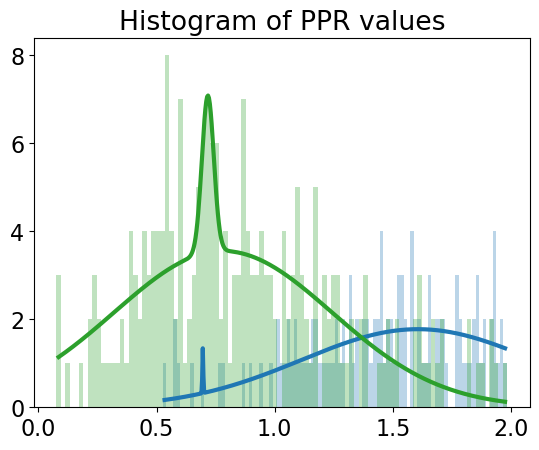

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1
<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


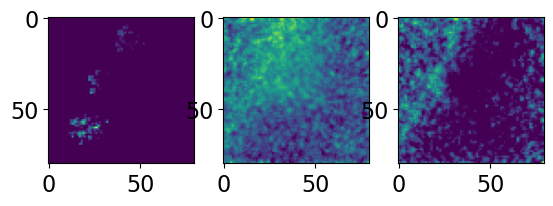

[67, 41, 138]
        params  sigma
mu1       0.70    inf
sigma1    0.02    inf
A1       25.00    inf
mu2       0.80    inf
sigma2    0.02    inf
A2       15.00    inf
          params        sigma
mu1     0.681305  2242.924239
sigma1 -0.018005  2255.028456
A1      0.000004     0.510828
mu2     0.791526   171.193507
sigma2 -0.011861   172.117385
A2     -0.000055     0.510825
          params     sigma
mu1    -0.027952  0.179582
sigma1  0.317839  0.118712
A1      4.688001  0.838150
mu2     0.802176  0.106902
sigma2  0.130257  0.108093
A2      0.556224  0.349432


c:\Users\jjudge3\AppData\Local\anaconda3\envs\TSM-to-ZDA\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


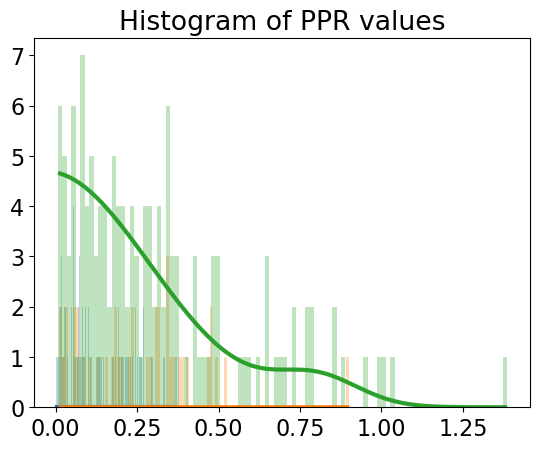

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


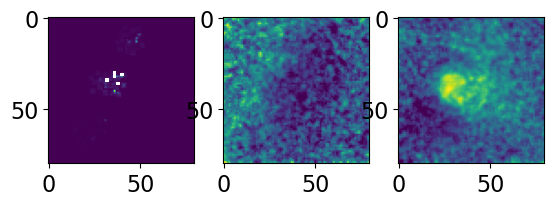

[18, 3, 216]
          params     sigma
mu1     0.454825  0.048240
sigma1  0.172197  0.109751
A1      2.688389  2.320189
mu2     0.873699  0.339088
sigma2  0.433658  0.185437
A2      2.766613  0.888877


<ipython-input-84-e21b85474538>:18: RuntimeWarning: overflow encountered in square
  return A*np.exp(-(x-mu)**2/2/sigma**2)
<ipython-input-84-e21b85474538>:18: RuntimeWarning: overflow encountered in double_scalars
  return A*np.exp(-(x-mu)**2/2/sigma**2)
<ipython-input-84-e21b85474538>:18: RuntimeWarning: invalid value encountered in true_divide
  return A*np.exp(-(x-mu)**2/2/sigma**2)


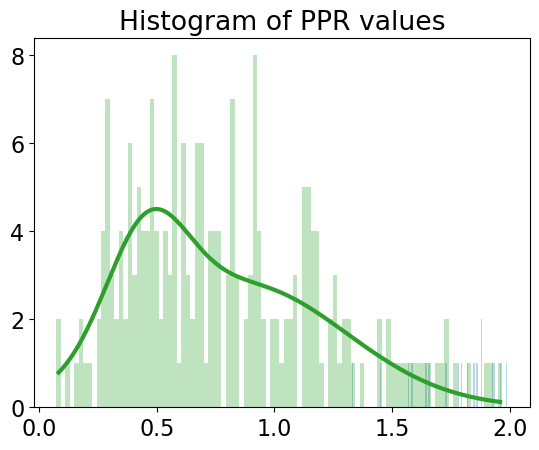

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1
<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


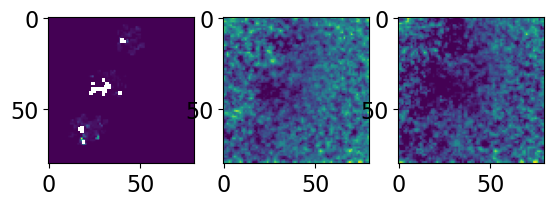

[124, 101, 180]
          params          sigma
mu1     0.631611     132.546294
sigma1  0.004535      76.007448
A1      9.024907  542453.235126
mu2     0.788239       0.101855
sigma2  0.488068       0.113345
A2      1.978446       0.360826


<ipython-input-84-e21b85474538>:129: RuntimeWarning: invalid value encountered in sqrt
  sigma=np.sqrt(np.diag(cov))


          params     sigma
mu1    -0.260080  0.672671
sigma1  0.612158  0.305123
A1      3.576973  1.943256
mu2     0.805169       NaN
sigma2  0.002159       NaN
A2      1.494158       NaN
           params       sigma
mu1     -0.140057    2.622071
sigma1  -0.474649    1.104080
A1     -19.925175  207.450199
mu2     -0.830756    5.298727
sigma2   0.872686    0.796839
A2      34.126949  437.802873


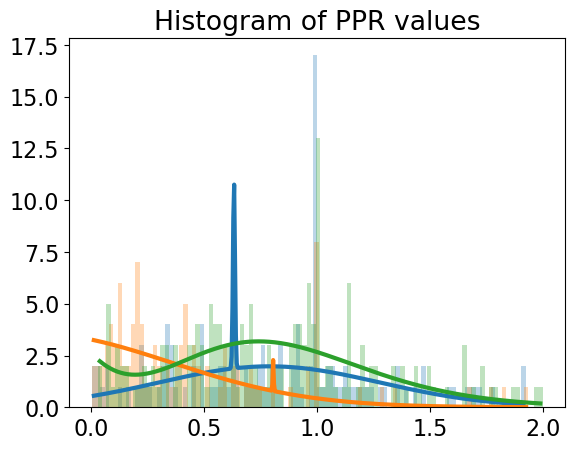

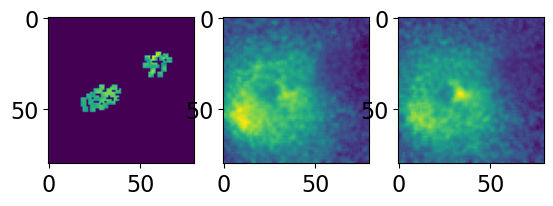

[121, 189]
           params         sigma
mu1      0.672512           NaN
sigma1  -0.001355  19037.384694
A1      49.837432           NaN
mu2      0.937434      0.013558
sigma2   0.126288      0.014041
A2       2.711439      0.251807


<ipython-input-84-e21b85474538>:129: RuntimeWarning: invalid value encountered in sqrt
  sigma=np.sqrt(np.diag(cov))
c:\Users\jjudge3\AppData\Local\anaconda3\envs\TSM-to-ZDA\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


              params  sigma
mu1     4.063567e+04    inf
sigma1 -2.511453e+03    inf
A1     -9.515964e+07    inf
mu2     9.383398e-01    inf
sigma2  1.420254e-01    inf
A2      2.495512e+00    inf


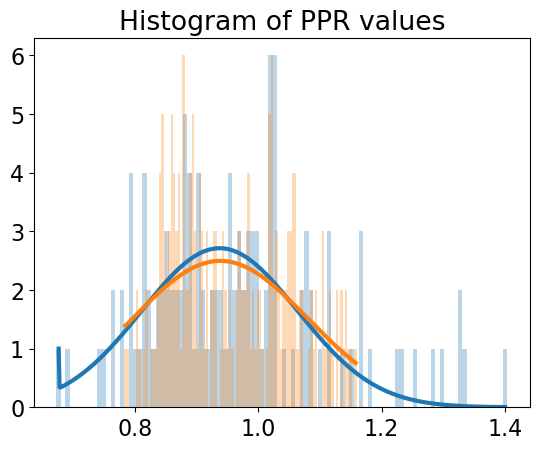

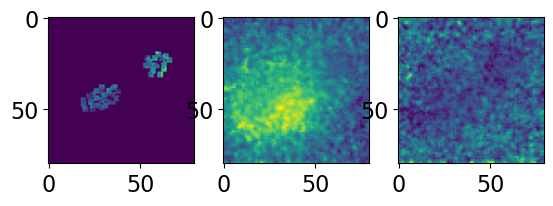

[121, 189]
           params  sigma
mu1      0.257817    inf
sigma1   0.083670    inf
A1       3.038595    inf
mu2      0.800000    inf
sigma2   0.020000    inf
A2      15.000000    inf
        params  sigma
mu1       0.70    inf
sigma1    0.02    inf
A1       25.00    inf
mu2       0.80    inf
sigma2    0.02    inf
A2       15.00    inf


c:\Users\jjudge3\AppData\Local\anaconda3\envs\TSM-to-ZDA\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\Users\jjudge3\AppData\Local\anaconda3\envs\TSM-to-ZDA\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


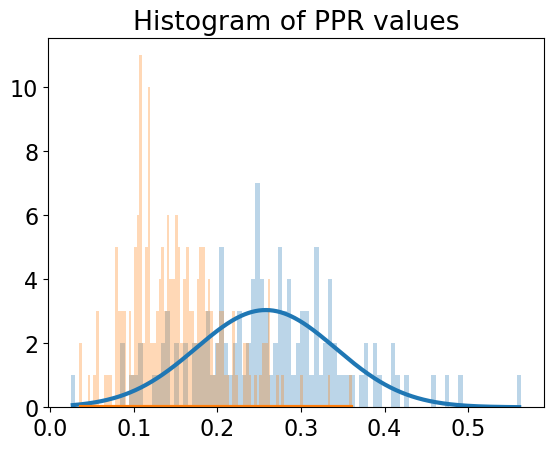

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1
<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


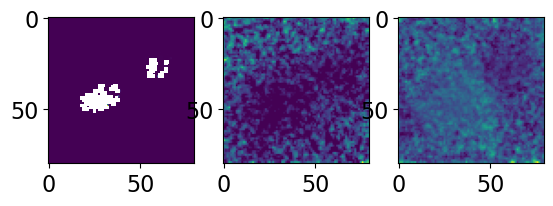

[33, 0]


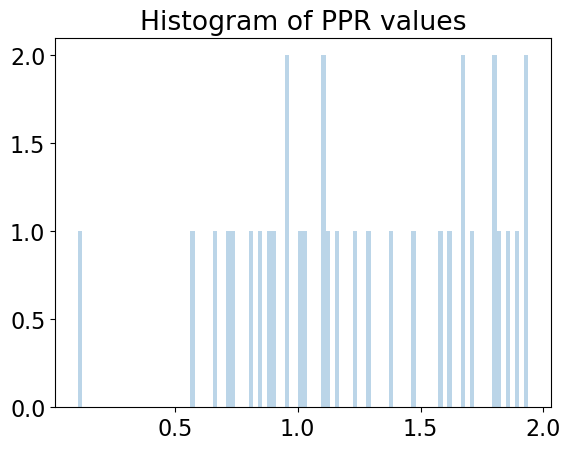

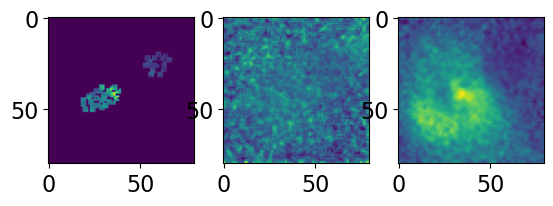

[79, 0]


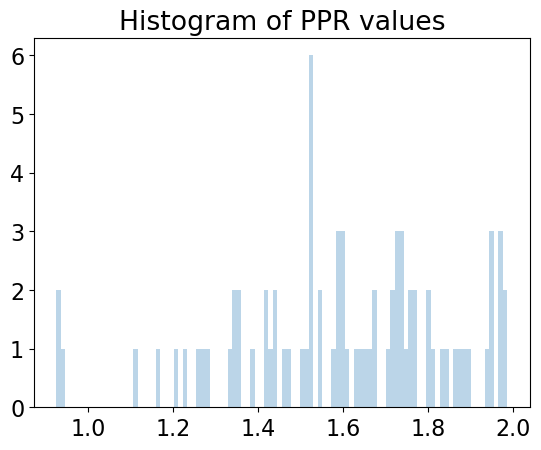

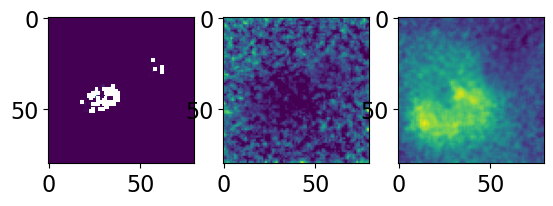

[23, 0]
        params  sigma
mu1       0.70    inf
sigma1    0.02    inf
A1       25.00    inf
mu2       0.80    inf
sigma2    0.02    inf
A2       15.00    inf


c:\Users\jjudge3\AppData\Local\anaconda3\envs\TSM-to-ZDA\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


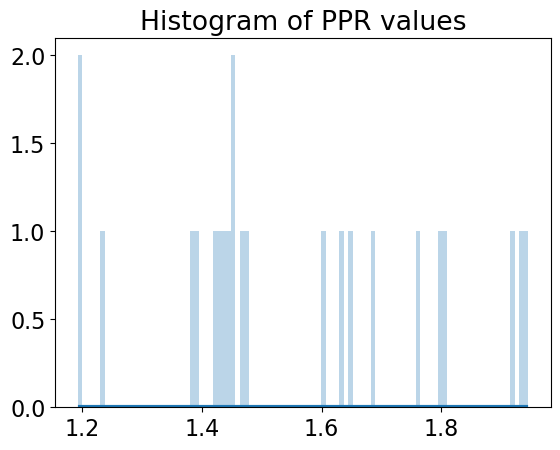

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


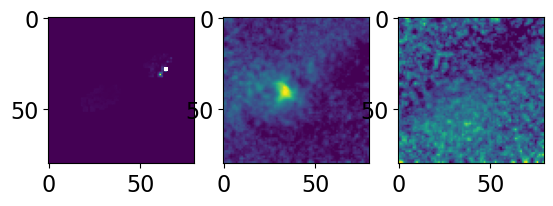

[95, 189]
            params         sigma
mu1       0.627078  1.216436e+01
sigma1    0.291477  1.021229e+01
A1     -154.419759  1.301167e+06
mu2       0.624194  1.229512e+01
sigma2   -0.293880  1.015766e+01
A2      155.681548  1.301167e+06


<ipython-input-84-e21b85474538>:129: RuntimeWarning: invalid value encountered in sqrt
  sigma=np.sqrt(np.diag(cov))


           params     sigma
mu1      0.299832  0.013531
sigma1   0.171701  0.015072
A1       3.521510  0.225574
mu2      0.791619       NaN
sigma2   0.001623       NaN
A2      48.646837       NaN


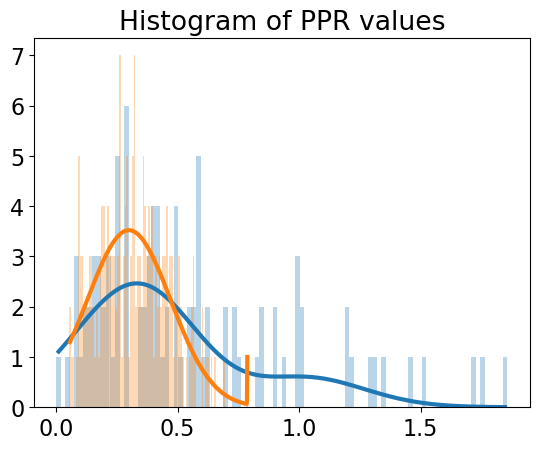

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


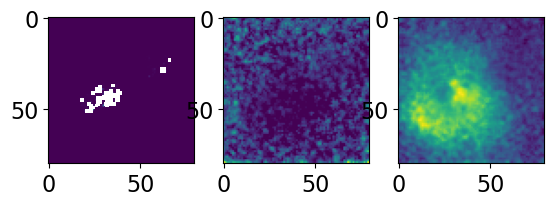

[0, 0]


<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


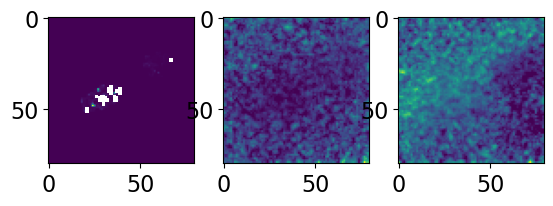

[78, 2]
          params          sigma
mu1     0.713692     658.384731
sigma1  0.004576     660.010381
A1     -0.239008  104287.421993
mu2     0.789498       0.013267
sigma2  0.027079       0.014558
A2      2.227394       0.920752


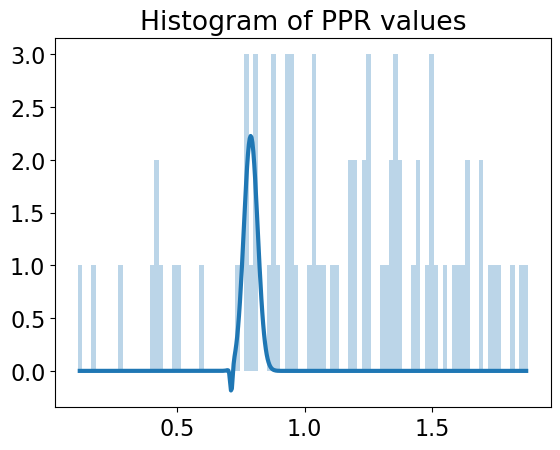

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1
<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


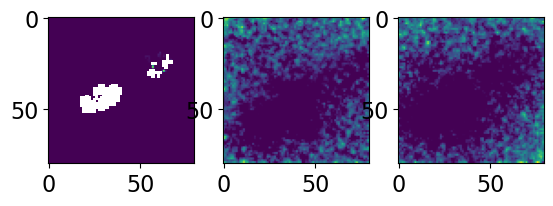

[29, 0]
             params         sigma
mu1      -11.607886  3.445232e+02
sigma1     2.766116  3.954055e+01
A1      4293.801797  1.164156e+06
mu2        0.687123           NaN
sigma2     0.002536           NaN
A2        -3.308286           NaN


<ipython-input-84-e21b85474538>:129: RuntimeWarning: invalid value encountered in sqrt
  sigma=np.sqrt(np.diag(cov))


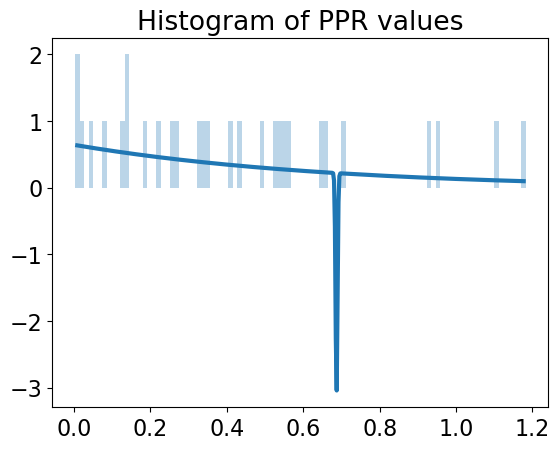

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


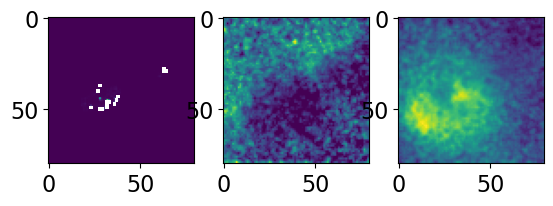

[45, 0]
              params         sigma
mu1     6.987774e-01           NaN
sigma1  6.699805e-03           NaN
A1      6.304713e+01           NaN
mu2     8.345935e-01  4.138058e+16
sigma2 -1.904576e-02  4.138063e+16
A2      5.273264e-20  5.975540e-01


<ipython-input-84-e21b85474538>:129: RuntimeWarning: invalid value encountered in sqrt
  sigma=np.sqrt(np.diag(cov))


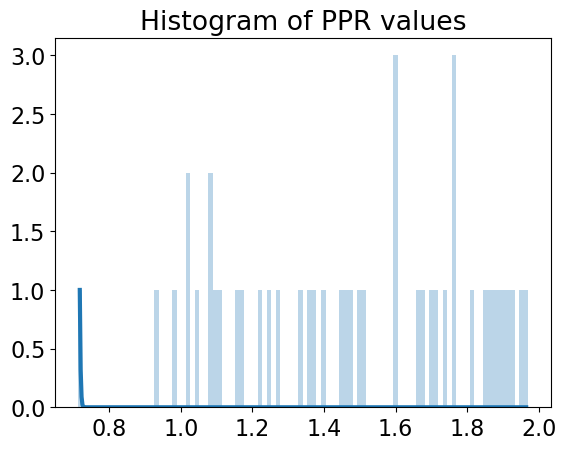

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1
<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


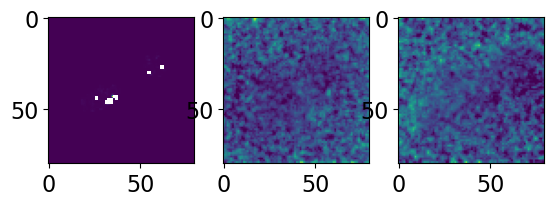

[93, 107]
          params     sigma
mu1     0.751201  0.069896
sigma1  0.480891  0.083017
A1      1.674508  0.239081
mu2     0.845685  0.017998
sigma2 -0.036577  0.019476
A2     -1.595407  0.700246
          params     sigma
mu1     1.383647  0.067998
sigma1 -0.437423  0.086870
A1      1.740863  0.201784
mu2     0.786042  0.043599
sigma2  0.049298  0.049608
A2     -0.734449  0.594775


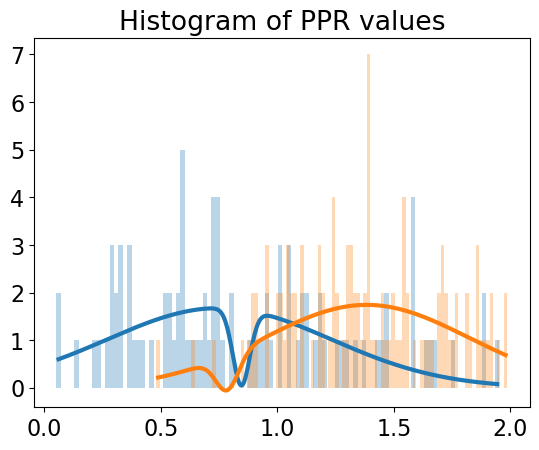

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


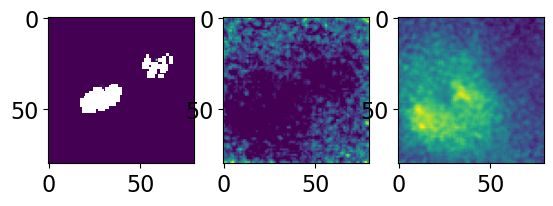

[11, 0]
        params  sigma
mu1       0.70    inf
sigma1    0.02    inf
A1       25.00    inf
mu2       0.80    inf
sigma2    0.02    inf
A2       15.00    inf


c:\Users\jjudge3\AppData\Local\anaconda3\envs\TSM-to-ZDA\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


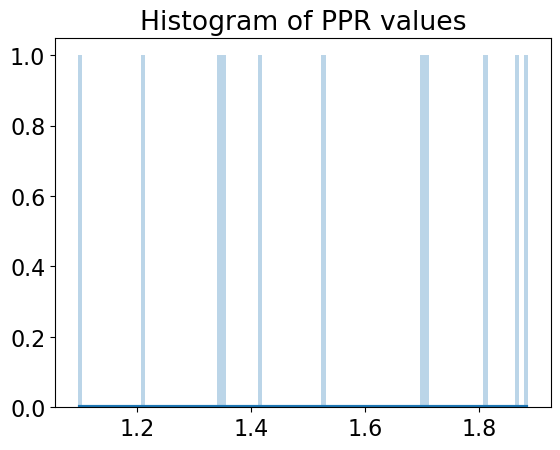

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


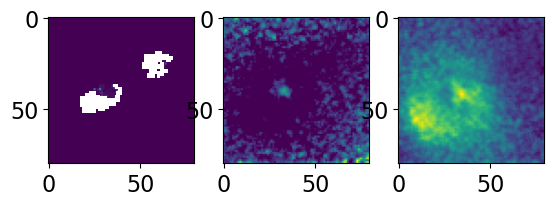

[0, 0]


<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


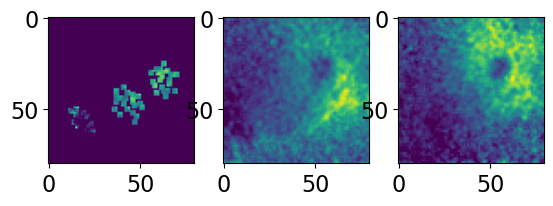

[163, 175, 82]
          params     sigma
mu1     0.610044  0.024687
sigma1  0.054519  0.027739
A1      1.475282  0.659684
mu2     0.853682  0.029535
sigma2  0.134406  0.031463
A2      2.720002  0.314288
          params     sigma
mu1     0.724930  0.010704
sigma1 -0.025912  0.012283
A1      1.920084  0.728650
mu2     0.639860  0.025601
sigma2  0.184083  0.026915
A2      2.747076  0.360877
          params         sigma
mu1     0.719289  1.956722e-02
sigma1  0.020420  1.958749e-02
A1      1.414688  1.172733e+00
mu2     0.800498  4.349777e+03
sigma2  0.002640  1.433909e+03
A2      1.548343  3.095054e+06


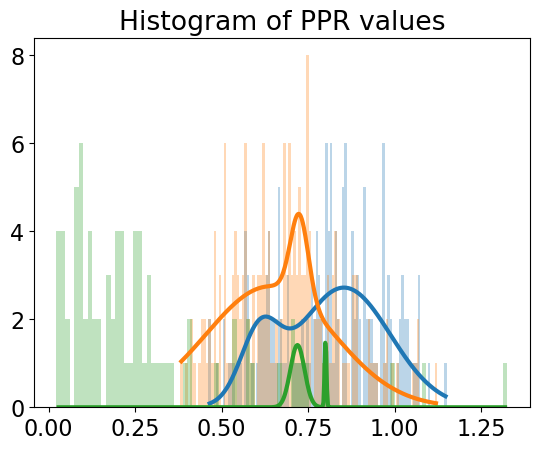

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1
<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


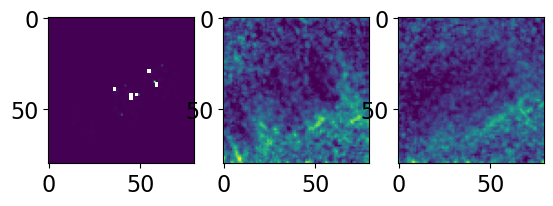

[138, 142, 117]
          params     sigma
mu1     0.686260  0.020528
sigma1  0.106305  0.024079
A1      2.699301  0.476847
mu2     0.653300  0.407067
sigma2  0.883944  0.461059
A2      1.242163  0.288191
           params          sigma
mu1      0.734553      15.922383
sigma1  -0.004618      59.502902
A1     -11.173723  499870.075445
mu2      0.879666       0.035521
sigma2   0.366542       0.037297
A2       2.635631       0.227371
          params     sigma
mu1     0.623766  0.054017
sigma1  0.309841  0.037575
A1      3.070773  0.316935
mu2     0.924997  0.040212
sigma2  0.097307  0.054276
A2     -1.242666  0.604806


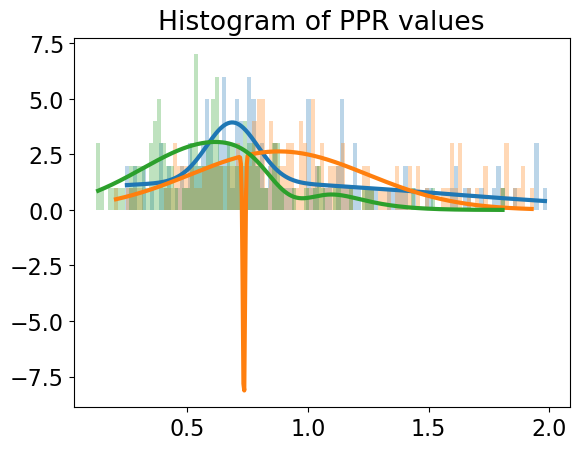

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1
<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


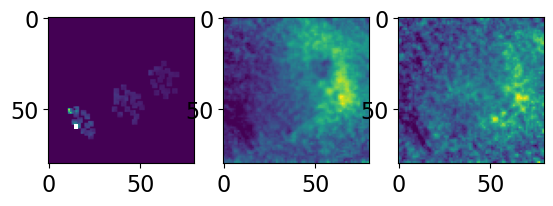

[163, 175, 95]
          params     sigma
mu1     0.476979  0.005234
sigma1  0.060013  0.005449
A1      7.796069  0.967411
mu2     0.497130  0.004018
sigma2  0.014451  0.005154
A2     -4.290807  1.247828
           params         sigma
mu1      0.660983      0.012891
sigma1   0.137691      0.013095
A1       3.661467      0.297250
mu2      0.998184      1.727238
sigma2   0.002019      1.226701
A2      24.643611  47177.797818
          params     sigma
mu1     1.198461  0.031923
sigma1  0.242463  0.033099
A1      1.984796  0.216561
mu2     0.805315  0.008972
sigma2 -0.017891  0.009422
A2      1.819802  0.804052


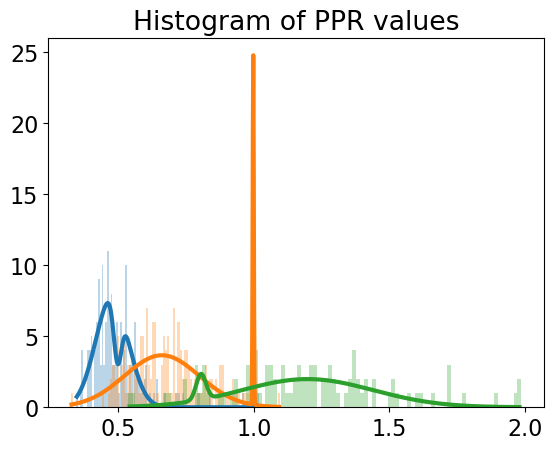

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1
<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


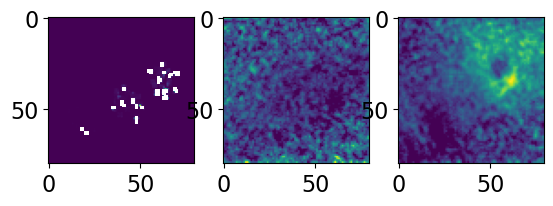

[1, 16, 55]
              params          sigma
mu1     7.000000e-01   70430.563866
sigma1  2.000000e-02   70704.715196
A1     -1.596411e-16       0.412110
mu2     8.000000e-01  224701.194014
sigma2  2.000000e-02  226665.084696
A2      6.248474e-17       0.412853


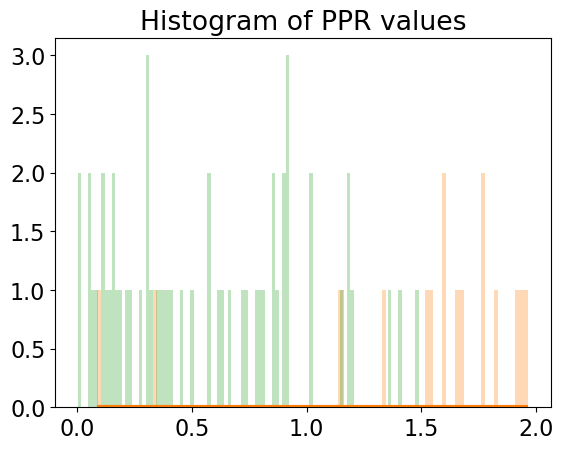

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1
<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


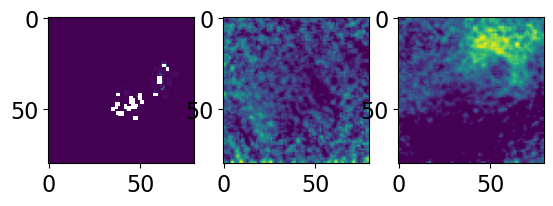

[37, 71, 50]
            params          sigma
mu1     148.990090  375420.633930
sigma1   51.368581   65237.413964
A1       43.768752  456536.246678
mu2       0.808880       0.014467
sigma2    0.011142       0.008780
A2        1.326566       0.936192


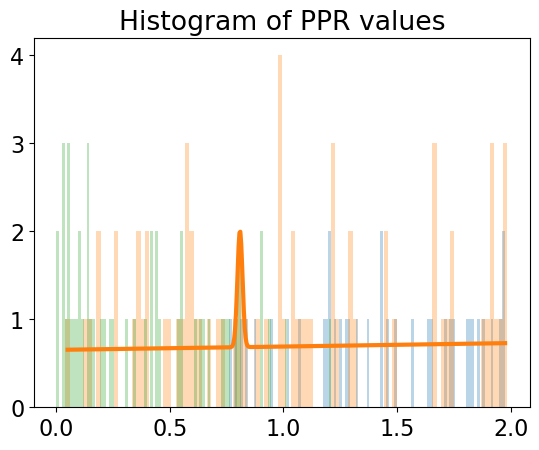

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1
<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


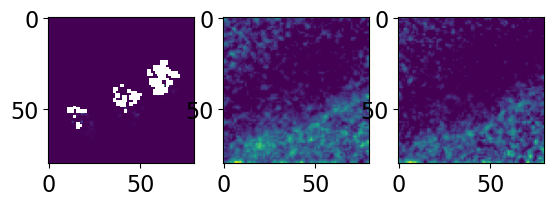

[25, 55, 72]
          params     sigma
mu1     0.705853  0.033346
sigma1 -0.064214  0.041804
A1     -0.498686  0.258209
mu2     0.622311  0.087655
sigma2  0.348832  0.109287
A2      0.513087  0.174851
          params          sigma
mu1     0.791360  107830.121456
sigma1 -0.001694            NaN
A1     -1.702650            NaN
mu2    -0.080037       0.707206
sigma2  0.806066       0.394310
A2      1.155704       0.376852
          params     sigma
mu1     0.180646  0.294140
sigma1  0.628366  0.215568
A1      1.362722  0.187278
mu2     0.795481  0.014803
sigma2 -0.008532  0.006751
A2      2.160094  0.913936


<ipython-input-84-e21b85474538>:129: RuntimeWarning: invalid value encountered in sqrt
  sigma=np.sqrt(np.diag(cov))


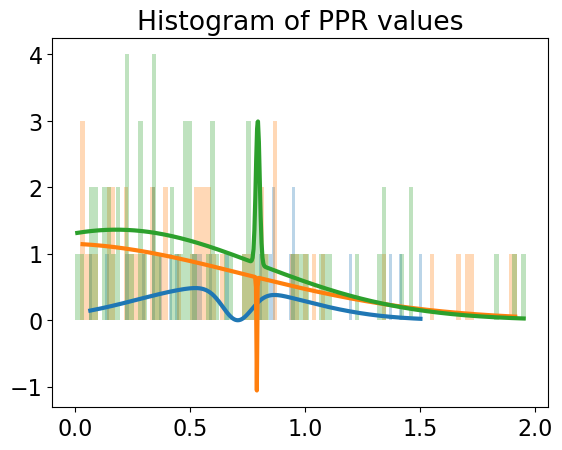

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1
<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


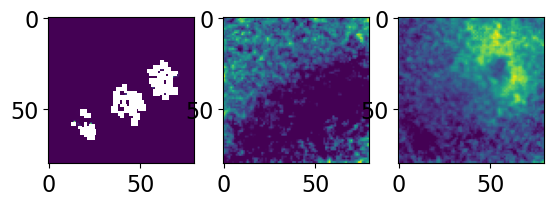

[0, 0, 28]
          params          sigma
mu1     0.712227   63763.394519
sigma1 -0.000741  932357.329001
A1     -0.315803            NaN
mu2     1.080994       0.504319
sigma2  0.788044       0.771371
A2      0.326080       0.074150


<ipython-input-84-e21b85474538>:129: RuntimeWarning: invalid value encountered in sqrt
  sigma=np.sqrt(np.diag(cov))


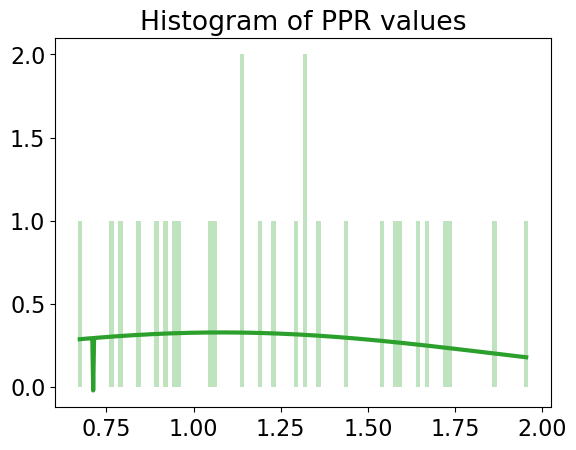

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


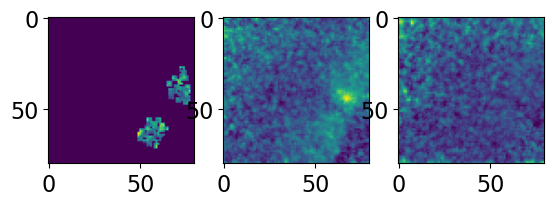

[151, 159]
           params         sigma
mu1      0.389486  1.686494e-02
sigma1   0.154033  1.905110e-02
A1       2.577002  2.217411e-01
mu2      0.785808  5.119263e+04
sigma2   0.001098           NaN
A2      70.448057  3.464159e+09
          params     sigma
mu1     0.338594  0.006080
sigma1 -0.024716  0.006873
A1      3.129403  0.699510
mu2     0.462843  0.020211
sigma2 -0.159777  0.016605
A2      2.940442  0.294329


<ipython-input-84-e21b85474538>:129: RuntimeWarning: invalid value encountered in sqrt
  sigma=np.sqrt(np.diag(cov))


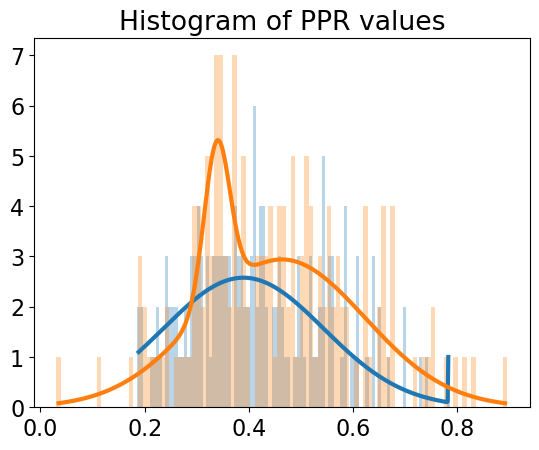

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1
<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


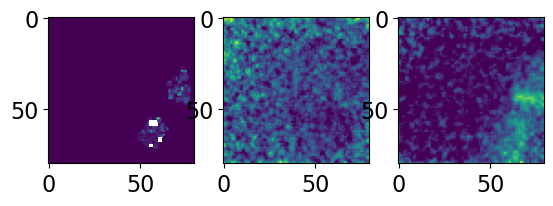

[16, 47]
              params         sigma
mu1     6.707908e-01  1.727585e+12
sigma1 -2.538799e-02  1.727593e+12
A1     -5.114021e-17  3.149073e-01
mu2     7.935381e-01  2.278221e+00
sigma2  3.781099e-03  5.720921e-01
A2      1.007629e+00  7.699750e+01


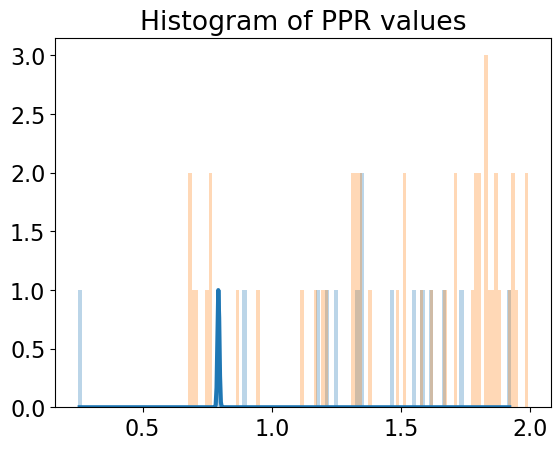

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1
<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


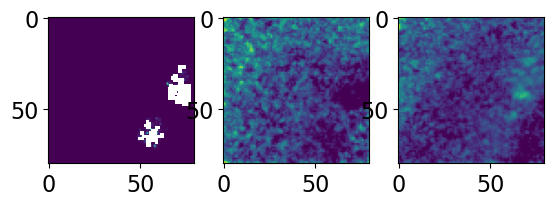

[2, 31]
          params         sigma
mu1     0.695124  5.561676e+04
sigma1  0.002038  1.243727e+04
A1      2.048526  1.048128e+08
mu2     1.197993  1.721082e-01
sigma2  0.536466  2.351016e-01
A2      0.401225  1.028434e-01


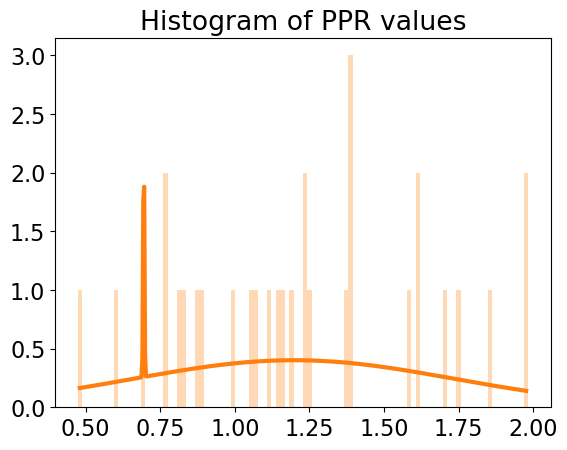

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1
<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


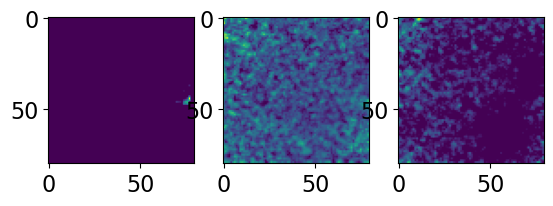

[19, 0]
              params        sigma
mu1     6.966854e-01  1029.602793
sigma1  1.825415e-02  1010.193668
A1     -2.123335e-07     0.299636
mu2     7.277869e-01   234.299274
sigma2 -5.455331e-03   230.629861
A2      9.251896e-07     0.743823


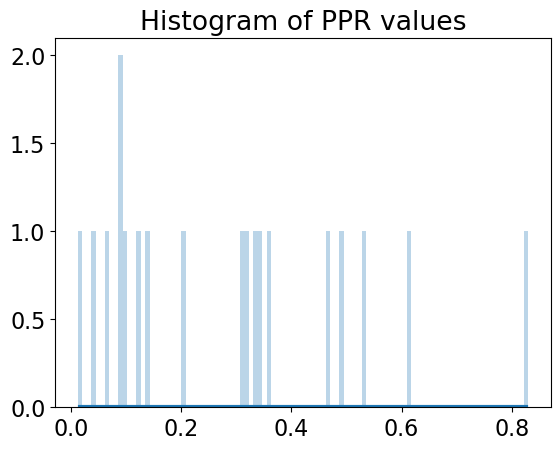

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


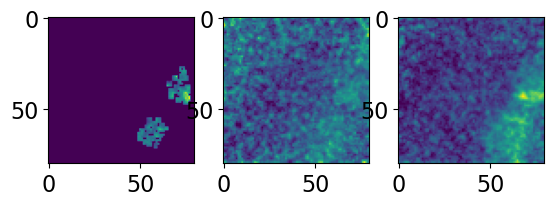

[100, 140]
              params         sigma
mu1     6.920328e-01  1.329441e+04
sigma1  7.884223e-03  1.851287e+04
A1      1.077400e-16  4.260905e+00
mu2     7.851278e-01  1.704252e+08
sigma2  3.810603e-04  4.566601e+08
A2      2.056143e-12  2.548812e+08
            params         sigma
mu1       0.733110           NaN
sigma1    0.002370  1.231979e+05
A1      345.688083  1.562232e+11
mu2       1.567371  4.687780e-02
sigma2    0.351103  5.345208e-02
A2        2.270187  2.185104e-01


<ipython-input-84-e21b85474538>:129: RuntimeWarning: invalid value encountered in sqrt
  sigma=np.sqrt(np.diag(cov))


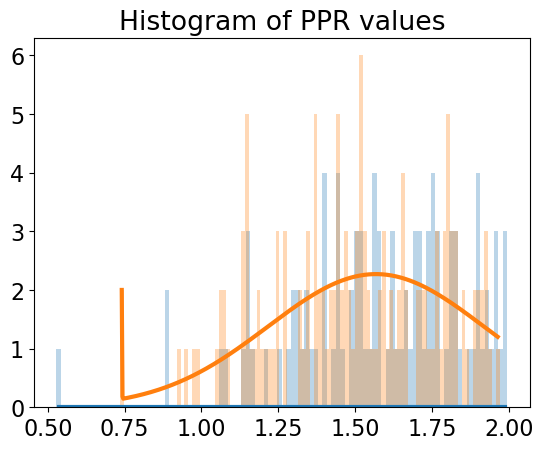

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1
<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


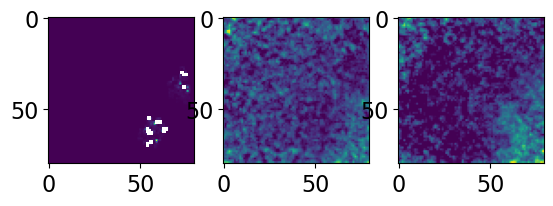

[106, 86]
          params          sigma
mu1     0.983962       0.084126
sigma1  0.574141       0.105438
A1      1.493292       0.183841
mu2     0.817005            NaN
sigma2  0.001780  819811.152705
A2      1.688842            NaN
           params         sigma
mu1      1.944938  2.868899e+00
sigma1   1.966344  3.379059e+00
A1       0.930991  2.343696e-01
mu2      0.798904  7.815929e+02
sigma2   0.004087  2.822433e+03
A2      17.267857  5.457128e+07


<ipython-input-84-e21b85474538>:129: RuntimeWarning: invalid value encountered in sqrt
  sigma=np.sqrt(np.diag(cov))


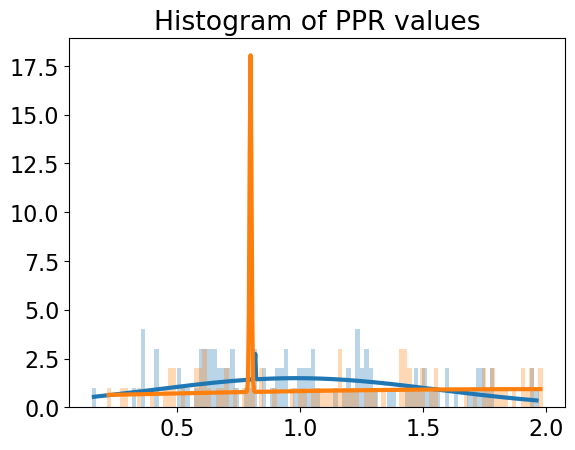

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1
<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


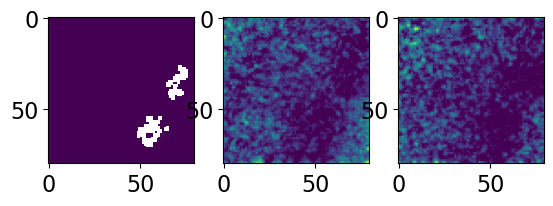

[33, 12]
          params          sigma
mu1     0.206518       0.206160
sigma1 -0.341033       0.164738
A1      0.921510       0.174721
mu2     0.793624  601675.287176
sigma2 -0.002101            NaN
A2      0.823419            NaN
              params          sigma
mu1     7.000000e-01   53277.559868
sigma1  2.000000e-02   53565.047829
A1      3.195360e-16       0.293508
mu2     8.000000e-01  114489.417144
sigma2  2.000000e-02  115107.296757
A2     -3.889576e-16       0.293508


<ipython-input-84-e21b85474538>:129: RuntimeWarning: invalid value encountered in sqrt
  sigma=np.sqrt(np.diag(cov))


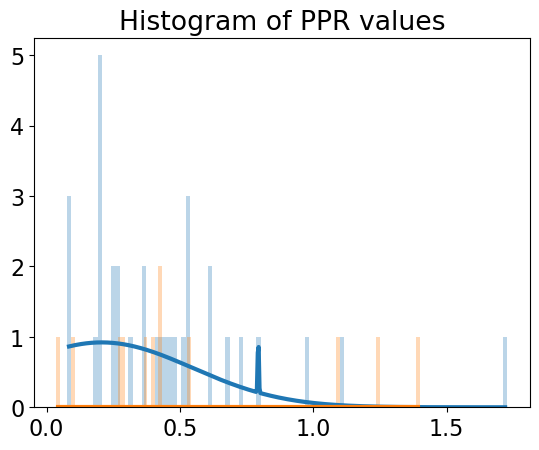

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1
<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


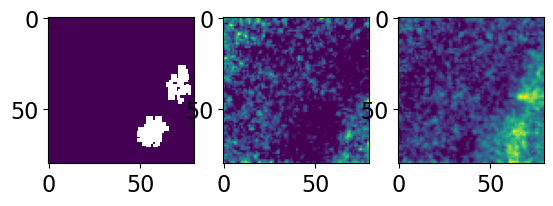

[0, 0]


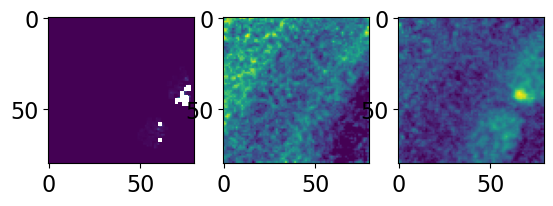

[10, 6]


<ipython-input-84-e21b85474538>:18: RuntimeWarning: overflow encountered in square
  return A*np.exp(-(x-mu)**2/2/sigma**2)
<ipython-input-84-e21b85474538>:18: RuntimeWarning: overflow encountered in double_scalars
  return A*np.exp(-(x-mu)**2/2/sigma**2)
<ipython-input-84-e21b85474538>:18: RuntimeWarning: invalid value encountered in true_divide
  return A*np.exp(-(x-mu)**2/2/sigma**2)


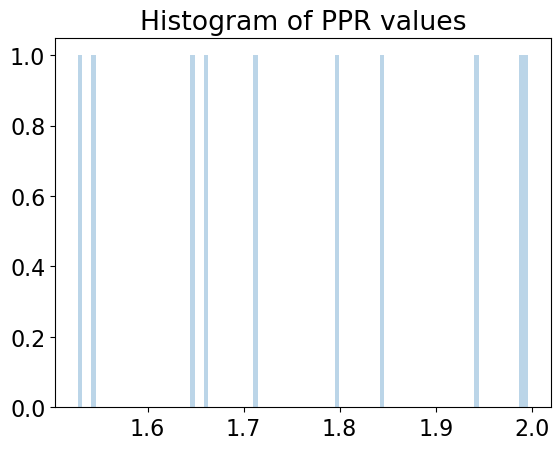

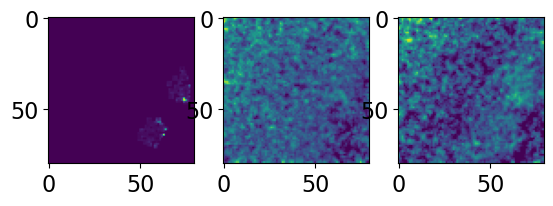

[113, 124]
          params     sigma
mu1     0.664650  0.062173
sigma1 -0.080455  0.084728
A1     -0.583898  0.496761
mu2     1.284037  0.080610
sigma2 -0.467571  0.114770
A2      1.716218  0.182008
          params     sigma
mu1     0.502767  0.012553
sigma1 -0.013084  0.012674
A1     -1.254205  1.043888
mu2     0.990654  0.054582
sigma2  0.405190  0.061858
A2      2.040123  0.195621


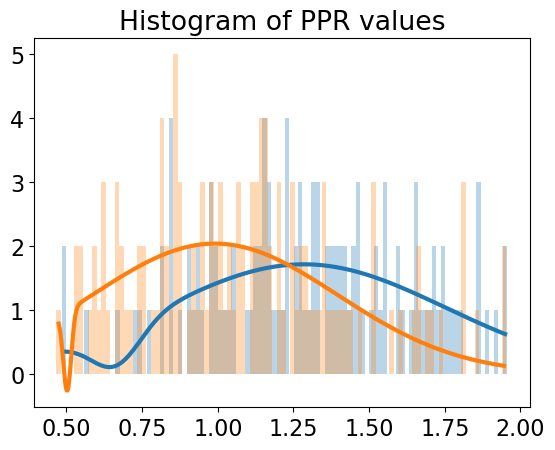

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


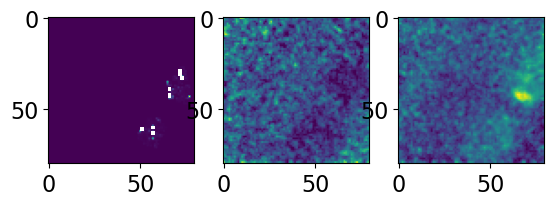

[2, 6]


<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


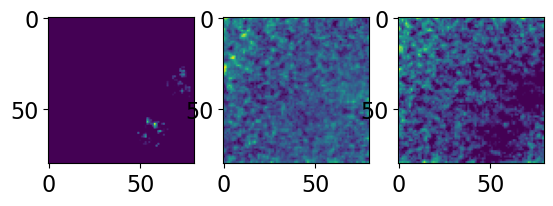

[54, 57]
        params  sigma
mu1       0.70    inf
sigma1    0.02    inf
A1       25.00    inf
mu2       0.80    inf
sigma2    0.02    inf
A2       15.00    inf


c:\Users\jjudge3\AppData\Local\anaconda3\envs\TSM-to-ZDA\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


          params         sigma
mu1     0.673905      0.073344
sigma1  0.022909      3.466044
A1      7.554932  67559.620592
mu2     0.673906      0.081547
sigma2 -0.023654      3.853341
A2     -6.923088  67559.992304


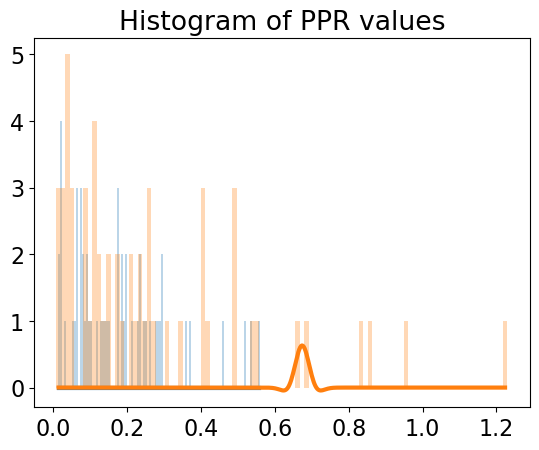

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1
<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


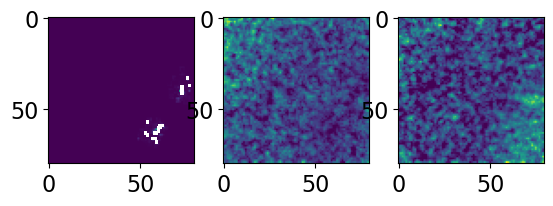

[83, 75]
          params          sigma
mu1     1.279136       0.173520
sigma1  0.742367       0.255925
A1      1.059852       0.166519
mu2     0.776210       2.002339
sigma2 -0.004586     238.482097
A2     -5.124731  940982.269435
          params     sigma
mu1     0.696213  0.029657
sigma1  0.026994  0.030456
A1     -0.798889  0.766910
mu2     1.732224  0.646519
sigma2 -1.002361  0.567813
A2      1.060507  0.173039


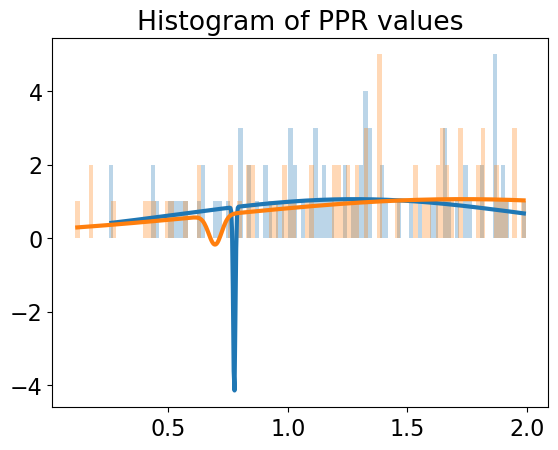

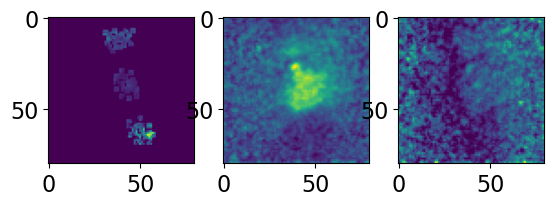

[154, 159, 140]
          params         sigma
mu1     0.362554      0.010263
sigma1  0.117670      0.010270
A1      3.918284      0.295993
mu2     0.773280      4.626953
sigma2  0.002531      6.423500
A2      5.996437  33693.410538
        params  sigma
mu1       0.70    inf
sigma1    0.02    inf
A1       25.00    inf
mu2       0.80    inf
sigma2    0.02    inf
A2       15.00    inf


c:\Users\jjudge3\AppData\Local\anaconda3\envs\TSM-to-ZDA\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
<ipython-input-84-e21b85474538>:129: RuntimeWarning: invalid value encountered in sqrt
  sigma=np.sqrt(np.diag(cov))


          params     sigma
mu1     0.438194  0.038922
sigma1  0.320232  0.043670
A1      3.282286  0.307557
mu2     0.857045       NaN
sigma2  0.002369       NaN
A2      1.643942       NaN


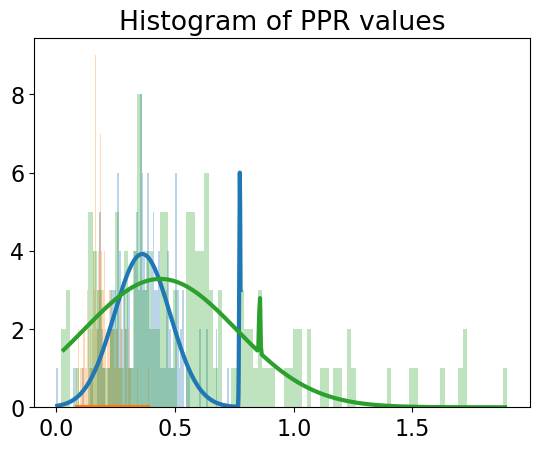

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


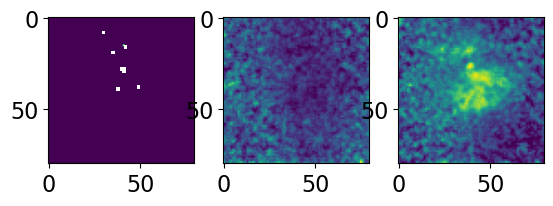

[20, 0, 138]
        params  sigma
mu1       0.70    inf
sigma1    0.02    inf
A1       25.00    inf
mu2       0.80    inf
sigma2    0.02    inf
A2       15.00    inf
          params     sigma
mu1     1.127572  0.133940
sigma1  0.784200  0.179403
A1      1.524569  0.206762
mu2     0.759178  0.028968
sigma2  0.094318  0.032824
A2      1.541643  0.430490


c:\Users\jjudge3\AppData\Local\anaconda3\envs\TSM-to-ZDA\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


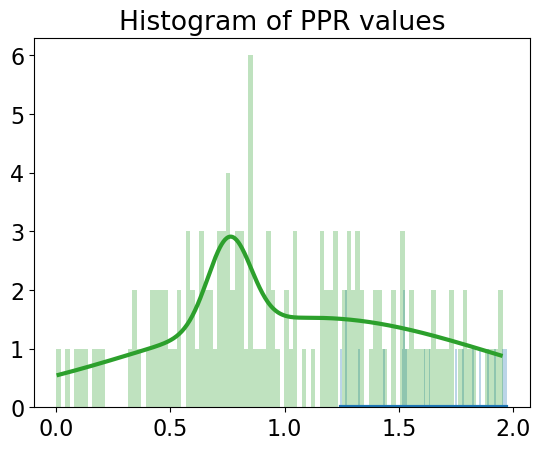

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1
<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


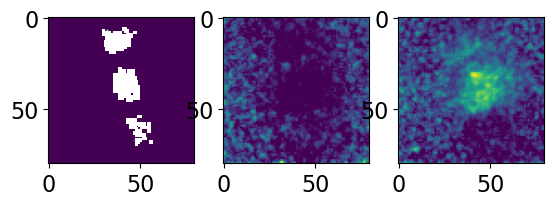

[5, 0, 47]


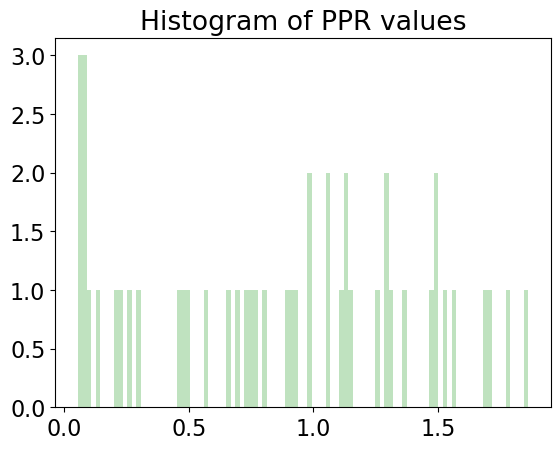

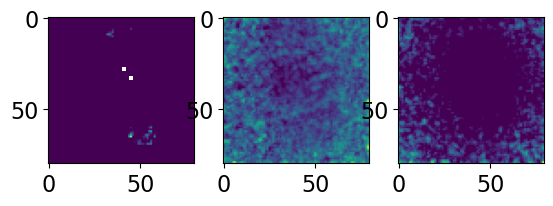

[12, 0, 47]
             params         sigma
mu1        0.623038  1.025762e+05
sigma1     0.002957  1.098248e+04
A1      1147.616036  8.852675e+10
mu2        0.800000  1.585880e+21
sigma2     0.020000  4.950833e+14
A2        15.000000  1.220151e+25
          params      sigma
mu1     0.696274   1.501908
sigma1  0.003532   0.380378
A1      1.000112   6.441273
mu2     0.800651   3.822248
sigma2  0.003219   0.870192
A2      2.000057  18.052918


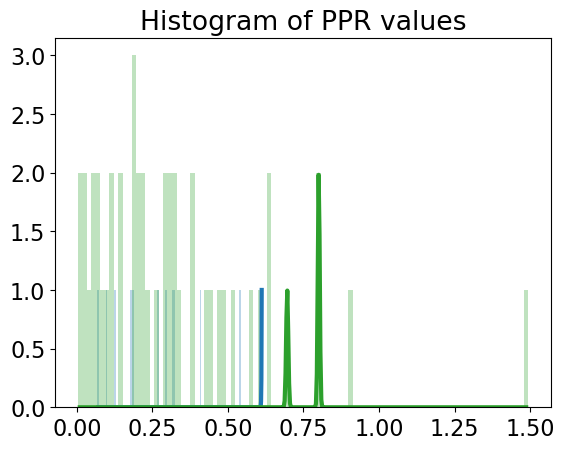

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1
<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


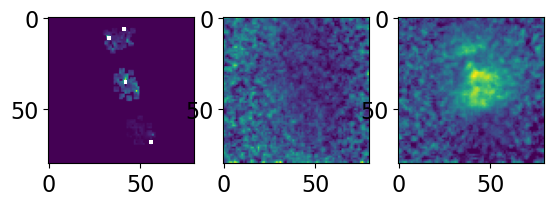

[17, 0, 126]
          params         sigma
mu1     0.536955  3.133855e+00
sigma1  0.004771  1.913206e+02
A1     -7.061526  1.006210e+06
mu2     1.065486  7.282935e-02
sigma2  0.555212  8.764652e-02
A2      1.848087  1.983200e-01


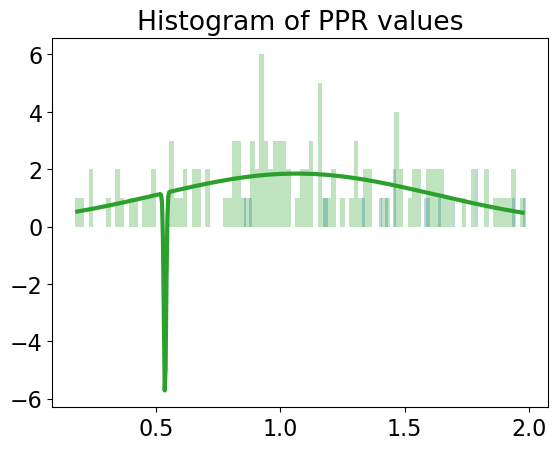

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1
<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


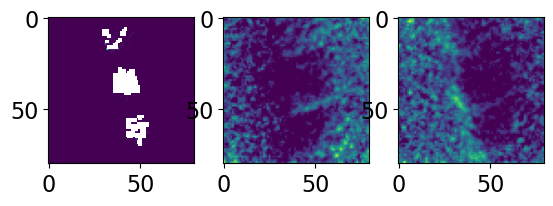

[82, 16, 41]
              params         sigma
mu1     7.115957e-01  1.109297e+11
sigma1 -4.278490e-03  6.489035e+10
A1     -6.124017e-12  1.864901e+02
mu2     7.999560e-01  2.412873e+12
sigma2  1.761619e-02  2.412653e+12
A2     -3.042658e-15  3.609013e-01
          params         sigma
mu1    -0.411816  1.254454e+00
sigma1  0.685291  5.037964e-01
A1      1.326748  1.407408e+00
mu2     0.793815  4.183308e+01
sigma2  0.003665  5.651024e+03
A2      7.176831  5.087791e+07


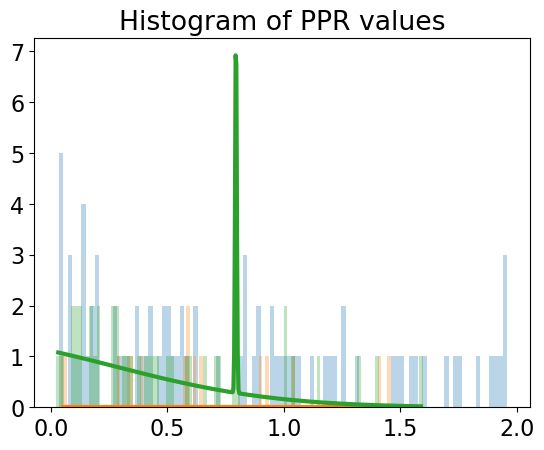

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1
<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


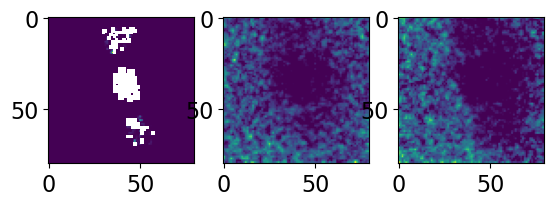

[42, 3, 63]
          params         sigma
mu1     0.709988  9.839740e+04
sigma1  0.002794  1.961323e+04
A1      3.726202  9.775075e+07
mu2     0.994244  2.271546e+00
sigma2 -0.003944  5.582551e-01
A2      5.084208  5.509819e+02


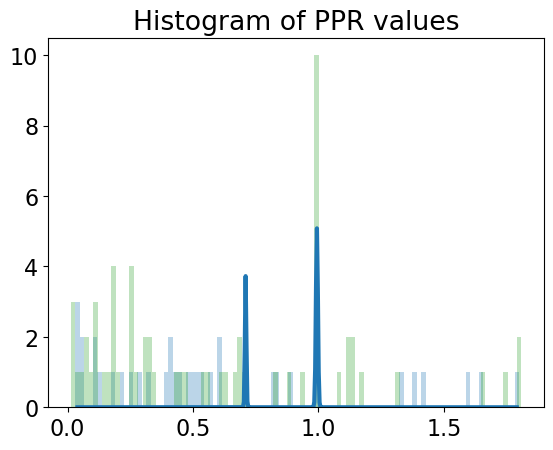

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1
<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


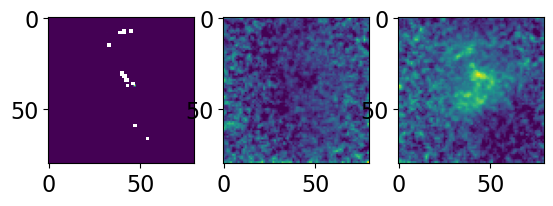

[42, 1, 112]
           params          sigma
mu1      0.739334    6587.586722
sigma1  -0.002231    1167.501446
A1       1.005810  324761.016027
mu2      0.658601            NaN
sigma2   0.006537            NaN
A2      19.949801            NaN
          params     sigma
mu1     0.692521  0.049608
sigma1  0.429079  0.054856
A1      2.129958  0.228042
mu2     0.831592  0.014968
sigma2 -0.024073  0.015726
A2     -1.540827  0.844861


<ipython-input-84-e21b85474538>:129: RuntimeWarning: invalid value encountered in sqrt
  sigma=np.sqrt(np.diag(cov))


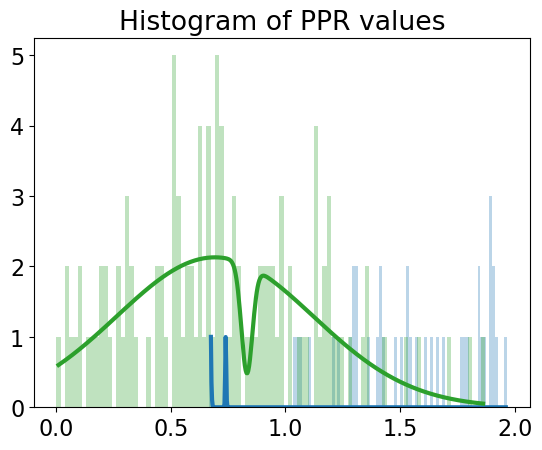

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1
<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


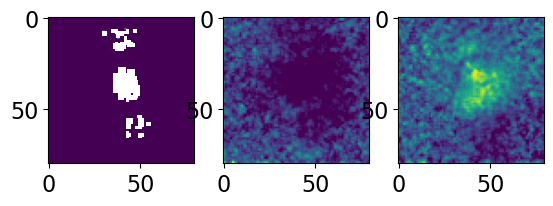

[10, 0, 63]
        params  sigma
mu1       0.70    inf
sigma1    0.02    inf
A1       25.00    inf
mu2       0.80    inf
sigma2    0.02    inf
A2       15.00    inf
          params     sigma
mu1     0.667460  0.009410
sigma1  0.030517  0.009641
A1      2.655106  0.687369
mu2     0.825489  0.030467
sigma2  0.046372  0.032046
A2      1.000444  0.563737


c:\Users\jjudge3\AppData\Local\anaconda3\envs\TSM-to-ZDA\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


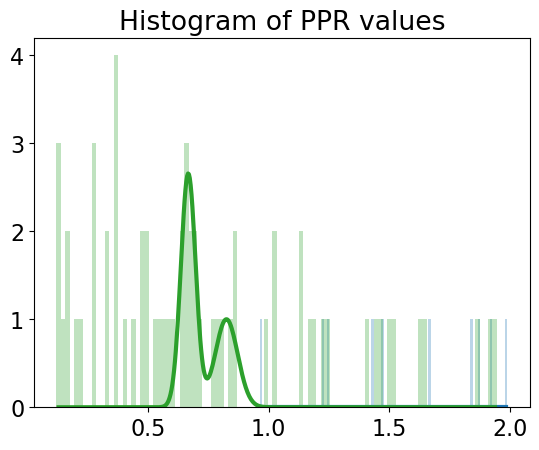

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1
<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


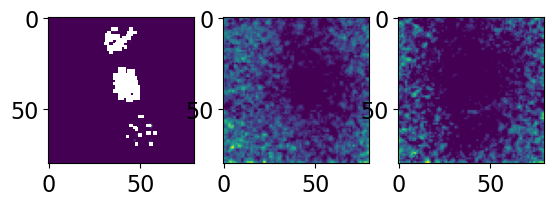

[13, 0, 38]
              params         sigma
mu1     6.470155e-01  3.622016e+09
sigma1 -3.689977e-03  1.708893e+09
A1     -2.713360e-11  8.662385e+02
mu2     7.335242e-01  8.858206e+05
sigma2  1.266151e-03           NaN
A2      1.001044e+00  1.898164e+07


<ipython-input-84-e21b85474538>:129: RuntimeWarning: invalid value encountered in sqrt
  sigma=np.sqrt(np.diag(cov))


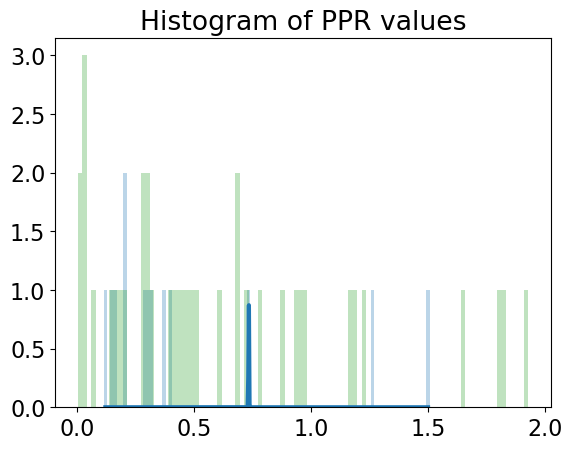

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1
<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


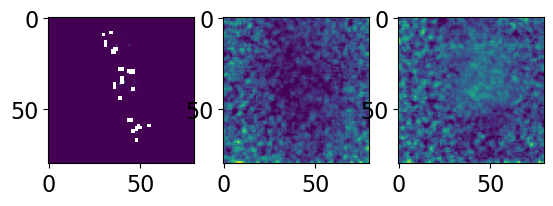

[63, 11, 105]
          params         sigma
mu1     0.702254  6.896116e+05
sigma1  0.001906  5.843801e+05
A1      1.653982  2.185487e+08
mu2     0.952941  6.787303e-01
sigma2  0.999951  1.020762e+00
A2      0.694488  1.333060e-01


<ipython-input-84-e21b85474538>:18: RuntimeWarning: overflow encountered in square
  return A*np.exp(-(x-mu)**2/2/sigma**2)
<ipython-input-84-e21b85474538>:18: RuntimeWarning: overflow encountered in double_scalars
  return A*np.exp(-(x-mu)**2/2/sigma**2)
<ipython-input-84-e21b85474538>:18: RuntimeWarning: invalid value encountered in true_divide
  return A*np.exp(-(x-mu)**2/2/sigma**2)
c:\Users\jjudge3\AppData\Local\anaconda3\envs\TSM-to-ZDA\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


          params  sigma
mu1     0.774666    inf
sigma1  0.000720    inf
A1     -4.371863    inf
mu2     0.609881    inf
sigma2  0.579120    inf
A2      1.498585    inf


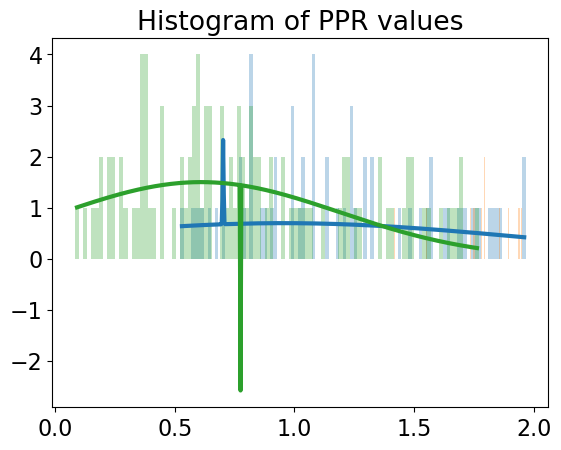

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


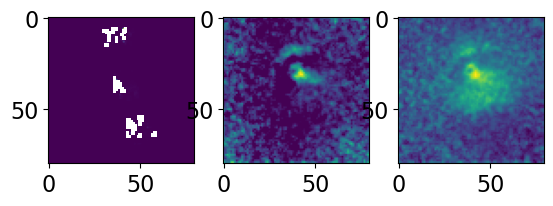

[4, 9, 33]
           params         sigma
mu1      0.686017  2.278703e+05
sigma1   0.005707  3.213311e+04
A1      25.091230  1.461962e+09
mu2      0.789740  1.460938e+01
sigma2   0.002662  3.270436e+00
A2       1.004518  5.411611e+02


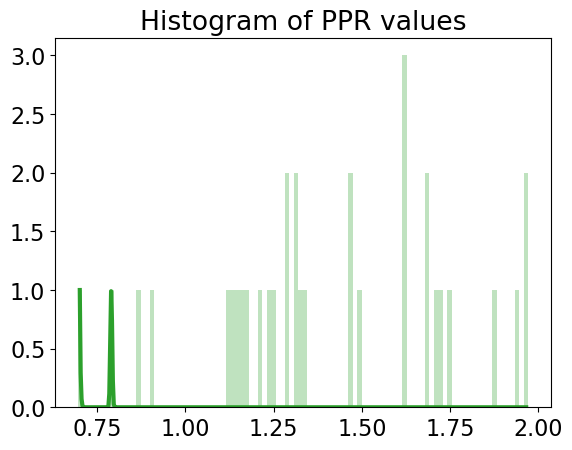

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


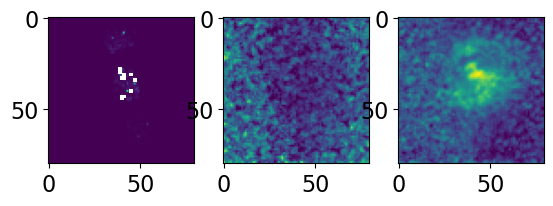

[21, 0, 103]
          params     sigma
mu1     0.700385  0.034593
sigma1  0.008018  0.015492
A1      1.077216  1.079534
mu2     1.497530  0.400186
sigma2  1.028697  0.466871
A2      1.249889  0.147962


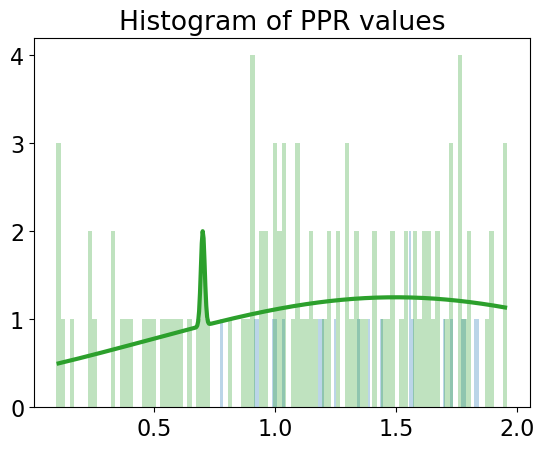

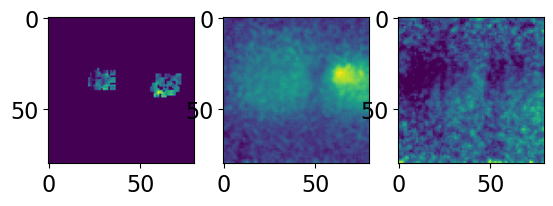

[148, 131]
        params  sigma
mu1       0.70    inf
sigma1    0.02    inf
A1       25.00    inf
mu2       0.80    inf
sigma2    0.02    inf
A2       15.00    inf
        params  sigma
mu1       0.70    inf
sigma1    0.02    inf
A1       25.00    inf
mu2       0.80    inf
sigma2    0.02    inf
A2       15.00    inf


c:\Users\jjudge3\AppData\Local\anaconda3\envs\TSM-to-ZDA\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',
c:\Users\jjudge3\AppData\Local\anaconda3\envs\TSM-to-ZDA\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


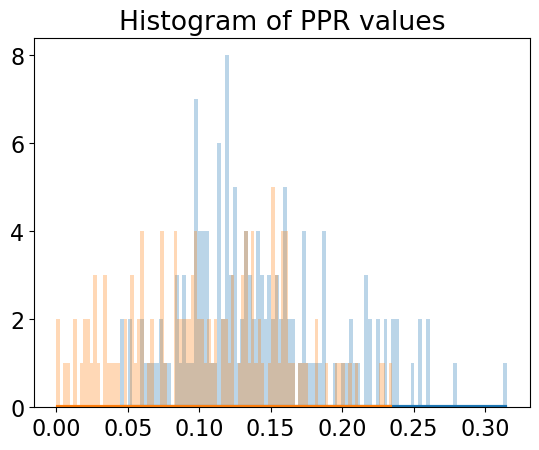

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


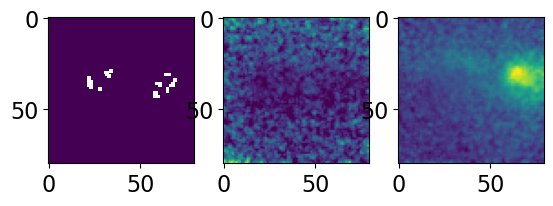

[0, 0]


<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


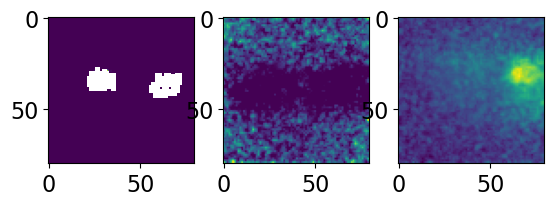

[0, 0]


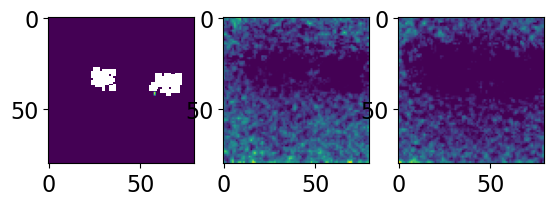

[2, 0]


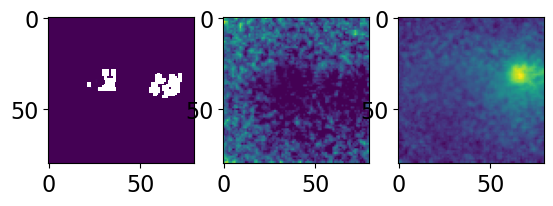

[0, 0]


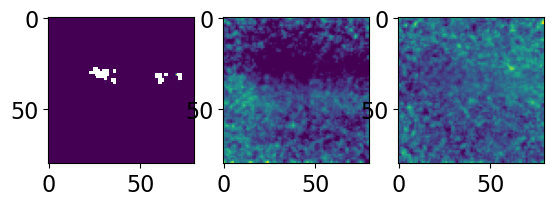

[38, 62]


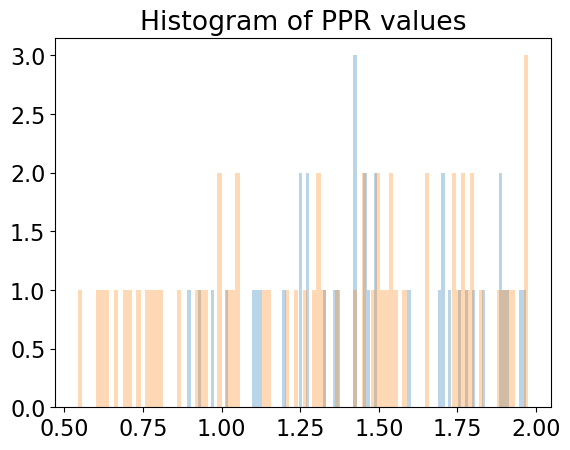

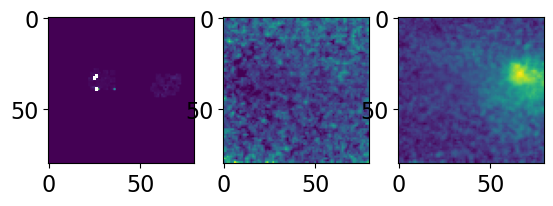

[0, 1]


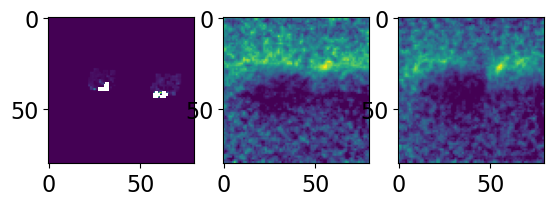

[104, 104]
          params          sigma
mu1     0.754664      84.604078
sigma1  0.003734      22.643089
A1      1.069038    9846.332876
mu2     0.806074    1766.318682
sigma2 -0.003098     329.395242
A2      2.009526  113465.711018
          params  sigma
mu1     0.699562    inf
sigma1  0.298482    inf
A1      2.517507    inf
mu2     0.818804    inf
sigma2  0.000044    inf
A2     -1.993096    inf


c:\Users\jjudge3\AppData\Local\anaconda3\envs\TSM-to-ZDA\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


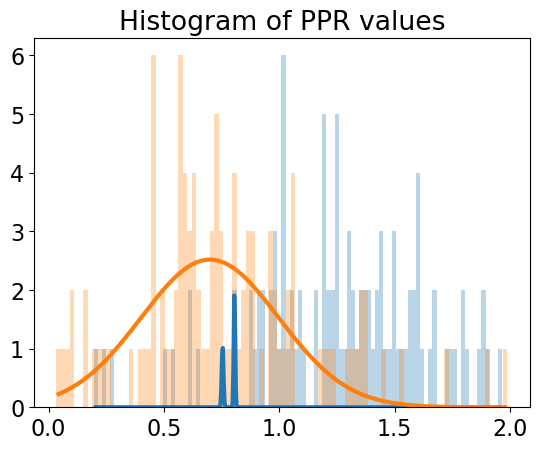

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1
<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


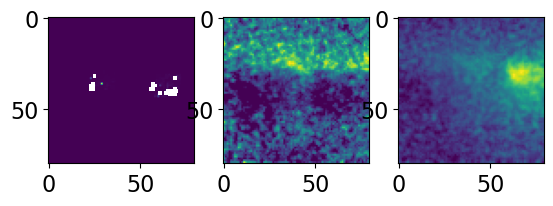

[0, 4]


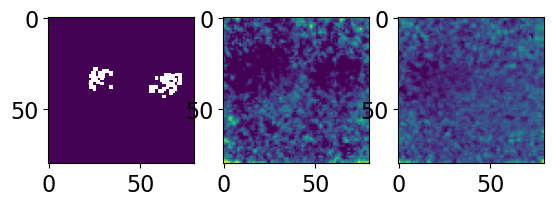

[19, 58]
              params         sigma
mu1     6.024126e+03  2.797742e+13
sigma1 -7.010514e+02  3.256447e+12
A1     -1.444561e+07  4.620499e+14
mu2     7.928958e-01           NaN
sigma2  4.184427e-03           NaN
A2      5.439650e+00           NaN
          params         sigma
mu1     1.451478  2.522549e-01
sigma1  0.765477  3.473087e-01
A1      0.675828  1.093991e-01
mu2     0.792558  8.095541e+01
sigma2  0.003947  1.062906e+02
A2      9.931447  1.058413e+06


<ipython-input-84-e21b85474538>:129: RuntimeWarning: invalid value encountered in sqrt
  sigma=np.sqrt(np.diag(cov))


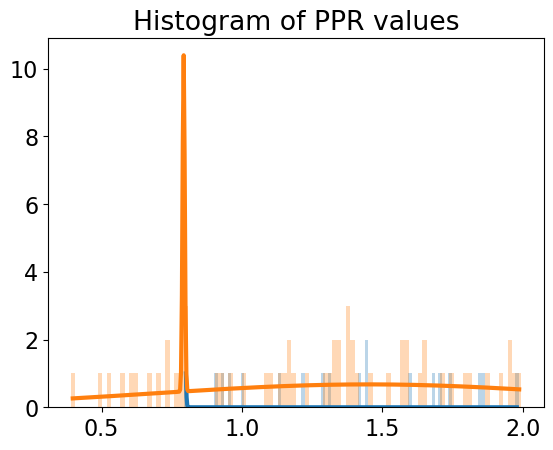

<ipython-input-84-e21b85474538>:59: RuntimeWarning: divide by zero encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1
<ipython-input-84-e21b85474538>:59: RuntimeWarning: invalid value encountered in true_divide
  ppr_map_tmp = amp_arr2 / amp_arr1


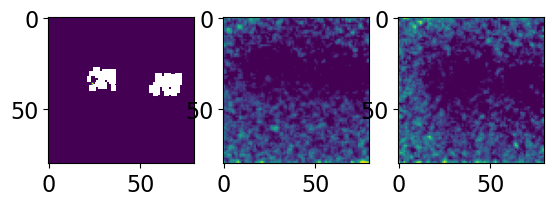

[5, 7]


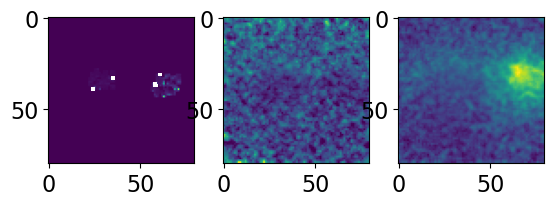

[0, 1]


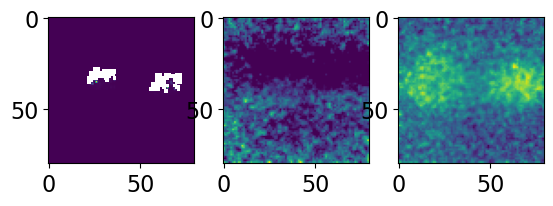

[0, 0]


In [84]:
# use amp arrays of both pulses to create PPR maps of different IPIs of the recordings 
def read_dat_arr_file(filename):
    data_arr = pd.read_csv(filename,
                                 sep='\t',
                                 header=None,
                                 names=['Index',  'Value'])
    data_arr = np.array(data_arr['Value']).reshape((80, 80))
    return data_arr

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from scipy.optimize import curve_fit

#x, y inputs can be lists or 1D numpy arrays

def gauss(x, mu, sigma, A):
    return A*np.exp(-(x-mu)**2/2/sigma**2)

def bimodal(x, mu1, sigma1, A1, mu2, sigma2, A2):
    return gauss(x,mu1,sigma1,A1)+gauss(x,mu2,sigma2,A2)

area_by_ipi = {'ipi': [], 'area': []}
ppr_hist = []
pphw_hist = []
ppl_hist = []
amp_cutoff = 0
# load in amp array files into dataframe for each IPI
for subdir in data_map:
    
    # extract date from subdir so we can look up metadata from master_df
    date = subdir.split("/")[-1].split('-')
    date = [int(x) for x in date]
    date[-1] += 2000
    date = "/".join([str(x) for x in date])
    metadata_date = master_df[master_df['Date'] == date]
    
    for slic_id in data_map[subdir]:
        for loc_id in data_map[subdir][slic_id]:
            if type(loc_id) == str:
                continue
            slic_loc_id = str(slic_id) + "_" + str(loc_id)
            metadata = metadata_date[metadata_date['Slice_Loc'] == slic_loc_id]
            medial_dir = metadata['Medial Dir'].item()
            stim_layer = metadata['Stim Layer'].item()
            caudal_rostral = metadata['Caudal/Rostral'].item()
            home_barrel = int(metadata['Home Barrel'].item())

            for ipi in data_map[subdir][slic_id][loc_id]:

                if type(ipi) == str:
                    continue
                
                # load amp files as numpy arrays using np.loadtxt
                amp_arr1 = get_amp_array_filename(subdir, slic_loc_id, ipi, 1)
                amp_arr2 = get_amp_array_filename(subdir, slic_loc_id, ipi, 2)
                amp_arr1 = read_dat_arr_file(amp_arr1)
                amp_arr2 = read_dat_arr_file(amp_arr2)
                ppr_map_tmp = amp_arr2 / amp_arr1

                area1 = np.sum(amp_arr1 > amp_cutoff)
                area2 = np.sum(amp_arr2 > amp_cutoff)
                if area1 > 0:
                    area_ratio = area2 / area1
                    area_by_ipi['area'].append(area_ratio)
                    area_by_ipi['ipi'].append(ipi)

                ppr_map_tmp[amp_arr1 < amp_cutoff] = 0

                # load barrel ROIs from .dat file
                roi_file = data_map[subdir][slic_id]['roi_file']
                barrel_rois = ROIFileReader(roi_file).get_roi_list()

                # convert from diode to pixel
                barrel_rois = [LaminarROI(roi, input_diode_numbers=True).get_points()
                            for roi in barrel_rois]
                ppr_hist = [[] for _ in range(len(barrel_rois))]

                # transfer PPR values to ppr_map if they are in the ROIs
                ppr_map = np.zeros((80, 80))
                for i in range(80):
                    for j in range(80):
                        for k, roi in enumerate(barrel_rois):
                            for px in roi:
                                if i == px[1] and j == px[0]:
                                    ppr_map[i, j] = ppr_map_tmp[i, j]
                                    break


                if True: #np.sum(ppr_map) > 0:
                    fig, axes = plt.subplots(1, 3)
                    axes[0].imshow(ppr_map, cmap='viridis')
                    axes[1].imshow(amp_arr1, cmap='viridis')
                    axes[2].imshow(amp_arr2, cmap='viridis')
                    plt.show()
                    #print(np.max(ppr_map), np.min(ppr_map))'''
                


                # build histogram of PPR values for pixels above cutoff
                for i in range(amp_arr1.shape[0]):
                    for j in range(amp_arr1.shape[1]):
                        if amp_arr1[i, j] > amp_cutoff and 0 < ppr_map[i, j] < 2: # and amp_arr2[i, j] != amp_arr1[i, j]:
                            
                            # find which barrel ROI this pixel is in
                            for k, roi in enumerate(barrel_rois):
                                for px in roi:
                                    if i == px[1] and j == px[0]:
                                        ppr_hist[k].append(ppr_map[i, j])
                                        break
                print([len(x) for x in ppr_hist])
                colors = ['tab:blue', 'tab:orange', 'tab:green', 'tab:red', 'tab:purple', 'tab:brown', 'tab:pink', 'tab:gray', 'tab:olive', 'tab:cyan']
                for i_h, ppr_h in enumerate(ppr_hist):
                    if len(ppr_h) < 10:
                        continue

                    # plot histogram of PPR values
                    y,x,_=plt.hist(ppr_h, bins=100, color=colors[i_h], alpha=0.3)
                    plt.title("Histogram of PPR values")


                    x=(x[1:]+x[:-1])/2 # for len(x)==len(y)

                    expected = (0.7, .02, 25, 0.8, .02, 15)
                    try:
                        params, cov = curve_fit(bimodal, x, y, expected)
                    except:
                        continue
                    sigma=np.sqrt(np.diag(cov))
                    x_fit = np.linspace(x.min(), x.max(), 500)
                    #plot combined...
                    plt.plot(x_fit, bimodal(x_fit, *params), color=colors[i_h], lw=3)
                    #...and individual Gauss curves
                    '''plt.plot(x_fit, gauss(x_fit, *params[:3]), 
                            color='tab:orange', lw=3, ls="--", label='mean PPR: 0.74 ± 0.01' )
                    plt.plot(x_fit, gauss(x_fit, *params[3:]), 
                            color='tab:green', lw=3, ls=":", label='mean PPR: 0.82 ± 0.07')'''
                    #and the original data points if no histogram has been created before
                    #plt.scatter(x, y, marker="X", color="black", label="original data")
                    #plt.legend(loc = 'upper left')
                    #plt.ylim(0, 17)
                    #plt.xlim(0.2, 1.2)
                    print(pd.DataFrame(data={'params': params, 'sigma': sigma}, index=bimodal.__code__.co_varnames[1:]))
                plt.show() 

